In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import norm
import numpy as np
df = pd.read_csv('data.xlsx - Sheet1.csv')

In [2]:
print("Head of the Data:")
print(df.head())
print("\nShape of the Data:")
print(df.shape)
print("\nDescription of the Data:")
print(df.describe())

Head of the Data:
  Unnamed: 0      ID     Salary          DOJ          DOL  \
0      train  203097   420000.0  6/1/12 0:00      present   
1      train  579905   500000.0  9/1/13 0:00      present   
2      train  810601   325000.0  6/1/14 0:00      present   
3      train  267447  1100000.0  7/1/11 0:00      present   
4      train  343523   200000.0  3/1/14 0:00  3/1/15 0:00   

                Designation    JobCity Gender           DOB  10percentage  \
0   senior quality engineer  Bangalore      f  2/19/90 0:00          84.3   
1         assistant manager     Indore      m  10/4/89 0:00          85.4   
2          systems engineer    Chennai      f   8/3/92 0:00          85.0   
3  senior software engineer    Gurgaon      m  12/5/89 0:00          85.6   
4                       get    Manesar      m  2/27/91 0:00          78.0   

   ... ComputerScience  MechanicalEngg  ElectricalEngg TelecomEngg  CivilEngg  \
0  ...              -1              -1              -1          -1     

In [3]:
df['DOJ'] = pd.to_datetime(df['DOJ'], errors='coerce')
df['DOL'] = pd.to_datetime(df['DOL'], errors='coerce')

# Drop rows where 'DOJ' is after 'DOL'
df = df[df['DOJ'] <= df['DOL']]

# Drop the 'Unnamed' column if it exists
if 'Unnamed: 0' in df.columns:
    df = df.drop(columns=['Unnamed: 0'])

# Replacing 0 with a meaningful value with 'Unknown'
df['12board'] = df['12board'].replace('0', 'Unknown')
df['10board'] = df['10board'].replace('0', 'Unknown')
df['JobCity'] = df['JobCity'].replace('-1', 'Unknown')

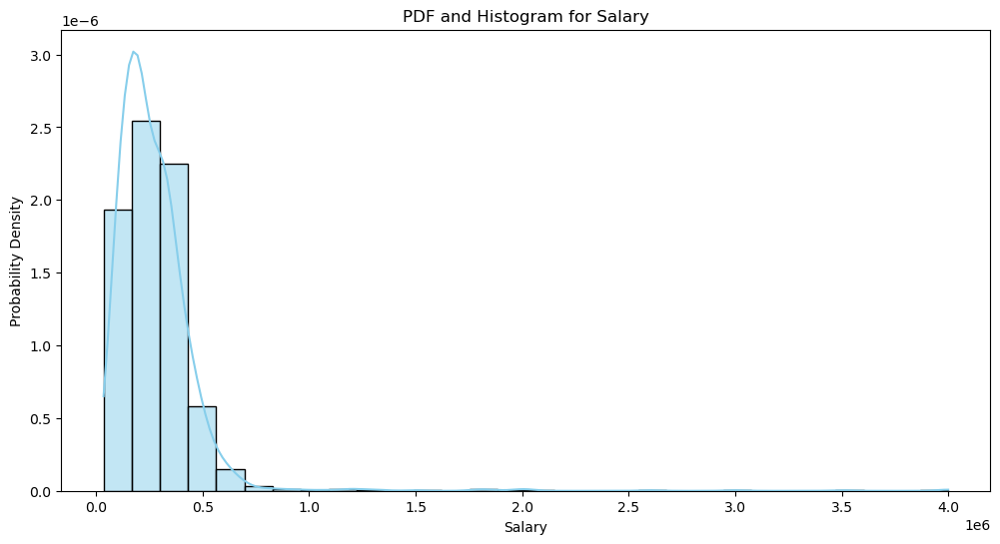

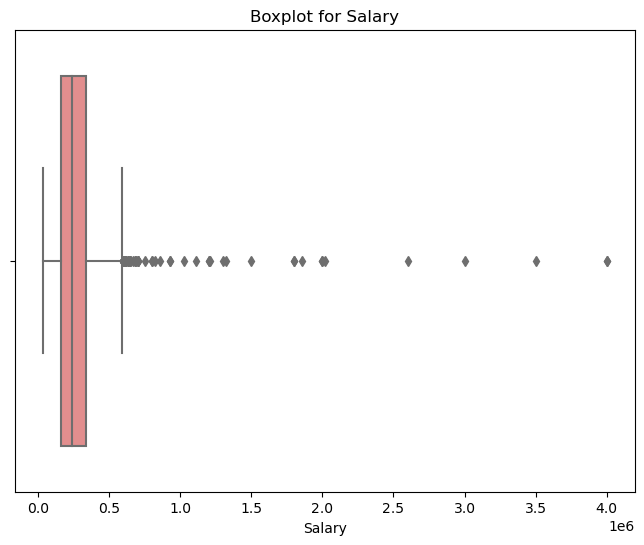

Outliers in Salary:
         Salary               Designation      JobCity Gender  10percentage  \
10     600000.0      senior php developer    Bangalore      m          88.6   
64     600000.0    java software engineer      Gurgaon      m          78.0   
123   1200000.0          engineer trainee  Maharajganj      m          59.8   
166   1860000.0            field engineer       mumbai      f          89.7   
370    690000.0                it analyst         Pune      m          90.6   
...         ...                       ...          ...    ...           ...   
3692   650000.0     application developer    Bangalore      m          70.5   
3946   650000.0  senior software engineer    Bangalore      m          73.0   
3961   700000.0         planning engineer      Rajpura      m          84.2   
3991   630000.0           systems analyst    Bangalore      m          80.0   
3992   800000.0                   manager       Rajkot      m          73.0   

              10board  12gradua

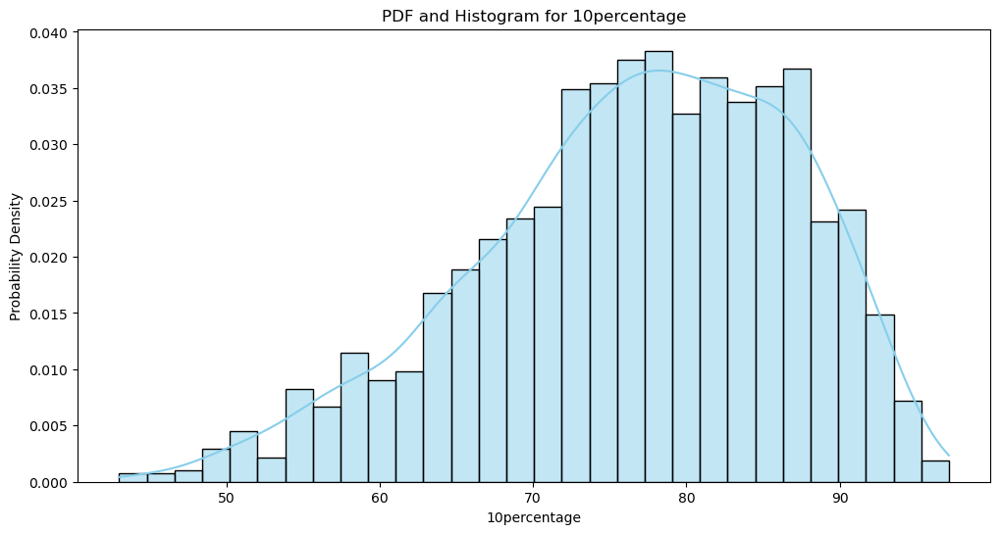

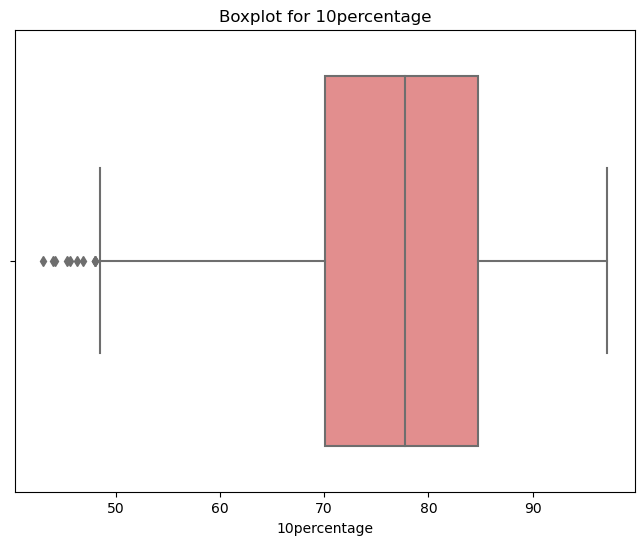

Outliers in 10percentage:
        Salary                  Designation            JobCity Gender  \
466   215000.0           software developer          New Delhi      m   
490   150000.0              design engineer               Pune      m   
491   100000.0           software developer       Bhubaneshwar      m   
502   240000.0    electrical field engineer          New Delhi      m   
1193  180000.0             network engineer              Noida      m   
1334  110000.0          electrical engineer                ncr      m   
1955  145000.0               .net developer            Unknown      m   
1976  105000.0           software developer          Bangalore      m   
2037  120000.0  technical support executive  A-64,sec-64,noida      m   
2885  240000.0          project coordinator             Jaipur      m   

      10percentage                               10board  12graduation  \
466          44.16                           state board          2009   
490          44.00  ce

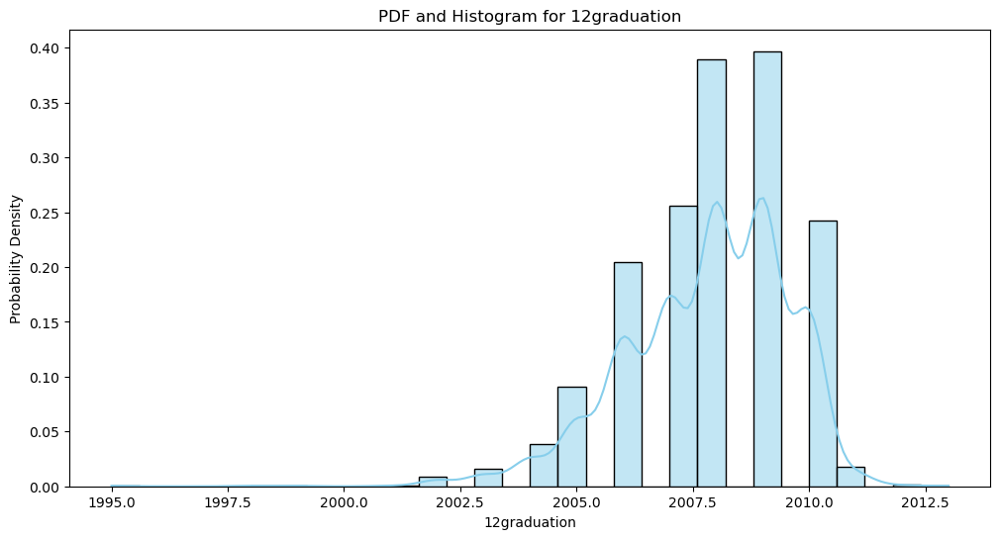

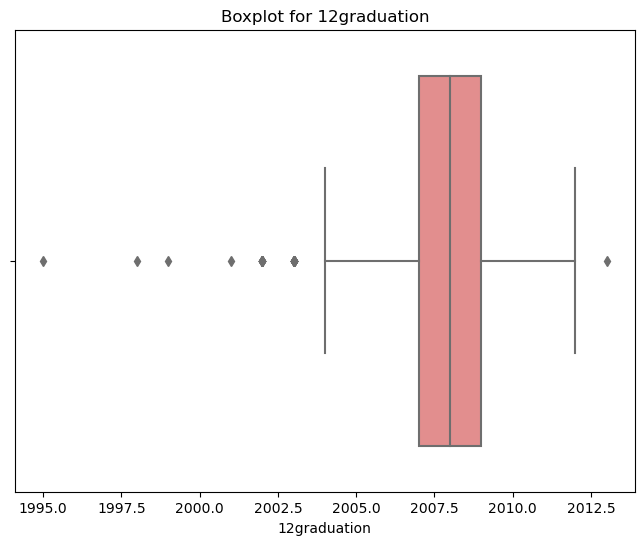

Outliers in 12graduation:
        Salary               Designation             JobCity Gender  \
59    120000.0         software engineer           Bangalore      m   
193   550000.0        software developer              Mumbai      m   
528   250000.0           design engineer           New Delhi      m   
600   200000.0          project engineer  Thiruvananthapuram      m   
670   160000.0          project engineer           Bangalore      f   
712   400000.0        programmer analyst        Kochi/Cochin      m   
772   320000.0            java developer              Baroda      m   
828   195000.0       technical recruiter             Unknown      m   
890   310000.0        software developer             Kolkata      m   
1169  105000.0          software trainee           New Delhi      m   
1178  320000.0         software engineer           Hyderabad      m   
1420  200000.0    administrative support         Bhubaneswar      f   
1502  200000.0           sales executive           

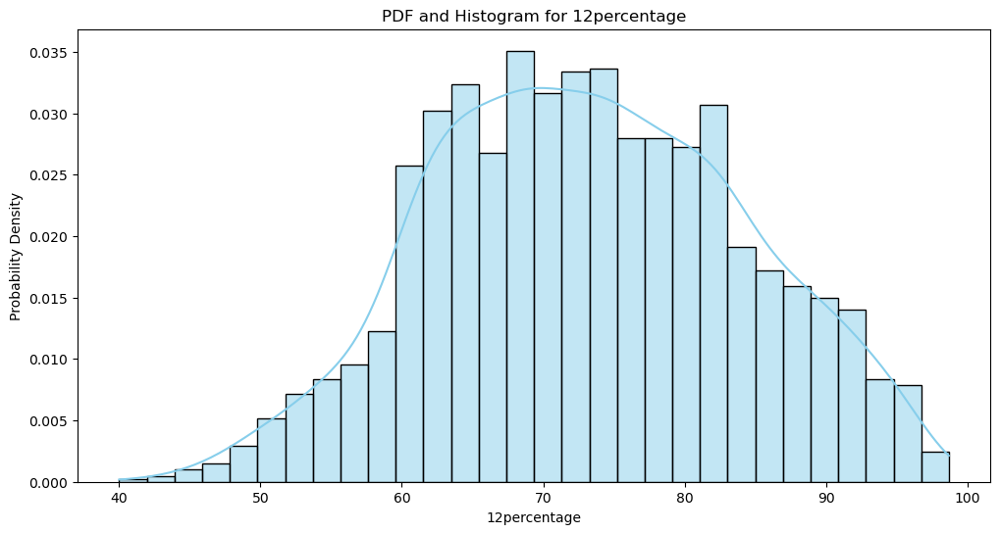

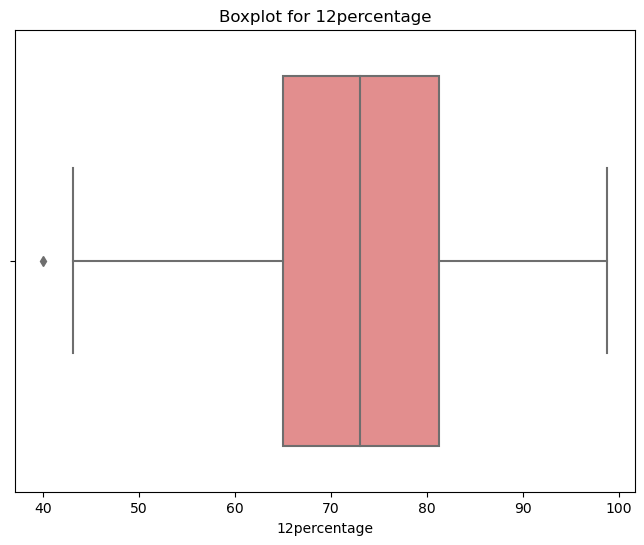

Outliers in 12percentage:
        Salary           Designation    JobCity Gender  10percentage  10board  \
3337  300000.0  system administrator  Hyderabad      m          74.0  Unknown   

      12graduation  12percentage  12board  CollegeTier  ... ComputerScience  \
3337        2008.0          40.0  Unknown            2  ...              -1   

     MechanicalEngg  ElectricalEngg  TelecomEngg CivilEngg  conscientiousness  \
3337             -1              -1           -1        -1             -0.881   

      agreeableness  extraversion  nueroticism  openess_to_experience  
3337         0.0328       -1.5051      -0.2902                -0.9194  

[1 rows x 32 columns]


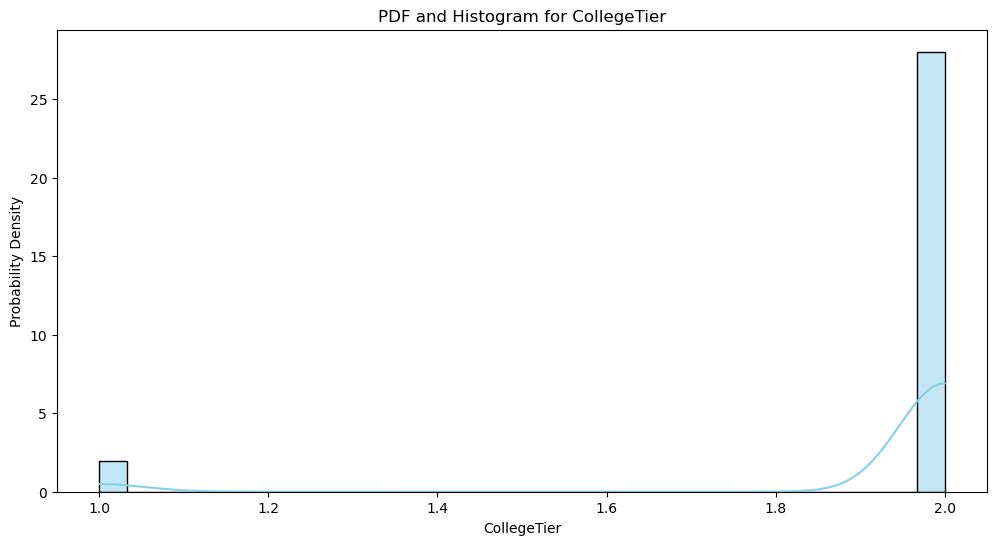

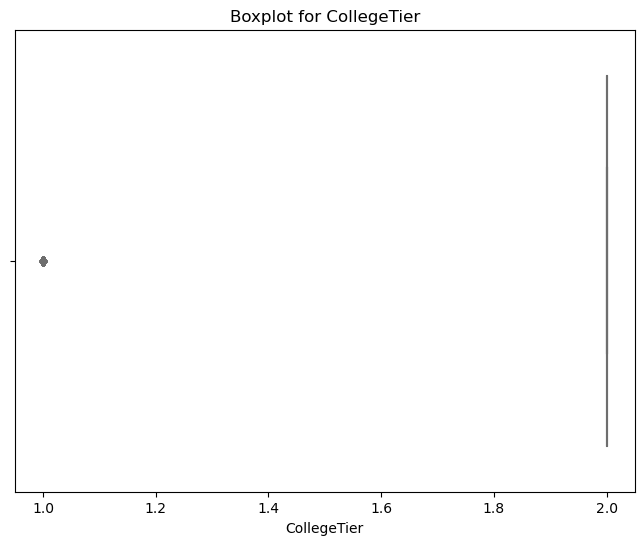

Outliers in CollegeTier:
        Salary                           Designation     JobCity Gender  \
7     400000.0                   mechanical engineer   Bangalore      m   
11    450000.0               senior systems engineer        Pune      m   
64    240000.0                java software engineer     Gurgaon      m   
137   340000.0                     software engineer     Gurgaon      m   
158   325000.0                      systems engineer        Pune      m   
...        ...                                   ...         ...    ...   
3856  400000.0           associate software engineer       Noida      m   
3913  370000.0         software development engineer  Coimbatore      m   
3914  220000.0  field business development associate   New Delhi      m   
3972  180000.0                     help desk analyst       Noida      m   
3979  550000.0                     software engineer   Bangalore      m   

      10percentage      10board  12graduation  12percentage      12board  

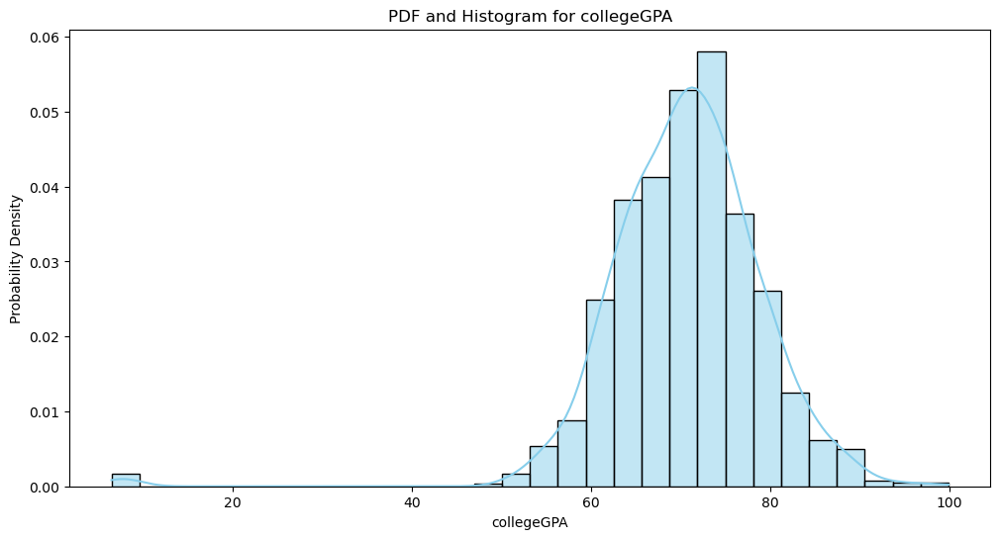

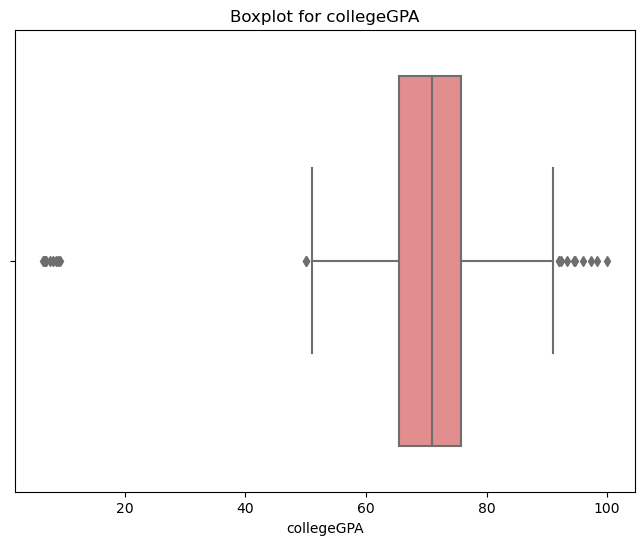

Outliers in collegeGPA:
        Salary                     Designation              JobCity Gender  \
7     400000.0             mechanical engineer            Bangalore      m   
44    380000.0              programmer analyst           Bangalore       f   
138   195000.0  business development managerde           coimbatore      m   
477   225000.0     linux systems administrator              Chennai      m   
690   440000.0              software developer              Gurgaon      f   
788   180000.0     electrical project engineer                Jowai      m   
874   400000.0              programmer analyst              Chennai      m   
907   100000.0             production engineer                 Pune      m   
1029  300000.0                  java developer           Coimbatore      f   
1134  350000.0               software engineer                Noida      f   
1264  500000.0               assistant manager            Pantnagar      m   
1345  460000.0       electrical field en

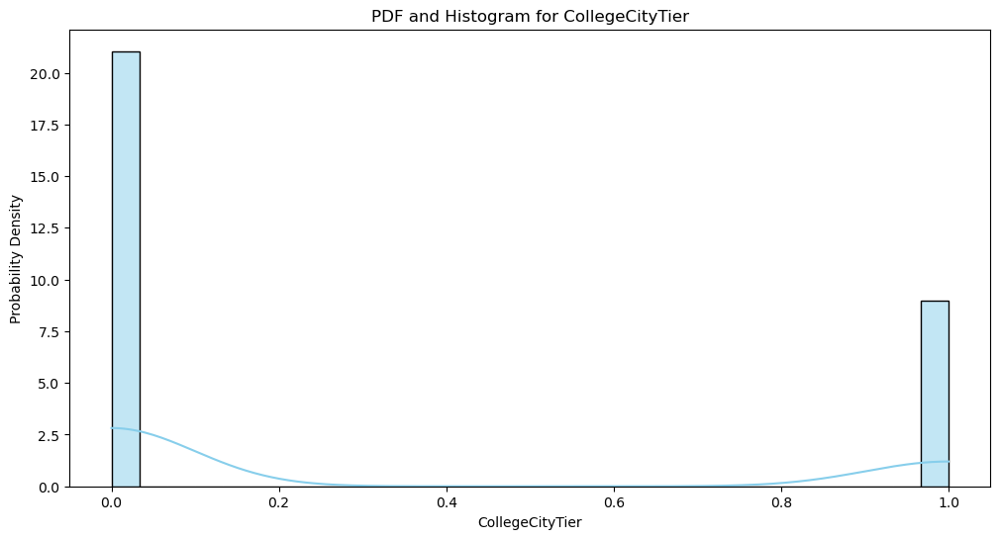

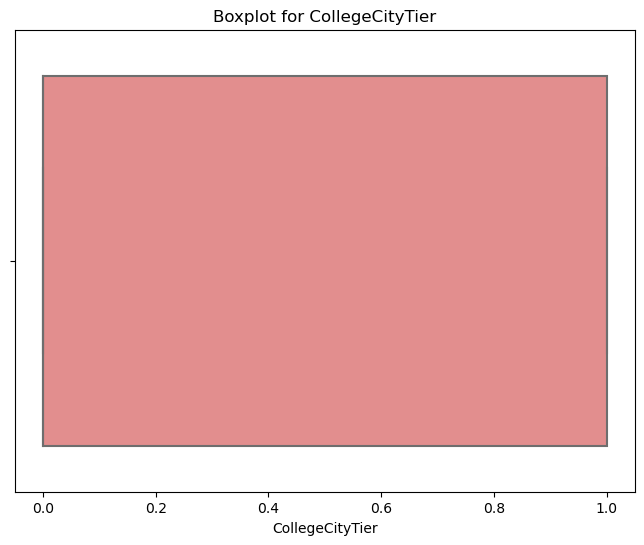

Outliers in CollegeCityTier:
Empty DataFrame
Columns: [Salary, Designation, JobCity, Gender, 10percentage, 10board, 12graduation, 12percentage, 12board, CollegeTier, Degree, Specialization, collegeGPA, CollegeCityTier, CollegeState, GraduationYear, English, Logical, Quant, Domain, ComputerProgramming, ElectronicsAndSemicon, ComputerScience, MechanicalEngg, ElectricalEngg, TelecomEngg, CivilEngg, conscientiousness, agreeableness, extraversion, nueroticism, openess_to_experience]
Index: []

[0 rows x 32 columns]


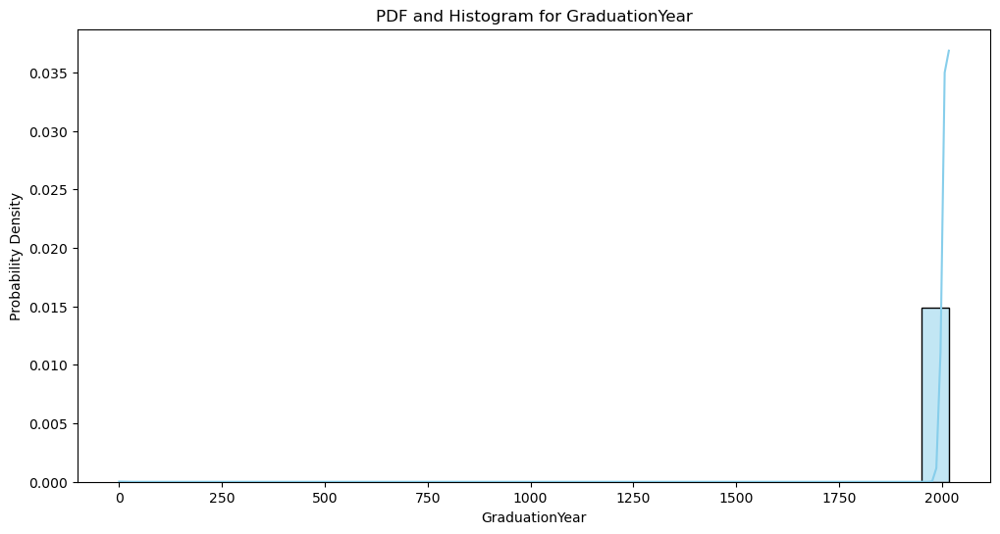

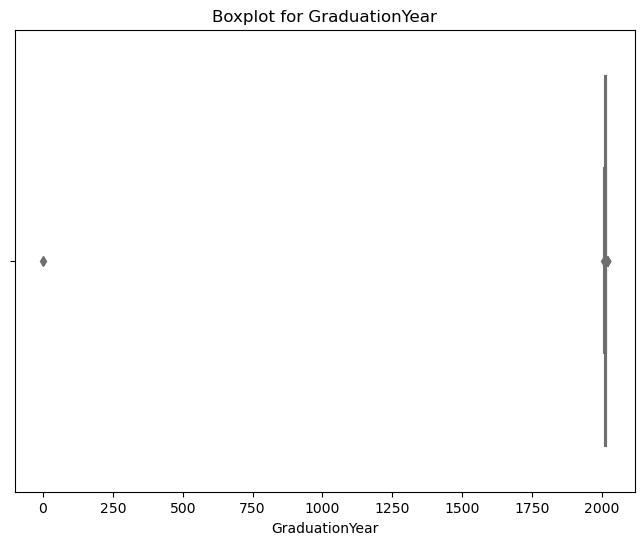

Outliers in GraduationYear:
        Salary                    Designation       JobCity Gender  \
379   120000.0             software developer     New Delhi      m   
728   100000.0             software developer       Unknown      f   
2018  330000.0               systems engineer  Bhubaneshwar      m   
2664  325000.0               systems engineer    Chandigarh      m   
3036  180000.0                  site engineer     New Delhi      m   
3193  120000.0              software engineer     Hyderabad      m   
3229  100000.0  software development engineer     Faridabad      m   
3370  300000.0                project manager     Panchkula      m   

      10percentage         10board  12graduation  12percentage  \
379          64.00            cbse        2009.0          57.0   
728          75.60     state board        2009.0          81.3   
2018         89.76            icse        2009.0          82.0   
2664         89.00            cbse        2010.0          85.2   
3036       

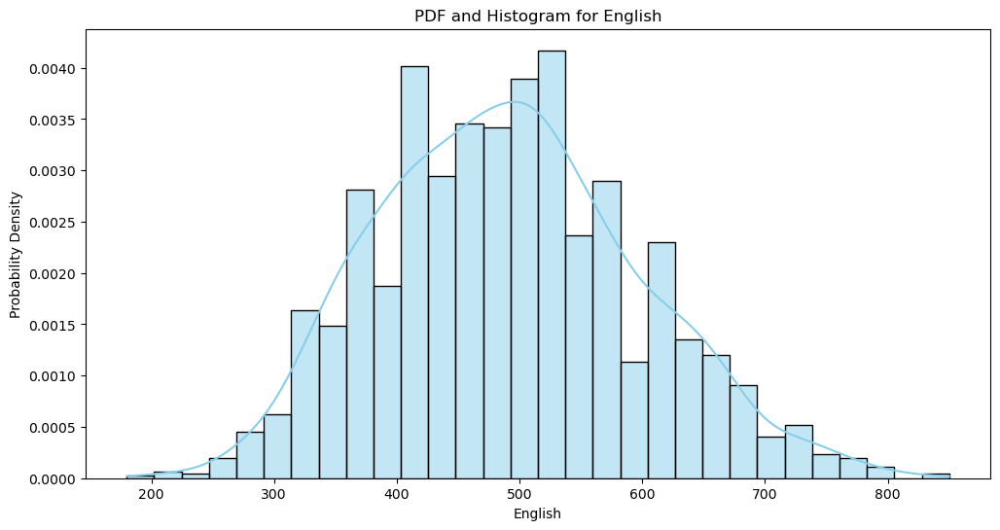

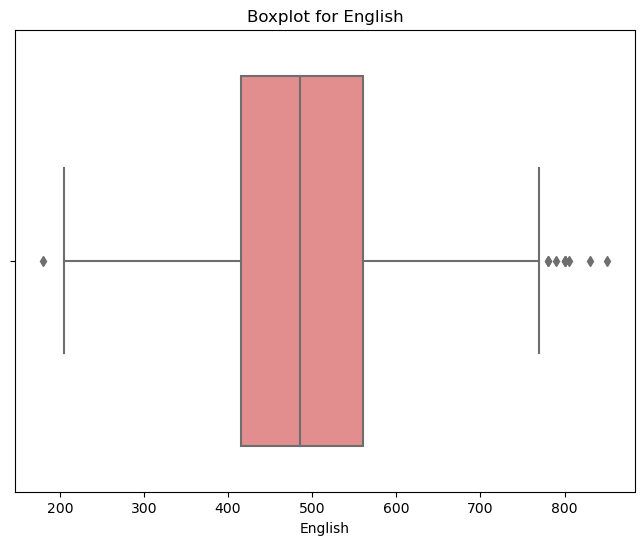

Outliers in English:
        Salary                  Designation     JobCity Gender  10percentage  \
839   315000.0            hardware engineer      Mumbai      m         78.80   
847   240000.0                      manager     Gurgaon      m         86.40   
1071  330000.0    assistant system engineer     Unknown      m         94.43   
1217  240000.0            assistant manager     kolkata      m         73.00   
1450  200000.0         web designer and seo     Bikaner      f         90.60   
1888  240000.0           software developer   Bangalore      m         92.50   
2077  305000.0           programmer analyst  Coimbatore      f         92.00   
2122  180000.0             project engineer    Nalagarh      m         85.60   
2596  240000.0  associate software engineer   Hyderabad      m         86.00   
3044  360000.0              junior engineer     Unknown      m         78.00   

          10board  12graduation  12percentage      12board  CollegeTier  ...  \
839          cbse 

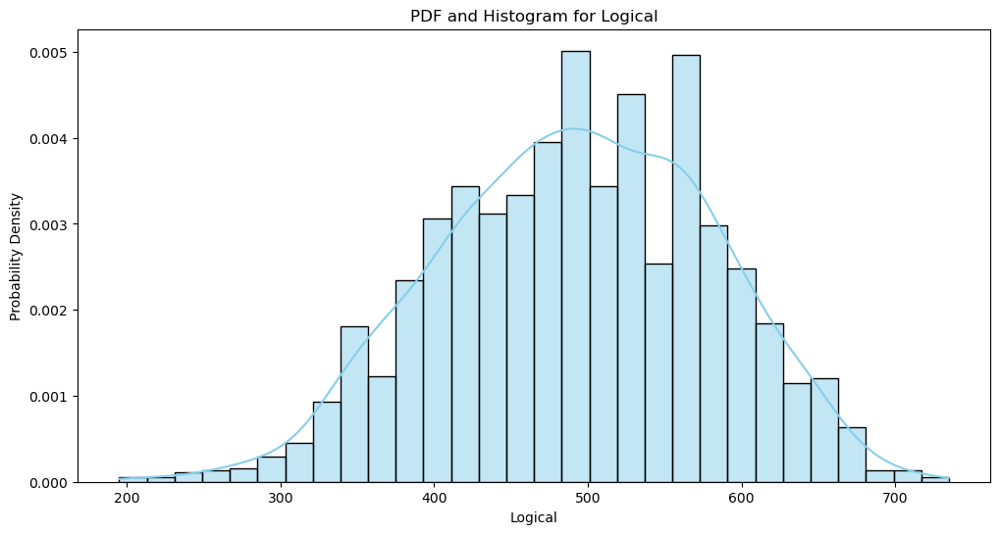

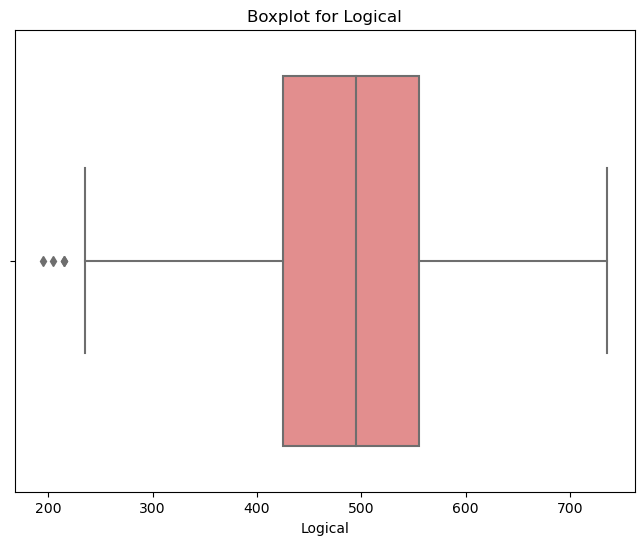

Outliers in Logical:
        Salary               Designation       JobCity Gender  10percentage  \
133   300000.0     marketing coordinator  Bhubaneshwar      m          89.8   
345   110000.0      maintenance engineer       gurgaon      m          57.0   
628   505000.0  senior software engineer         Noida      m          73.0   
2830  150000.0    maintenance supervisor       Kolkata      m          64.0   

                  10board  12graduation  12percentage            12board  \
133               Unknown        2007.0          66.6            Unknown   
345                  cbse        2005.0          50.0               cbse   
628                  cbse        2006.0          58.0               cbse   
2830  gyan bharati school        2004.0          70.0  dav public school   

      CollegeTier  ... ComputerScience MechanicalEngg  ElectricalEngg  \
133           2.0  ...              -1             -1              -1   
345           2.0  ...              -1             -1   

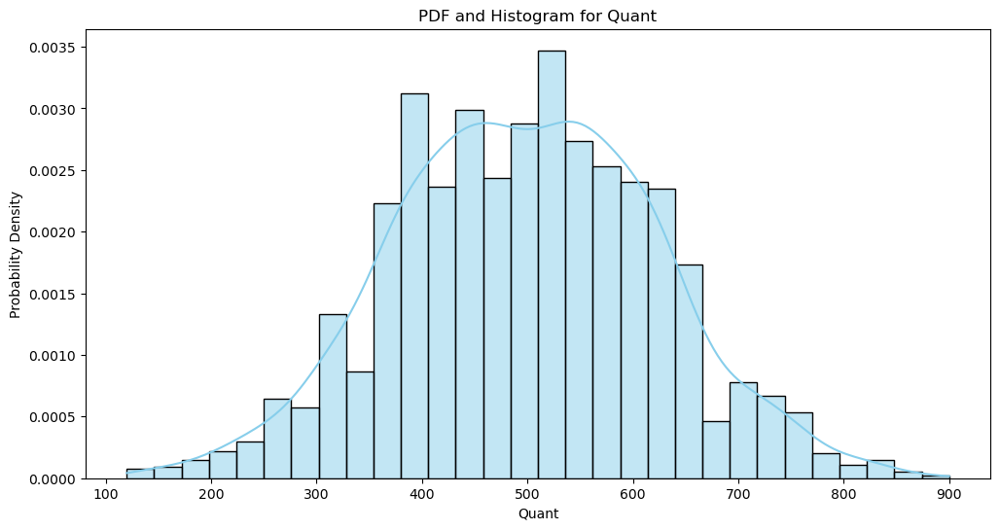

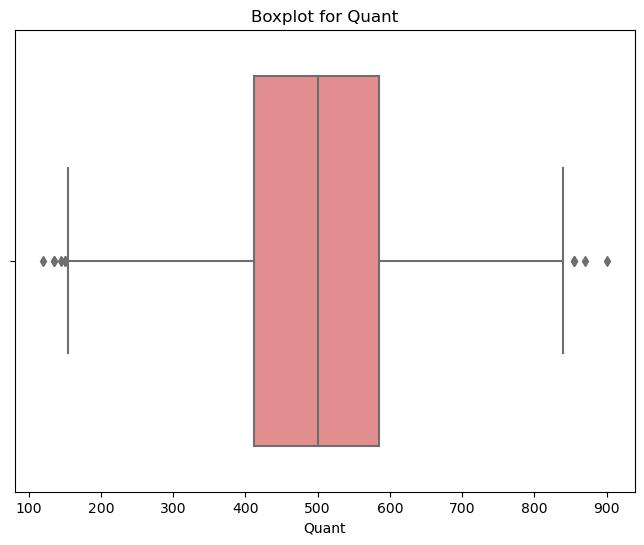

Outliers in Quant:
        Salary                      Designation    JobCity Gender  \
195   350000.0                  system engineer  New Delhi      m   
1815  205000.0           java software engineer    Gurgaon      m   
2007  350000.0                    test engineer  Hyderabad      m   
2134  150000.0        trainee software engineer    Unknown      m   
2437  120000.0  customer service representative  Bangalore      m   
2490   80000.0   entry level management trainee       Pune      m   
2616   80000.0                 network engineer    Kolkata      f   
3239  325000.0                product developer      Noida      m   
3258  240000.0             supply chain analyst    Chennai      m   
3283  225000.0           software test engineer    Gurgaon      f   

      10percentage        10board  12graduation  12percentage        12board  \
195          82.00           cbse        2008.0          81.2           cbse   
1815         54.00    state board        2010.0          62.0

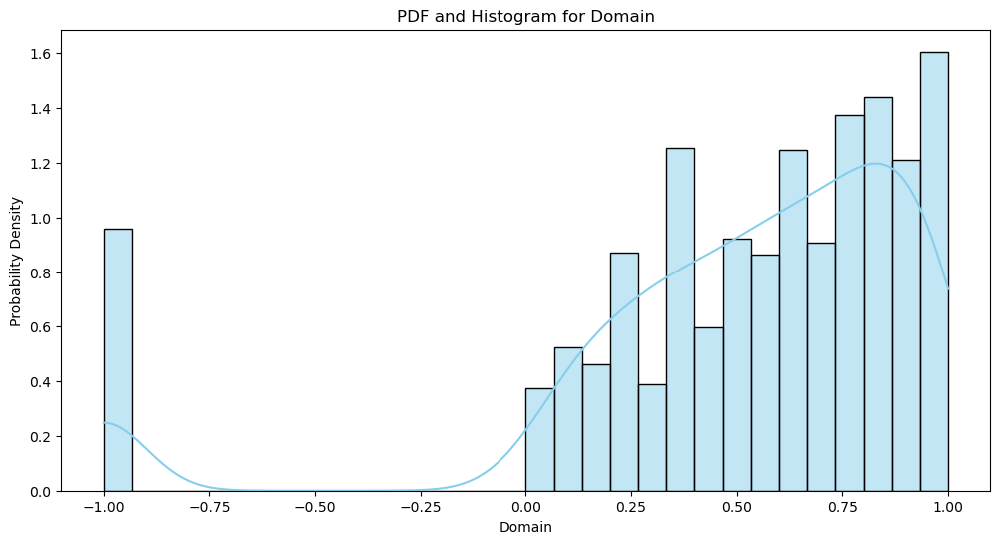

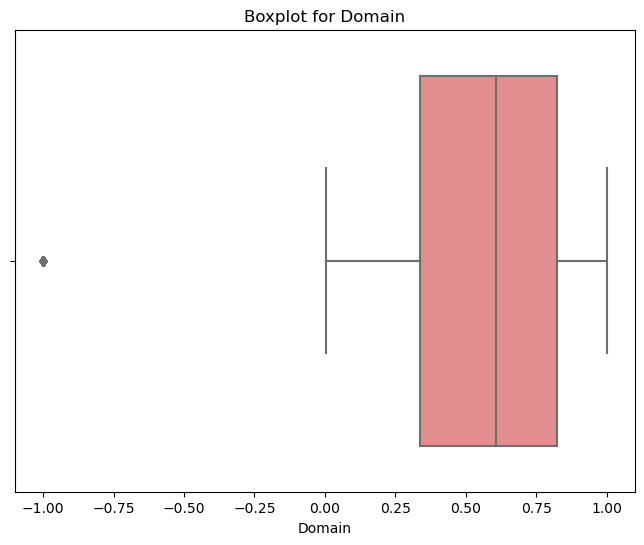

Outliers in Domain:
        Salary                      Designation        JobCity Gender  \
22    190000.0                        developer      Hyderabad      m   
73    240000.0                android developer  Greater Noida      m   
83    145000.0  customer service representative         Jaipur      m   
91    275000.0                 quality engineer      Bangalore      m   
93    325000.0                software engineer        Gurgaon      m   
...        ...                              ...            ...    ...   
3787  325000.0                  system engineer          Noida      m   
3854   85000.0               quality consultant        Kolkata      f   
3893  190000.0           java software engineer        Kolkata      m   
3960  240000.0                    web developer        Kolkata      m   
3978  320000.0                software engineer      Hyderabad      f   

      10percentage      10board  12graduation  12percentage      12board  \
22           92.50  state b

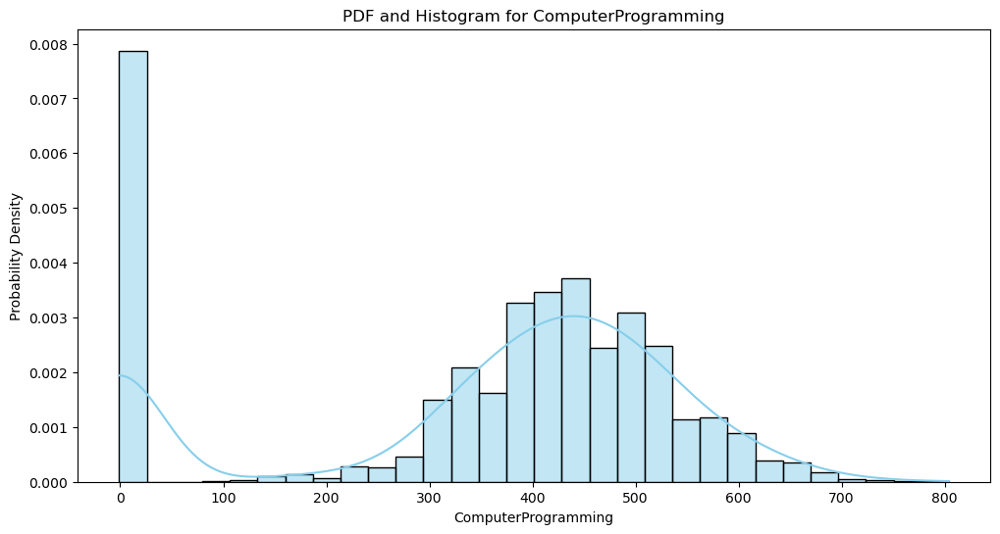

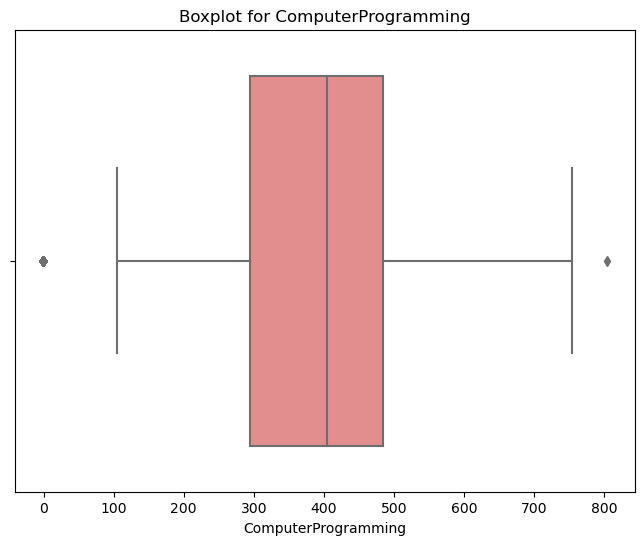

Outliers in ComputerProgramming:
        Salary                  Designation    JobCity Gender  10percentage  \
4     200000.0                          get    Manesar      m          78.0   
7     400000.0          mechanical engineer  Bangalore      m          92.0   
23    180000.0  electrical project engineer  Bangalore      m          70.0   
27    300000.0                          ase  Bangalore      m          76.8   
39    200000.0           management trainee    Unknown      m          88.0   
...        ...                          ...        ...    ...           ...   
3950  410000.0                  qa engineer       Pune      f          84.0   
3961  240000.0            planning engineer    Rajpura      m          84.2   
3978  320000.0            software engineer  Hyderabad      f          89.7   
3980  150000.0                          get    haryana      m          84.0   
3992  240000.0                      manager     Rajkot      m          73.0   

                  

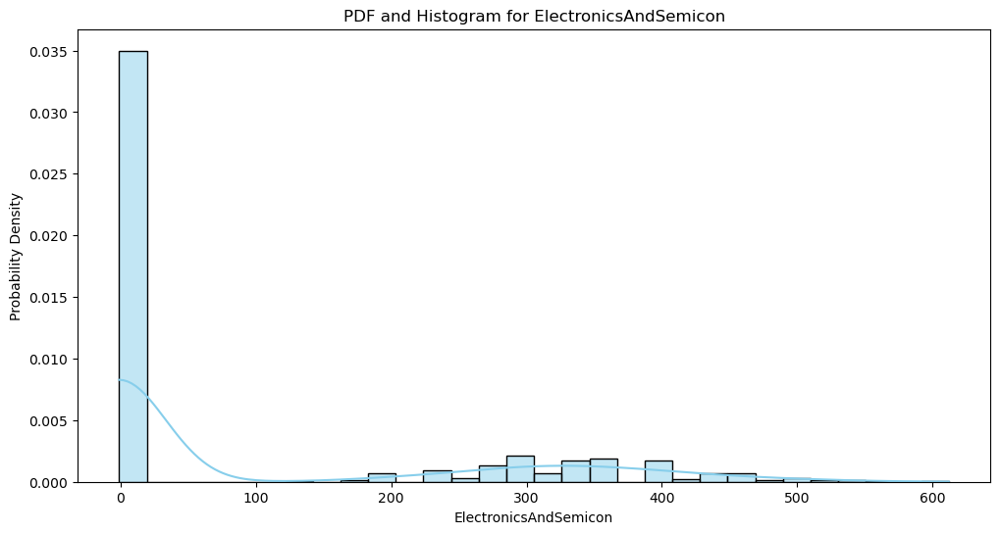

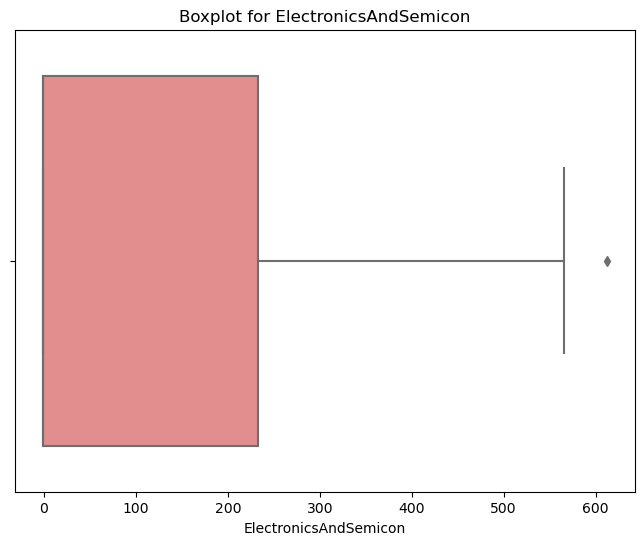

Outliers in ElectronicsAndSemicon:
        Salary       Designation    JobCity Gender  10percentage 10board  \
1557  350000.0  systems engineer  Hyderabad      f          84.4    cbse   

      12graduation  12percentage 12board  CollegeTier  ... ComputerScience  \
1557        2010.0          70.1    cbse          2.0  ...              -1   

     MechanicalEngg  ElectricalEngg  TelecomEngg CivilEngg  conscientiousness  \
1557             -1             580           -1        -1             1.8517   

      agreeableness  extraversion  nueroticism  openess_to_experience  
1557         1.0449          0.01      -2.3895                 0.8637  

[1 rows x 32 columns]


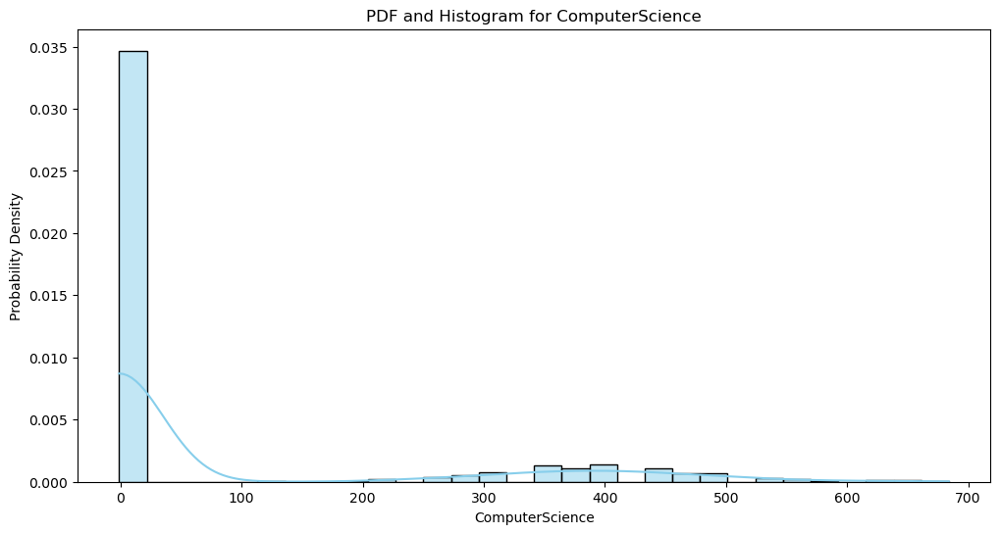

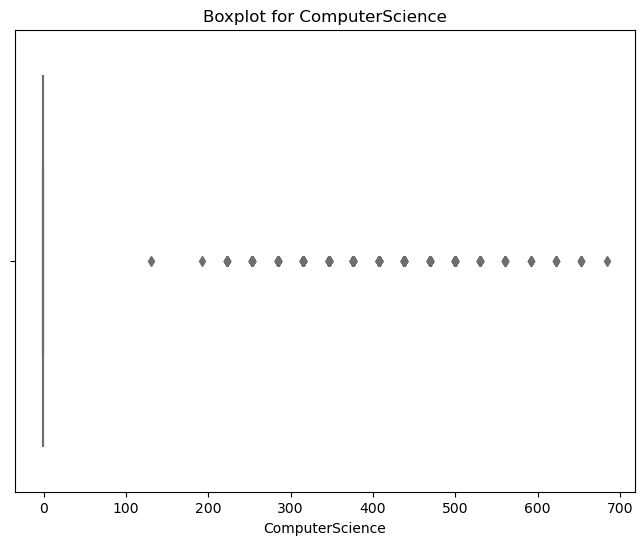

Outliers in ComputerScience:
        Salary                   Designation           JobCity Gender  \
6     300000.0        java software engineer          Banglore      m   
17    250000.0  associate software developer           Gurgaon      m   
24    335000.0            programmer analyst         Hyderabad      m   
31    340000.0             software engineer         Bangalore      m   
41    145000.0            software developer             Delhi      m   
...        ...                           ...               ...    ...   
3949  200000.0        jr. software developer         New Delhi      f   
3956  440000.0                .net developer         Hyderabad      f   
3959  390000.0             software engineer           Gurgaon      m   
3972  180000.0             help desk analyst             Noida      m   
3996  200000.0            software developer  Asifabadbanglore      f   

      10percentage      10board  12graduation  12percentage      12board  \
6            86.08

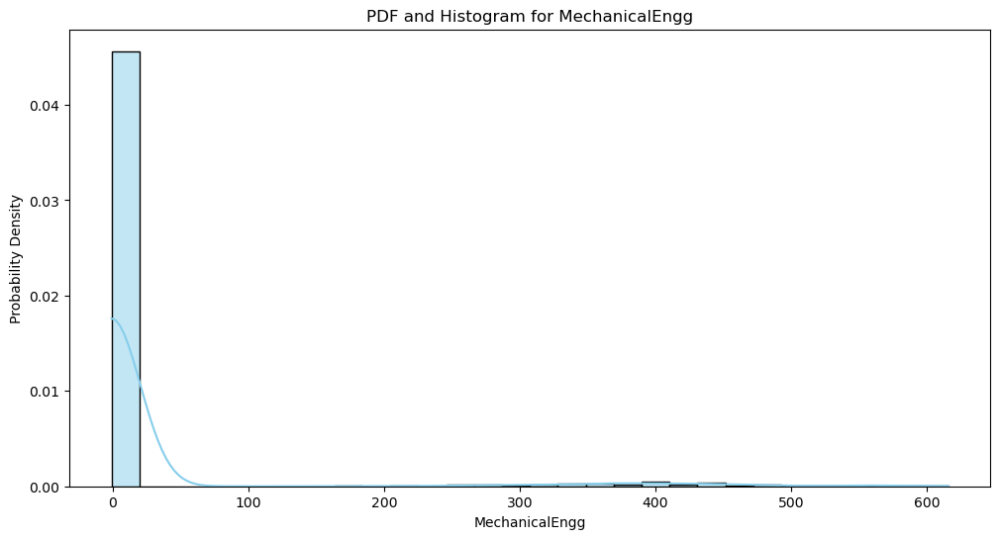

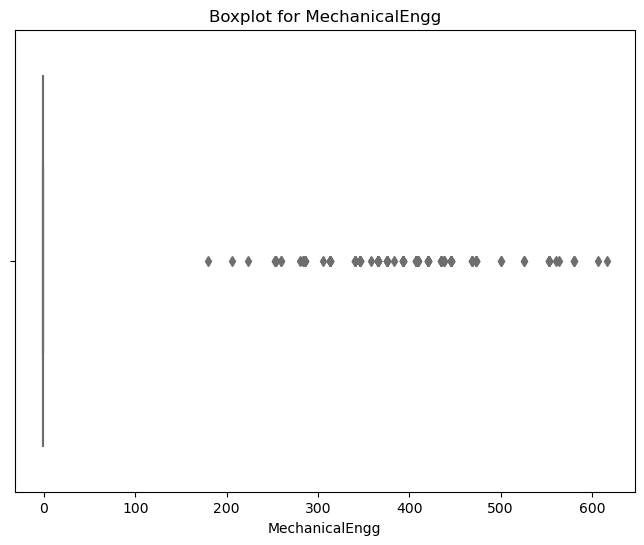

Outliers in MechanicalEngg:
        Salary               Designation       JobCity Gender  10percentage  \
7     400000.0       mechanical engineer     Bangalore      m         92.00   
26    345000.0  senior software engineer     Bangalore      m         90.88   
40    120000.0              site manager        Jhansi      m         66.60   
45    110000.0       production engineer       Chennai      m         95.80   
59    120000.0         software engineer     Bangalore      m         72.00   
...        ...                       ...           ...    ...           ...   
3873  130000.0       mechanical engineer  Bhubaneshwar      m         71.76   
3876  120000.0        software developer       Unknown      m         77.20   
3916  360000.0        management trainee        Hissar      m         79.80   
3929  100000.0              cad designer    Coimbatore      m         70.27   
3980  150000.0                       get       haryana      m         84.00   

                       

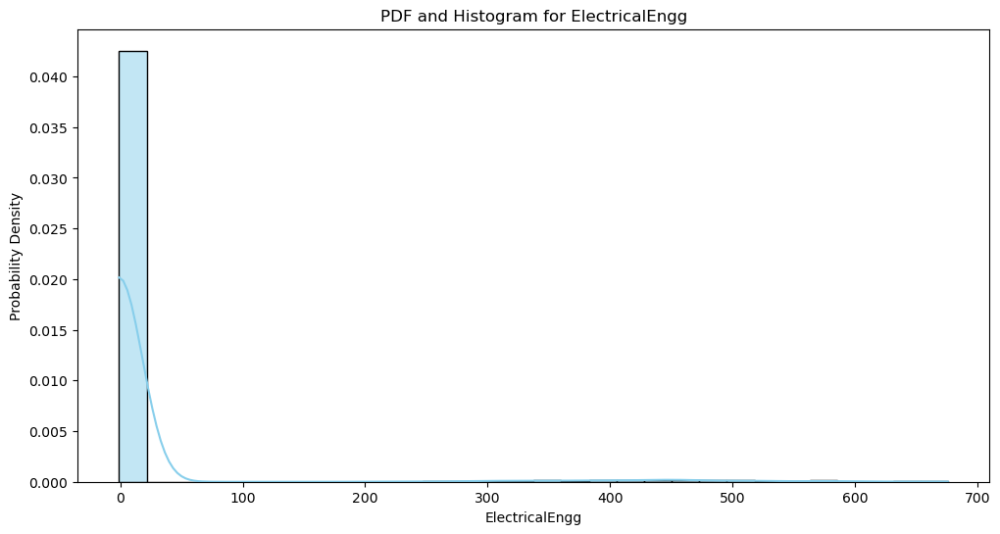

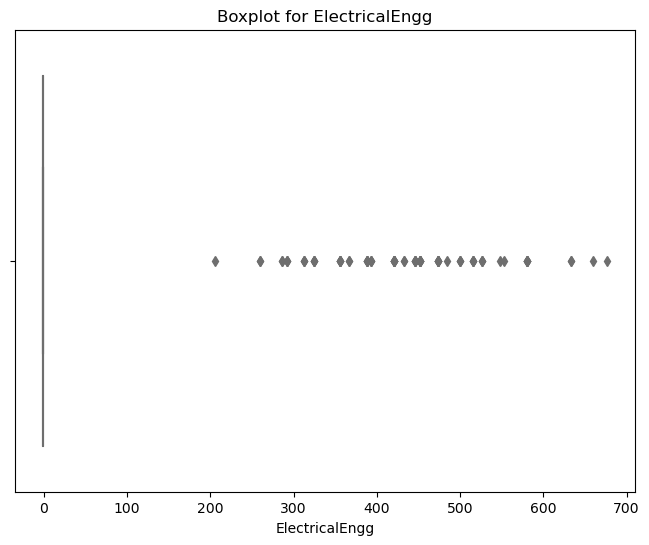

Outliers in ElectricalEngg:
        Salary                  Designation    JobCity Gender  10percentage  \
125   300000.0           programmer analyst    Kolkata      m         90.00   
180   180000.0              design engineer  New Delhi      m         65.80   
255   180000.0  electrical project engineer    Bankura      m         71.00   
267   180000.0          electrical designer    Chennai      m         93.60   
437    95000.0  business systems consultant    Chennai      m         78.80   
...        ...                          ...        ...    ...           ...   
3772  190000.0                   qa analyst  Hyderabad      f         86.50   
3800  170000.0          electrical designer     Raipur      m         65.00   
3832  565000.0                     engineer     Haldia      m         92.83   
3835  100000.0             project engineer    Kolkata      m         76.00   
3844  200000.0          electrical engineer  Bangalore      m         90.56   

            10board  12

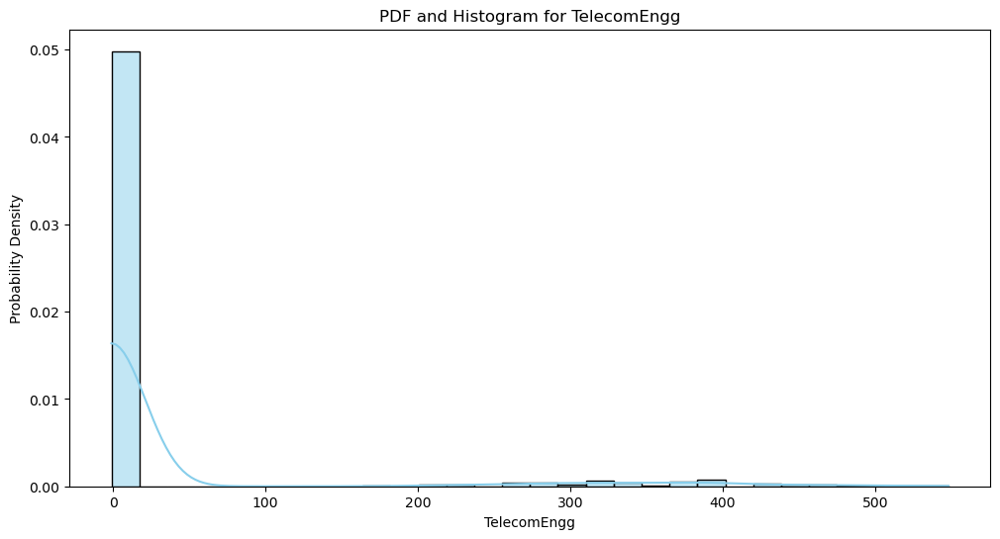

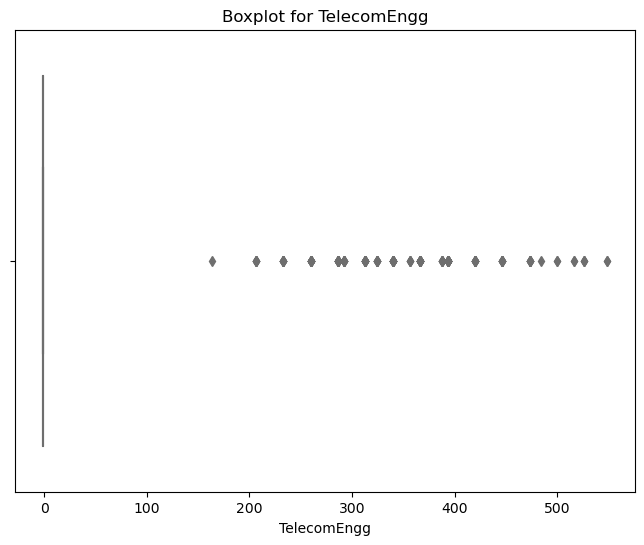

Outliers in TelecomEngg:
        Salary                     Designation    JobCity Gender  \
28    145000.0      telecommunication engineer      Noida      m   
81    280000.0                         faculty  New Delhi      m   
118   440000.0           application developer  Bangalore      f   
121   270000.0                network engineer     Mysore      m   
154   140000.0  business development executive    Unknown      f   
...        ...                             ...        ...    ...   
3924  215000.0            assistant programmer  New Delhi      f   
3934  200000.0                 service manager  new dehli      m   
3937  205000.0             production engineer    Unknown      m   
3954  310000.0   business intelligence analyst    Unknown      f   
3991  240000.0                 systems analyst  Bangalore      m   

      10percentage      10board  12graduation  12percentage  \
28            84.0         cbse        2011.0          68.0   
81            72.3         icse 

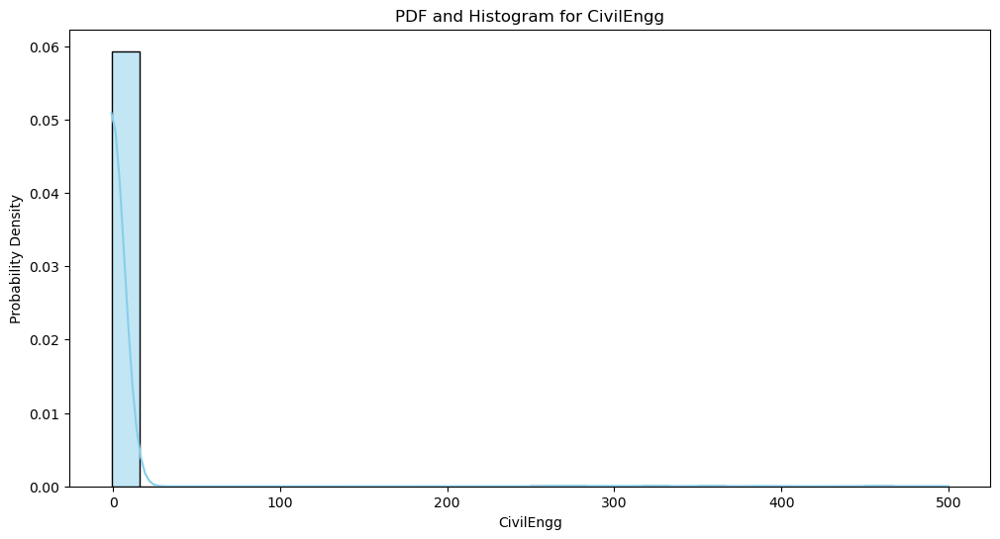

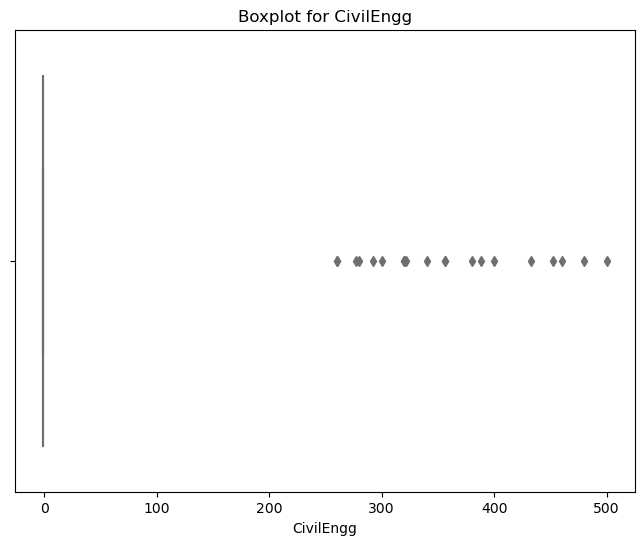

Outliers in CivilEngg:
        Salary                   Designation     JobCity Gender  10percentage  \
26    345000.0      senior software engineer   Bangalore      m         90.88   
59    120000.0             software engineer   Bangalore      m         72.00   
172   110000.0           assistant professor         Una      f         70.00   
211   350000.0          maintenance engineer      Nagpur      m         74.40   
222   100000.0                    programmer  Coimbatore      m         77.00   
605   350000.0        software test engineer   Bangalore      m         87.11   
896   300000.0              project engineer   Hyderabad      f         90.83   
1108  225000.0            assistant engineer    Dehradun      m         73.00   
1217  240000.0             assistant manager     kolkata      m         73.00   
1282   60000.0             software engineer   Bangalore      m         61.00   
1858  330000.0              project engineer     Unknown      m         62.00   
1880 

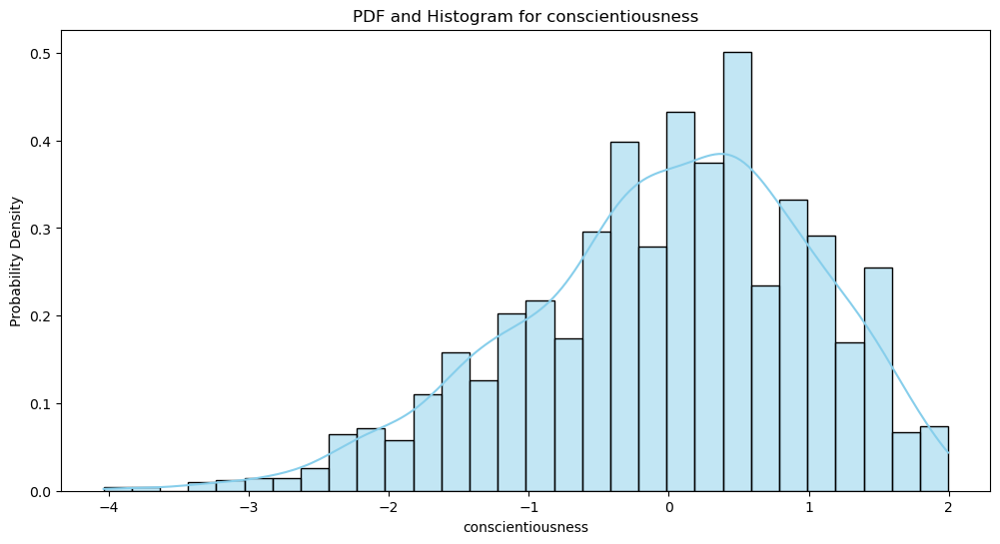

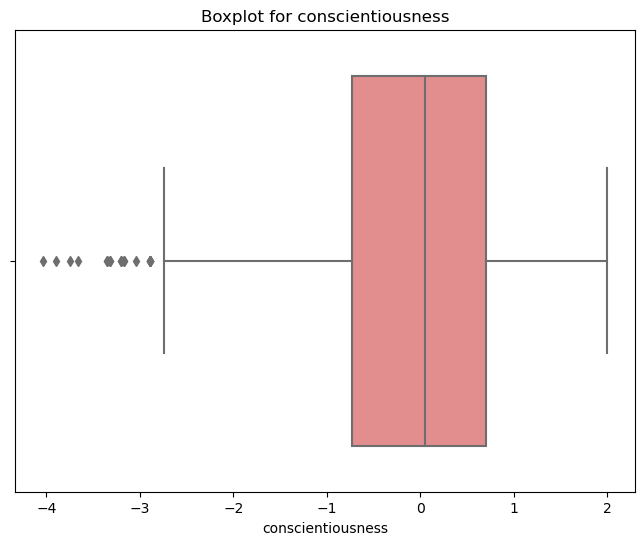

Outliers in conscientiousness:
        Salary                Designation     JobCity Gender  10percentage  \
159   340000.0          asp.net developer     Kolkata      m         87.00   
210   310000.0           network engineer     Lucknow      m         69.00   
408   280000.0               web designer     Gurgaon      m         68.00   
523   120000.0  junior software developer   Hyderabad      f         63.00   
1687  450000.0            system engineer        Pune      m         63.00   
1972  240000.0          software engineer   Bangalore      m         58.00   
2046  250000.0          android developer     Unknown      m         71.00   
2182  240000.0        automation engineer     gurgaon      m         53.00   
2224  325000.0          software engineer     Chennai      f         83.00   
2377  335000.0         programmer analyst   Bangalore      m         80.00   
2396  240000.0     software test engineer        Pune      m         83.40   
2569  220000.0               data

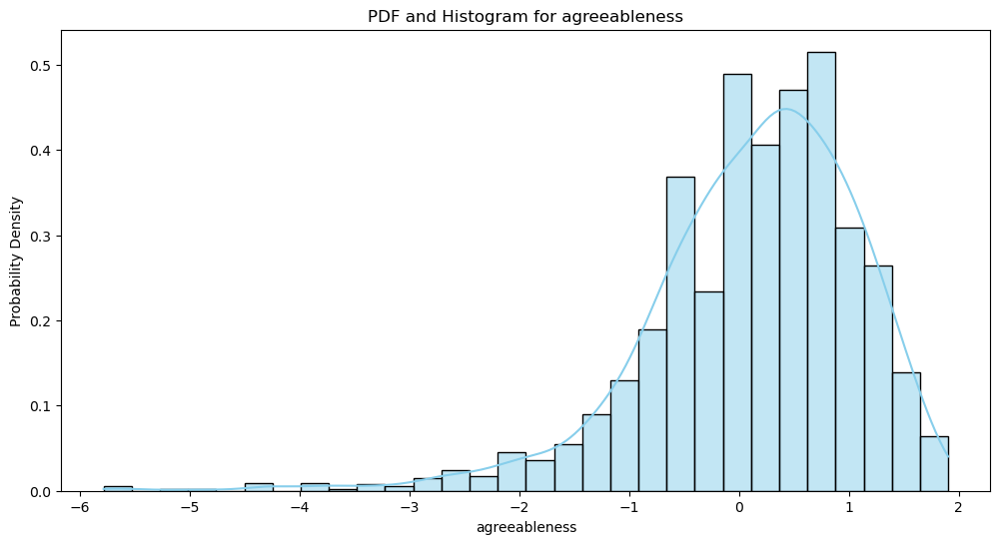

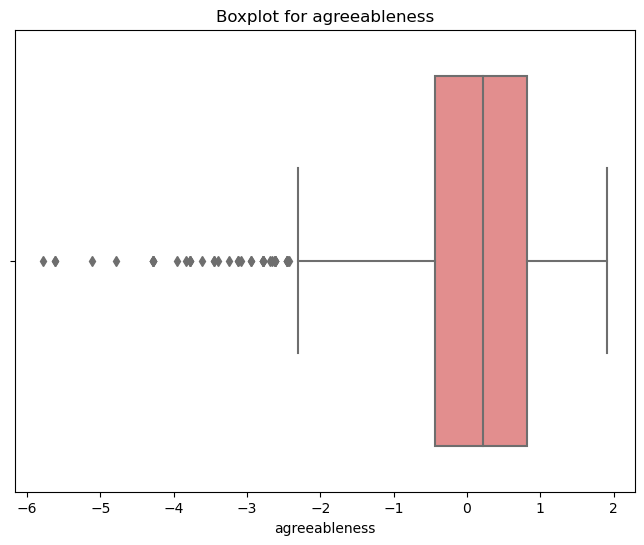

Outliers in agreeableness:
        Salary                        Designation     JobCity Gender  \
43    120000.0                     .net developer  Hyderabad       m   
63    150000.0                 management trainee     Bhiwadi      m   
67    400000.0                      test engineer   Bangalore      f   
159   340000.0                  asp.net developer     Kolkata      m   
523   120000.0          junior software developer   Hyderabad      f   
879   240000.0            implementation engineer   Bangalore      m   
904   130000.0               system administrator   Hyderabad      m   
1169  105000.0                   software trainee   New Delhi      m   
1170  105000.0          software engineer trainee     Unknown      m   
1370  200000.0  lecturer & electrical maintenance      Ongole      m   
1538  105000.0                     java developer     Unknown      m   
1566  180000.0                   network engineer     Chennai      m   
1588  120000.0                  proje

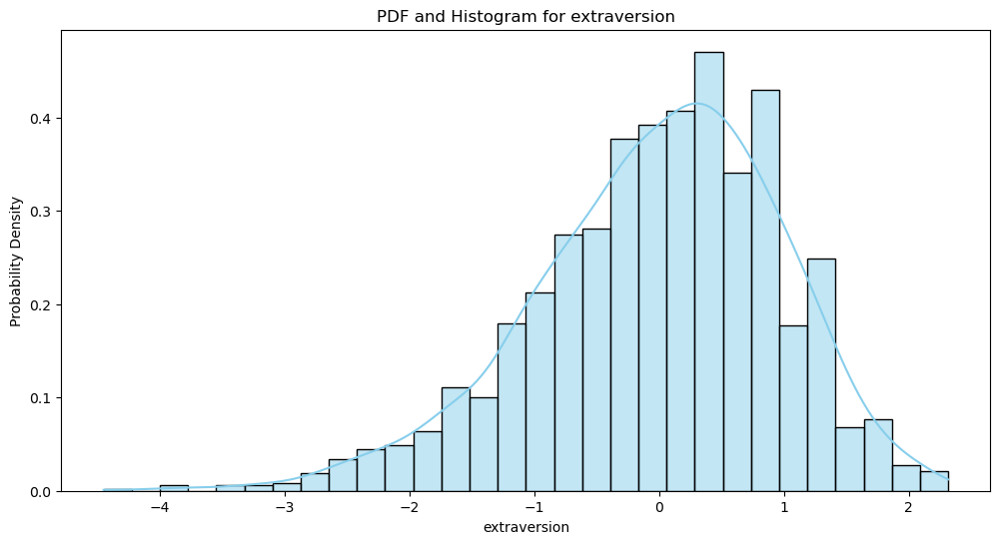

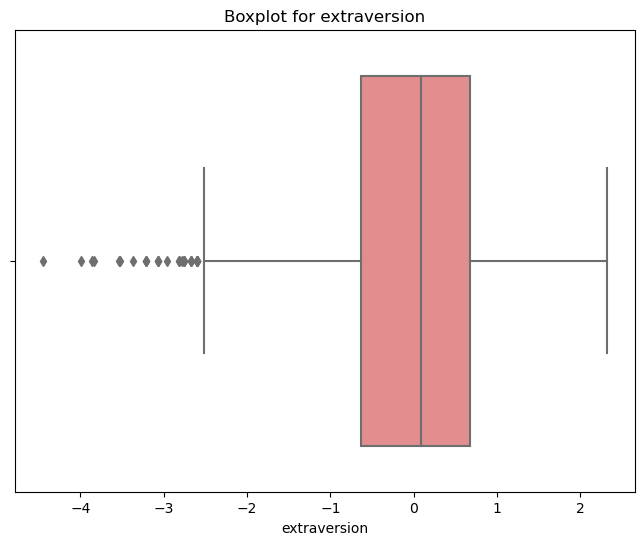

Outliers in extraversion:
        Salary                   Designation        JobCity Gender  \
63    150000.0            management trainee        Bhiwadi      m   
159   340000.0             asp.net developer        Kolkata      m   
408   280000.0                  web designer        Gurgaon      m   
523   120000.0     junior software developer      Hyderabad      f   
726   480000.0        java software engineer        mumbai       f   
1169  105000.0              software trainee      New Delhi      m   
1217  240000.0             assistant manager        kolkata      m   
1242  395000.0              project engineer        Chennai      f   
1538  105000.0                java developer        Unknown      m   
1566  180000.0              network engineer        Chennai      m   
1649  375000.0     associate system engineer        Gurgaon      m   
1785  240000.0              project engineer        Mumbai       m   
1789  300000.0            programmer analyst      Bangalore     

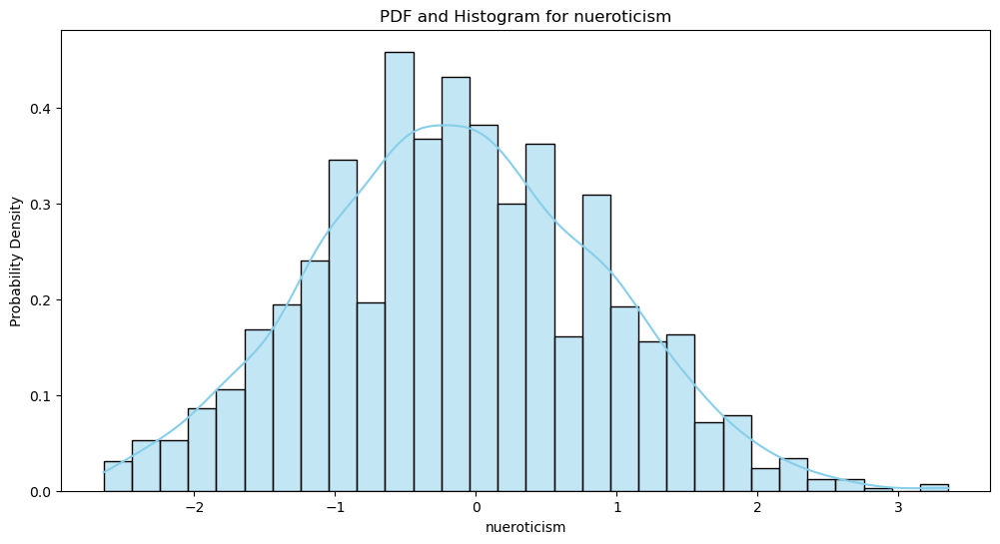

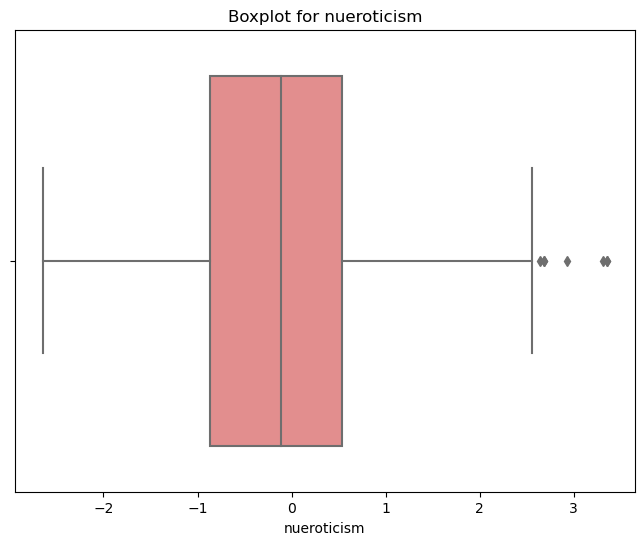

Outliers in nueroticism:
        Salary             Designation     JobCity Gender  10percentage  \
222   100000.0              programmer  Coimbatore      m         77.00   
405   145000.0         sales executive     Unknown      m         79.00   
1151  140000.0       software engineer   Bangalore      m         80.64   
1191  445000.0         system engineer      Mumbai      m         79.80   
1602  180000.0  software test engineer       Noida      m         71.50   
2608  180000.0       asp.net developer     Unknown      m         57.00   
2859  180000.0    salesforce developer        Pune      m         69.20   

                                  10board  12graduation  12percentage  \
222                           state board        2007.0         67.00   
405                           state board        2008.0         66.00   
1151  karnataka secondary education board        2009.0         64.45   
1191                              Unknown        2008.0         77.00   
1602     

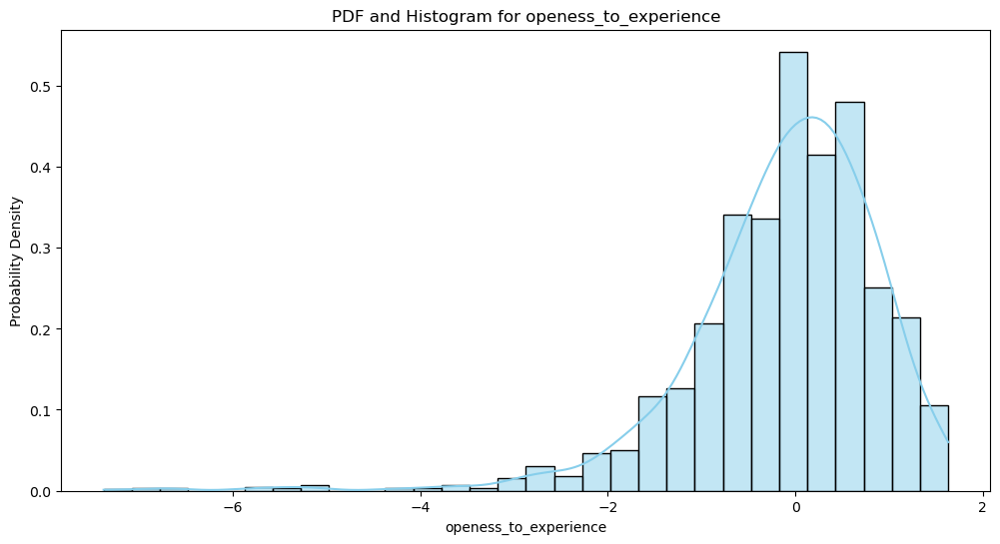

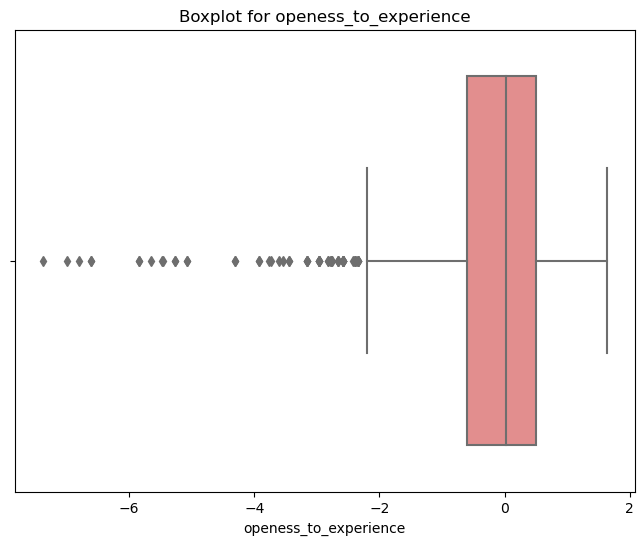

Outliers in openess_to_experience:
        Salary                     Designation     JobCity Gender  \
22    190000.0                       developer   Hyderabad      m   
23    180000.0     electrical project engineer   Bangalore      m   
43    120000.0                  .net developer  Hyderabad       m   
63    150000.0              management trainee     Bhiwadi      m   
159   340000.0               asp.net developer     Kolkata      m   
...        ...                             ...         ...    ...   
3674  115000.0               android developer      Mysore      m   
3694  180000.0                     rf engineer     Lucknow      m   
3843  240000.0                   test engineer      Jaipur      m   
3901  390000.0  software engineering associate        Pune      m   
3957  180000.0           network administrator      Meerut      m   

      10percentage      10board  12graduation  12percentage  \
22           92.50  state board        2009.0         95.20   
23        

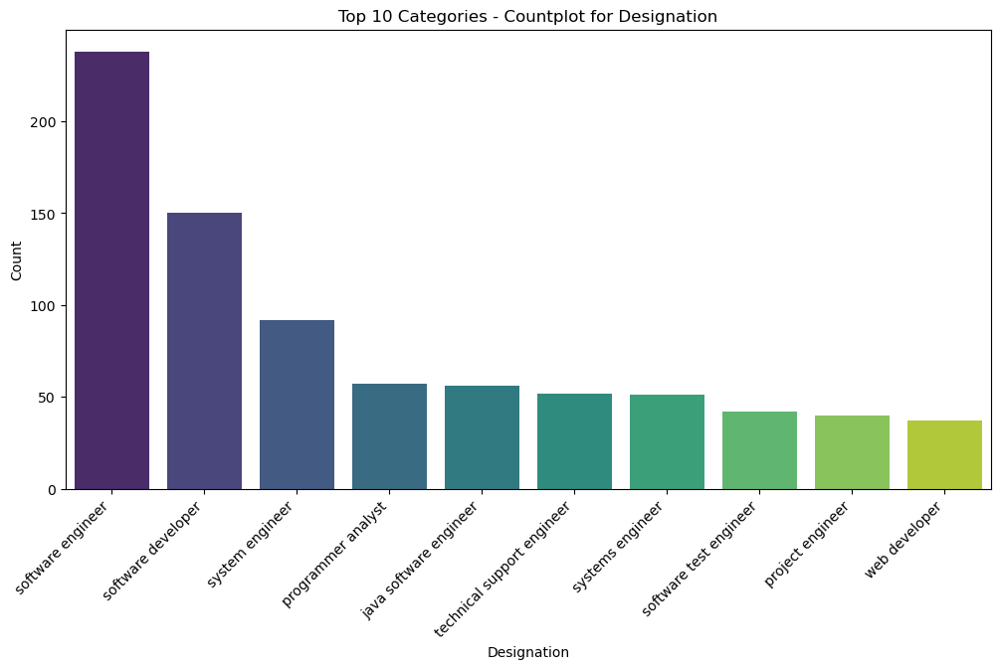

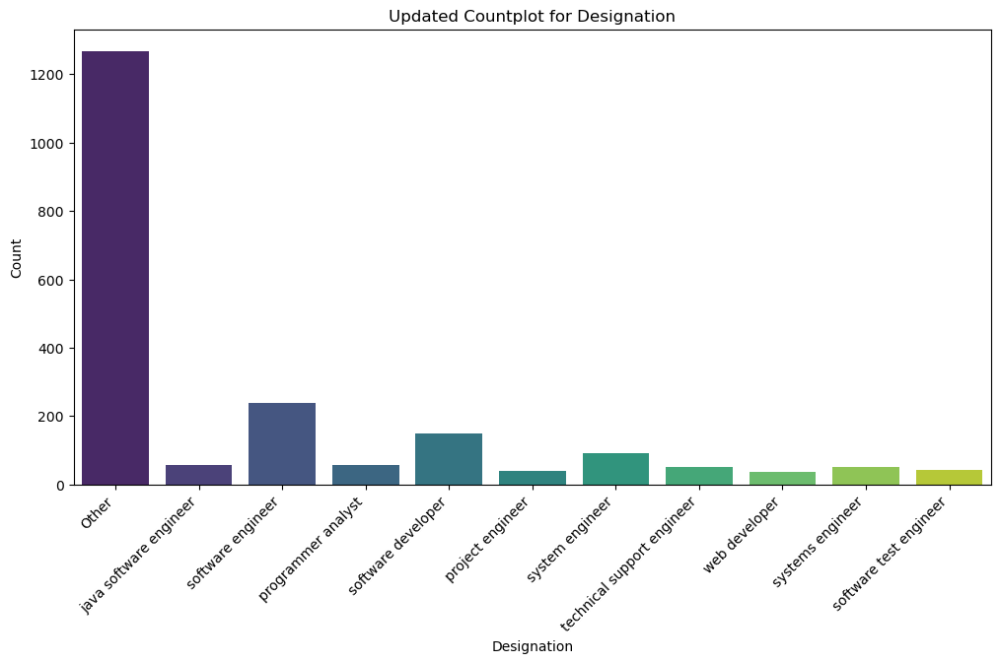

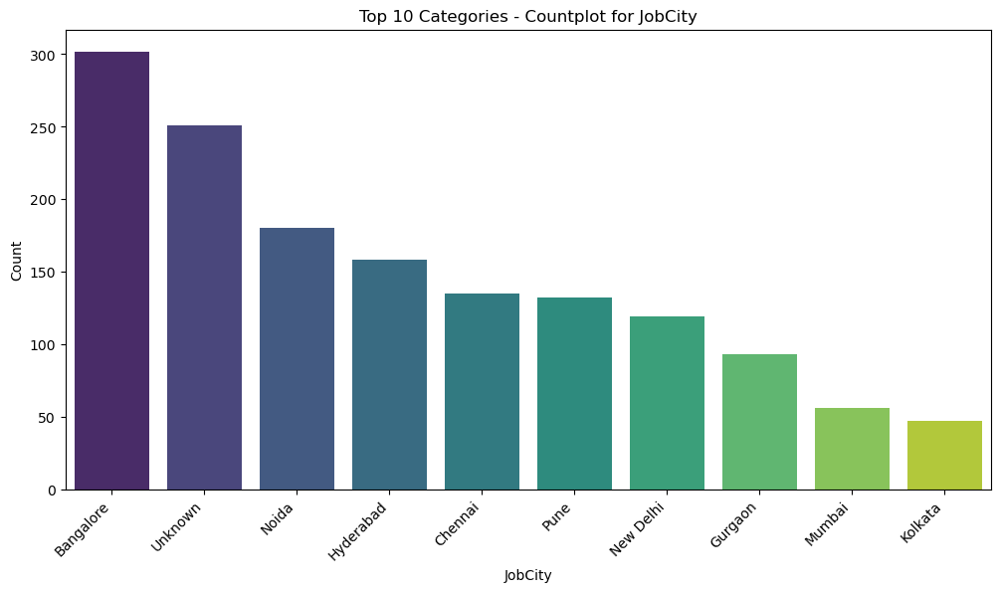

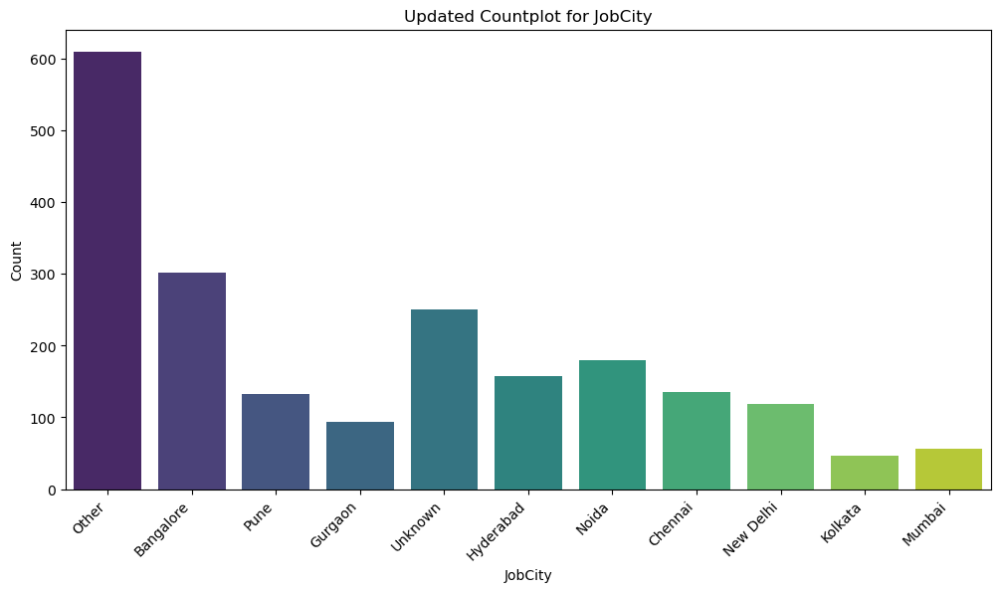

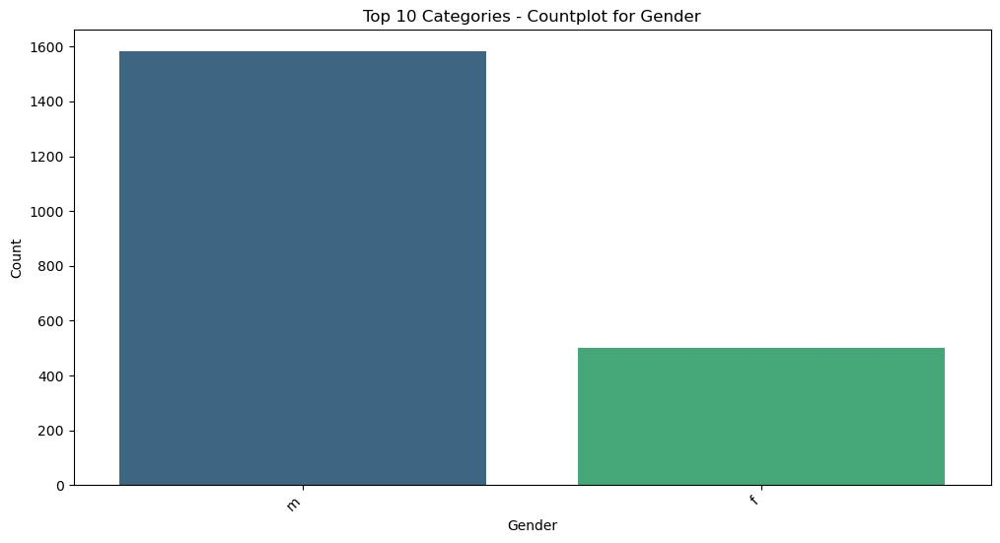

...

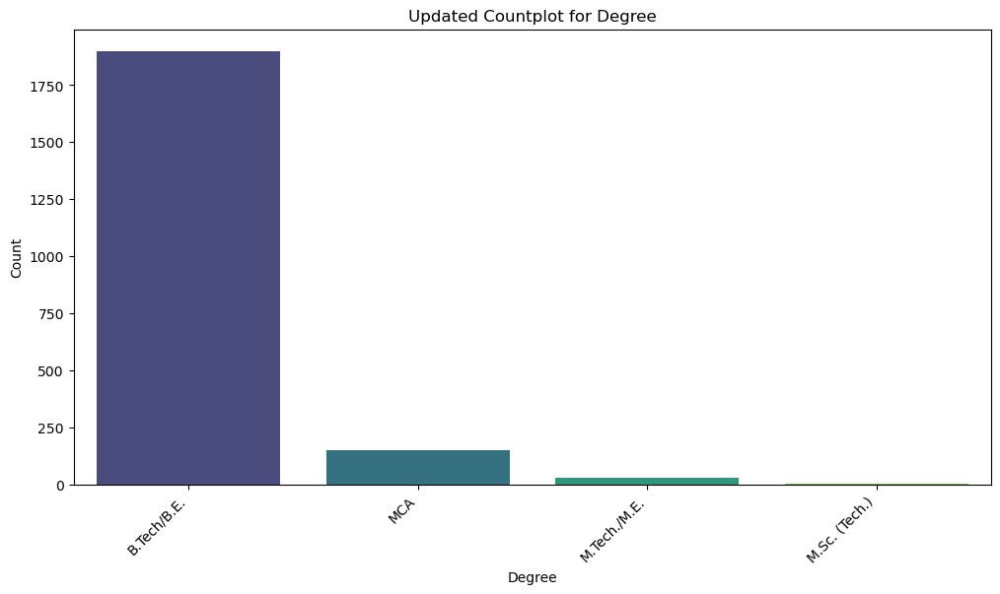

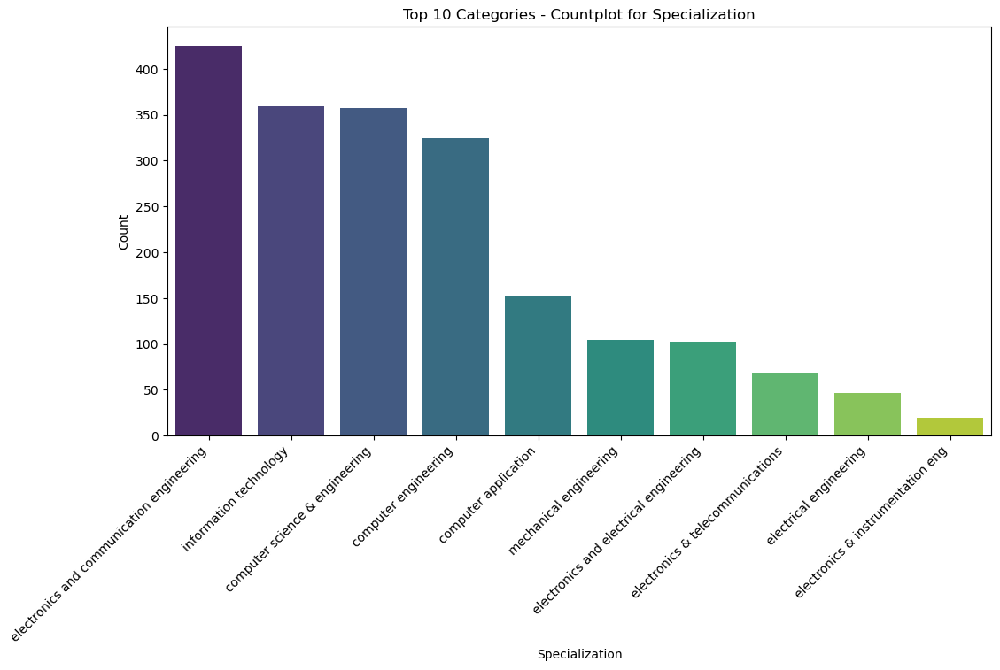

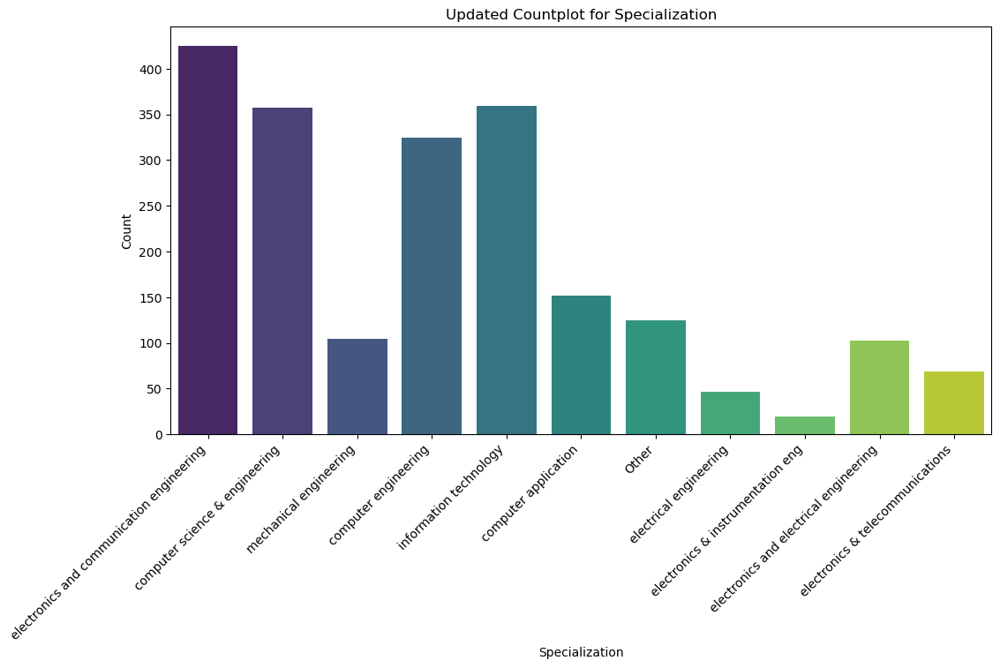

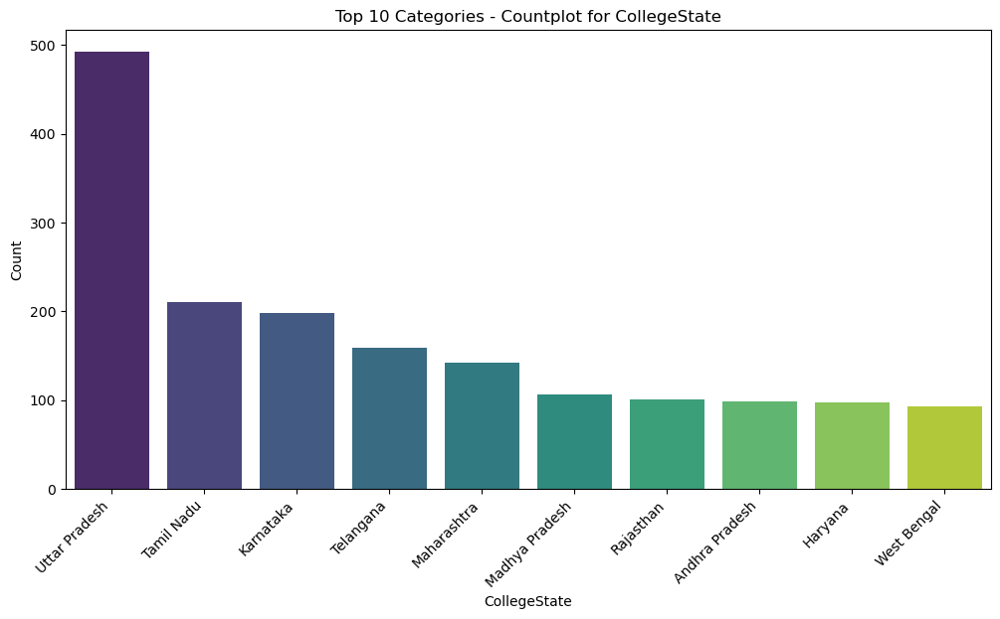

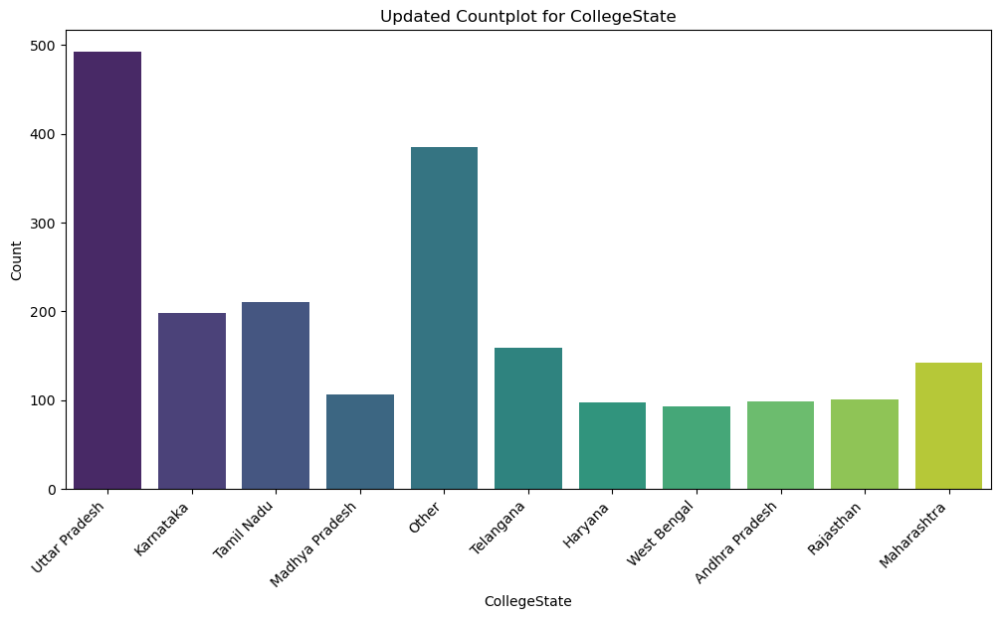

Updated Head of the Data:
      Salary             Designation    JobCity Gender  10percentage  \
4   200000.0                   Other      Other      m         78.00   
6   300000.0  java software engineer      Other      m         86.08   
7   400000.0                   Other  Bangalore      m         92.00   
10  240000.0                   Other  Bangalore      m         88.60   
11  450000.0                   Other       Pune      m         81.00   

        10board  12graduation  12percentage      12board  CollegeTier  ...  \
4          cbse        2008.0          76.8         cbse          2.0  ...   
6   state board        2010.0          67.5  state board          2.0  ...   
7          cbse        2010.0          91.0         cbse          2.0  ...   
10        Other        2006.0          83.7     mp board          2.0  ...   
11         cbse        2007.0          86.0         cbse          2.0  ...   

   ComputerScience MechanicalEngg  ElectricalEngg  TelecomEngg CivilEngg

In [5]:
# Identify columns that may not require analysis
columns_not_for_analysis = ['ID','DOB', 'DOJ', 'DOL', 'CollegeID', 'CollegeCityID','CollegeTier']

# Drop columns not for analysis
df_cleaned = df.drop(columns=columns_not_for_analysis)

# Univariate Analysis for Numerical Columns and Outlier Handling
for column in df_cleaned.select_dtypes(include=['float64', 'int64']).columns:
    # PDF and Histogram
    plt.figure(figsize=(12, 6))
    sns.histplot(df_cleaned[column], kde=True, bins=30, color='skyblue', stat='density')
    plt.title(f'PDF and Histogram for {column}')
    plt.xlabel(column)
    plt.ylabel('Probability Density')
    plt.show()

    # Boxplot
    plt.figure(figsize=(8, 6))
    sns.boxplot(x=df_cleaned[column], color='lightcoral')
    plt.title(f'Boxplot for {column}')
    plt.xlabel(column)
    plt.show()

    # Outliers
    Q1 = df_cleaned[column].quantile(0.25)
    Q3 = df_cleaned[column].quantile(0.75)
    IQR = Q3 - Q1
    outliers = df_cleaned[(df_cleaned[column] < Q1 - 1.5 * IQR) | (df_cleaned[column] > Q3 + 1.5 * IQR)]

    print(f'Outliers in {column}:')
    print(outliers)

    # Handling Outliers: Replace outliers with the median value
    df_cleaned[column] = np.where((df_cleaned[column] < Q1 - 1.5 * IQR) | (df_cleaned[column] > Q3 + 1.5 * IQR),
                                  df_cleaned[column].median(), df_cleaned[column])

# Univariate Analysis for Categorical Columns and Handling Many Categories
for column in df_cleaned.select_dtypes(include=['object']).columns:
    # Countplot
    plt.figure(figsize=(12, 6))
    sns.countplot(x=df_cleaned[column], palette='viridis', order=df_cleaned[column].value_counts().index[:10])
    plt.title(f'Top 10 Categories - Countplot for {column}')
    plt.xlabel(column)
    plt.ylabel('Count')
    plt.xticks(rotation=45, ha='right')
    plt.show()

    # Handling Many Categories: Keep the top 10 and group the rest as 'Other'
    top_categories = df_cleaned[column].value_counts().index[:10]
    df_cleaned[column] = np.where(df_cleaned[column].isin(top_categories), df_cleaned[column], 'Other')

    # Updated Countplot
    plt.figure(figsize=(12, 6))
    sns.countplot(x=df_cleaned[column], palette='viridis')
    plt.title(f'Updated Countplot for {column}')
    plt.xlabel(column)
    plt.ylabel('Count')
    plt.xticks(rotation=45, ha='right')
    plt.show()

# Display the updated dataset
print("Updated Head of the Data:")
print(df_cleaned.head())

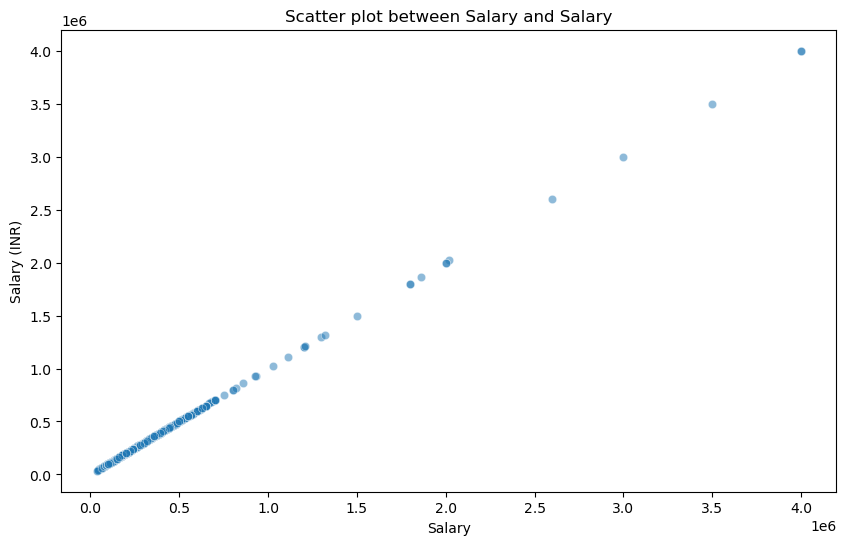

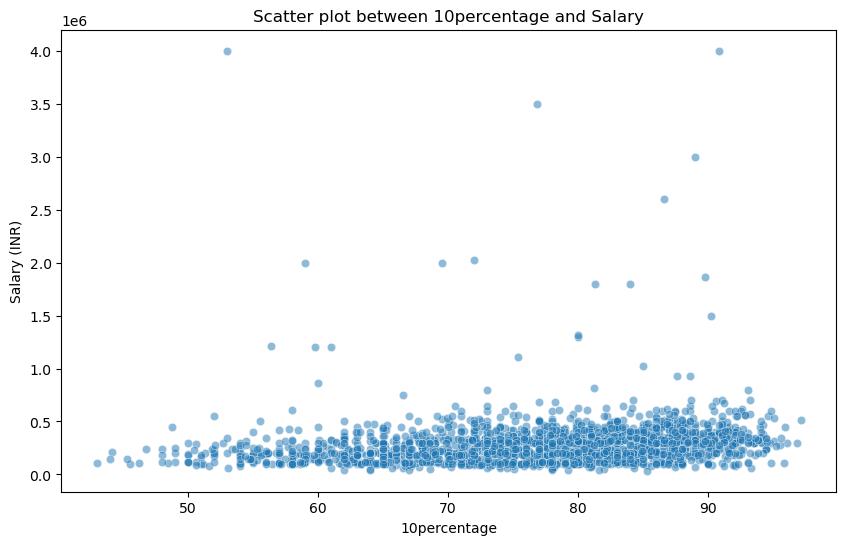

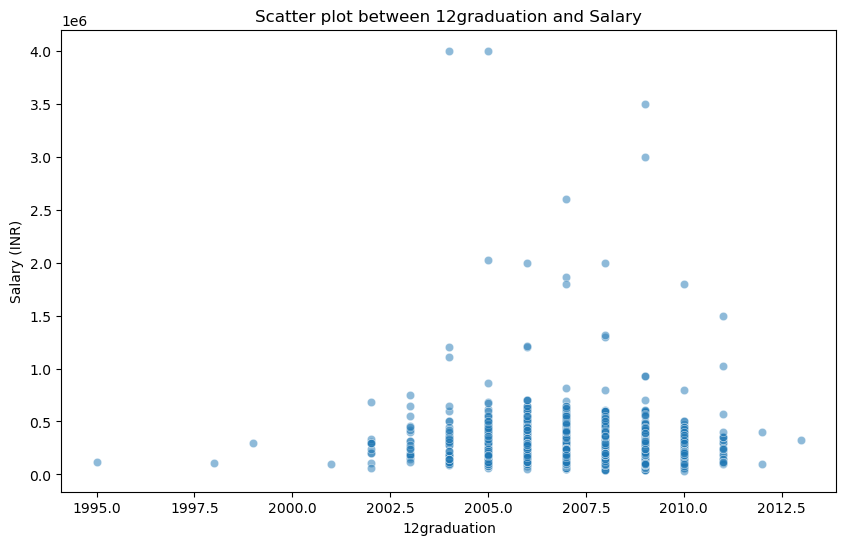

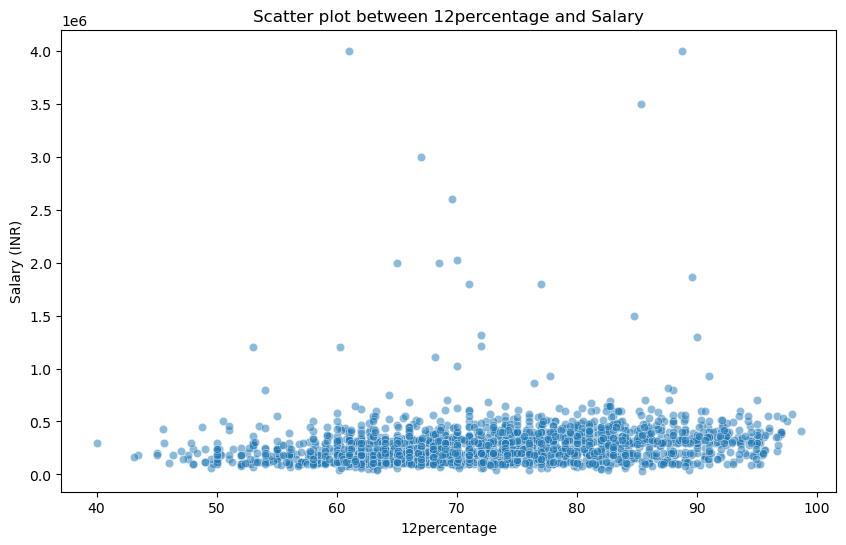

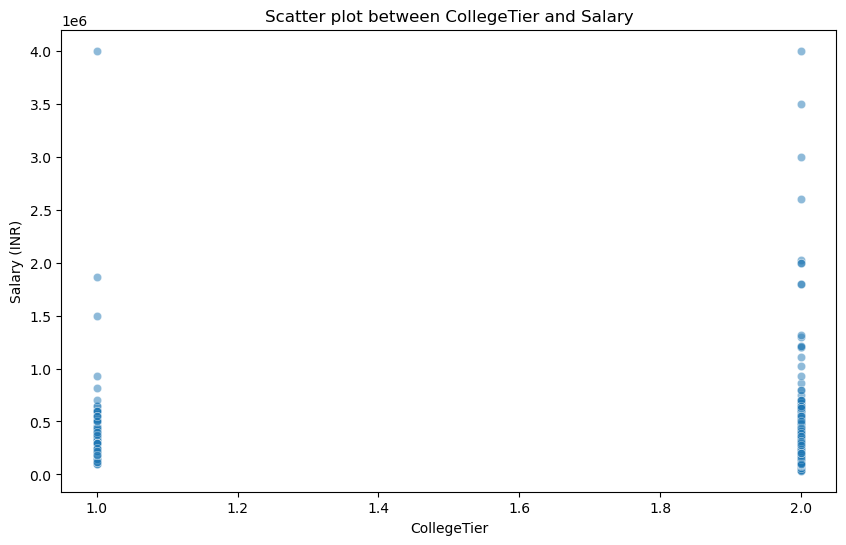

...

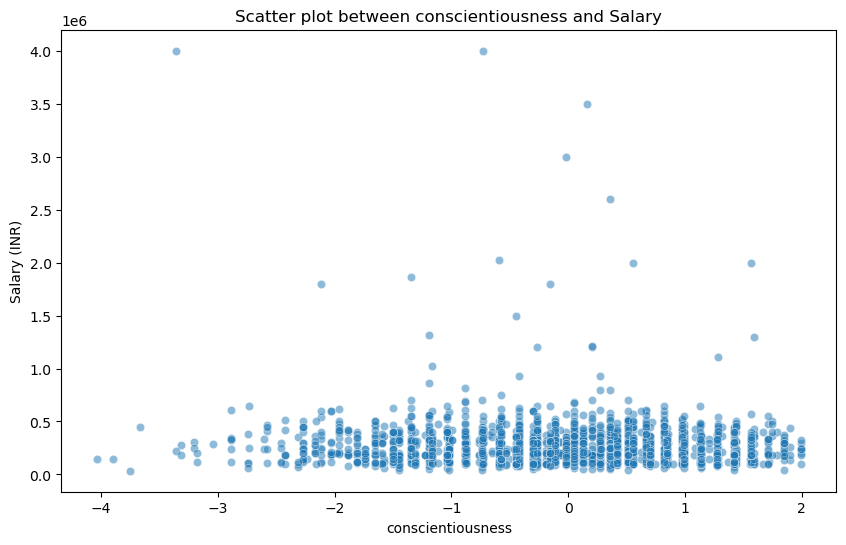

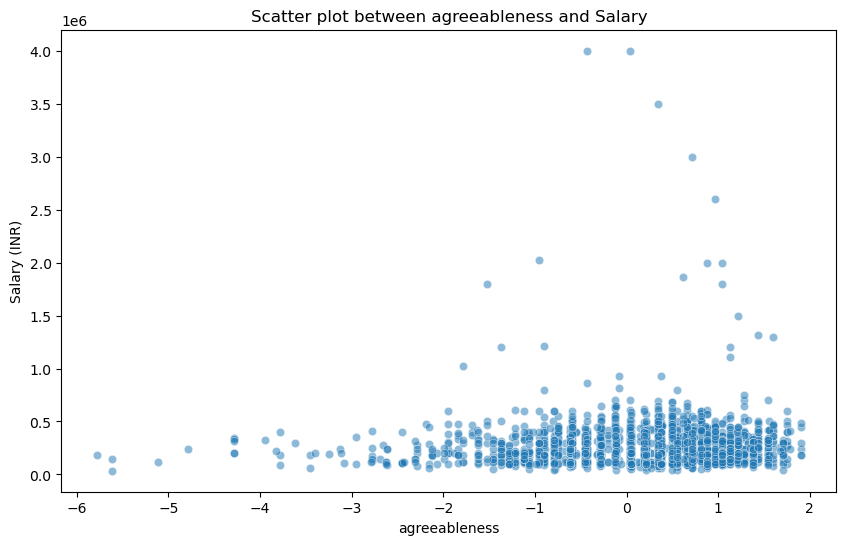

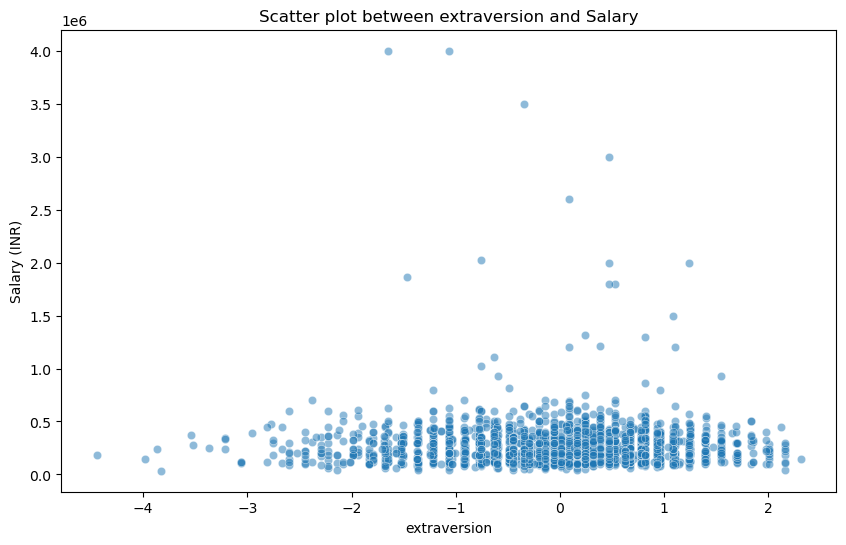

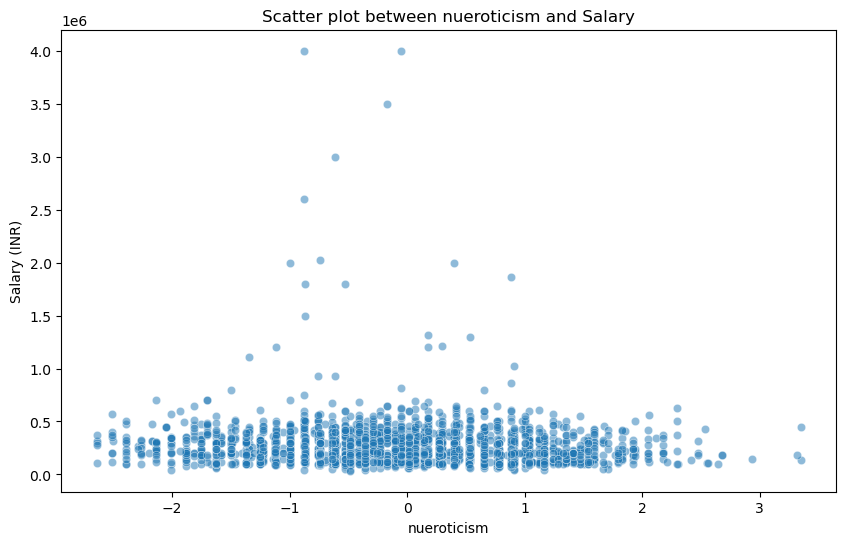

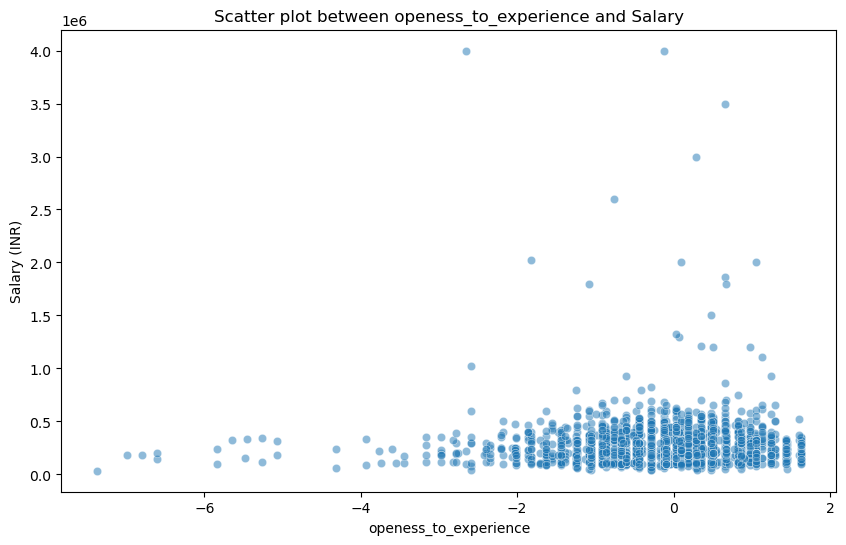

<Figure size 1000x600 with 0 Axes>

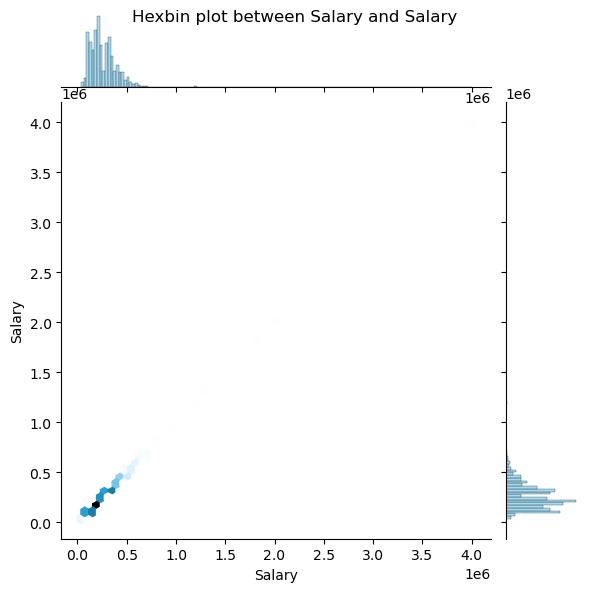

<Figure size 1000x600 with 0 Axes>

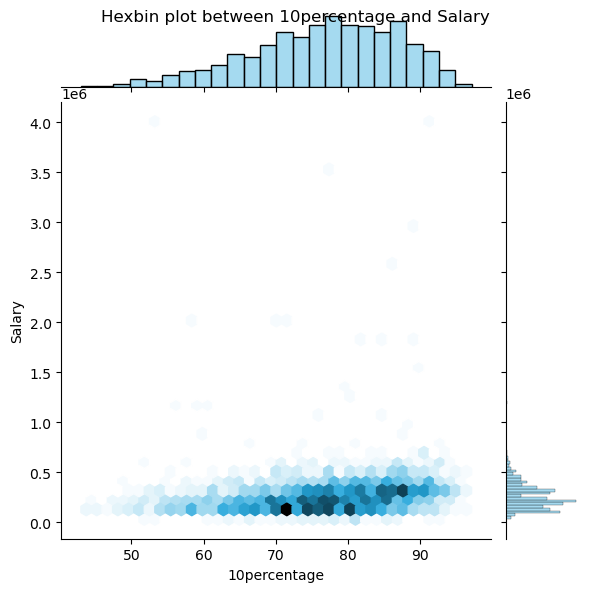

<Figure size 1000x600 with 0 Axes>

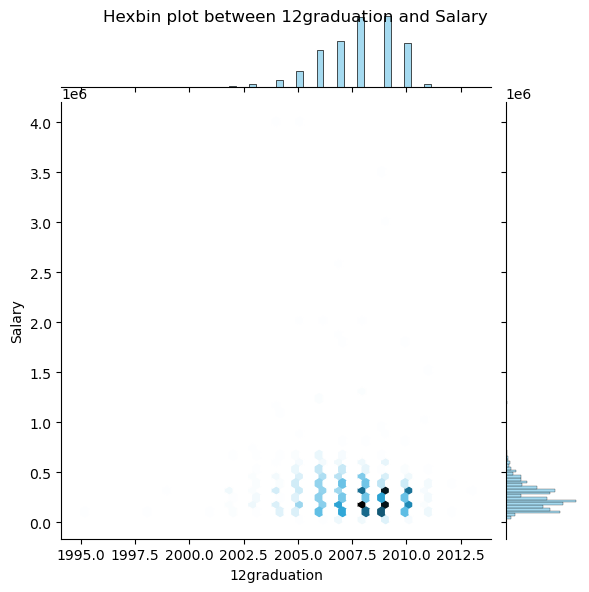

<Figure size 1000x600 with 0 Axes>

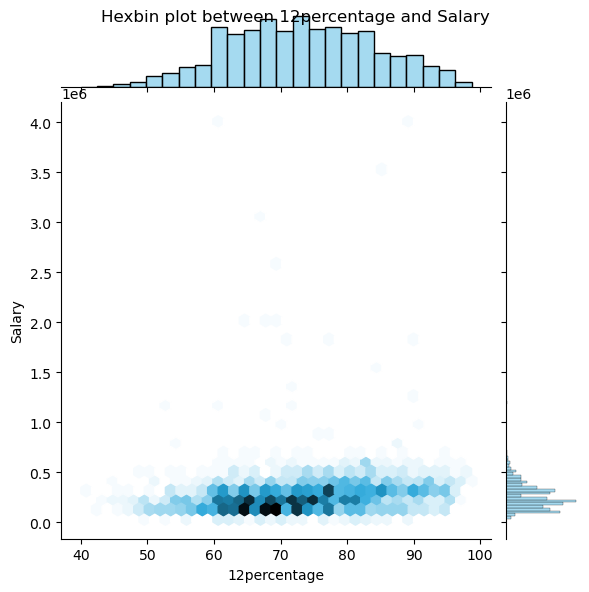

<Figure size 1000x600 with 0 Axes>

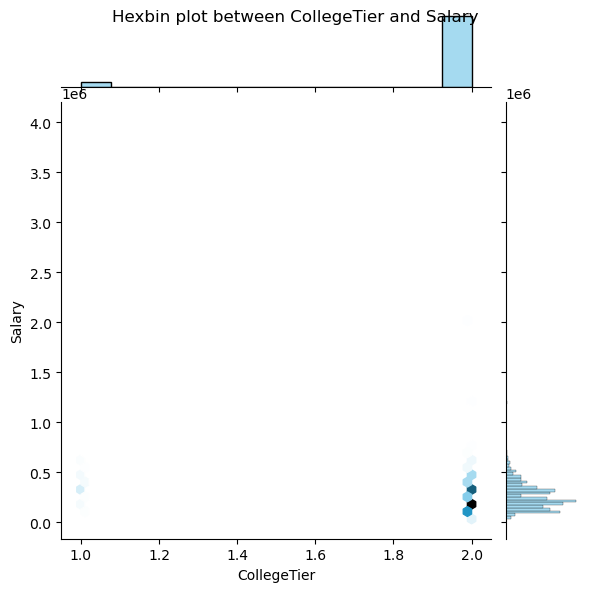

<Figure size 1000x600 with 0 Axes>

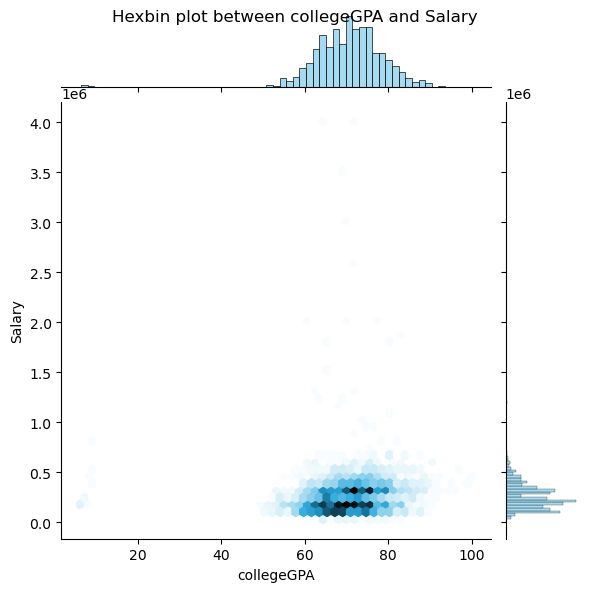

<Figure size 1000x600 with 0 Axes>

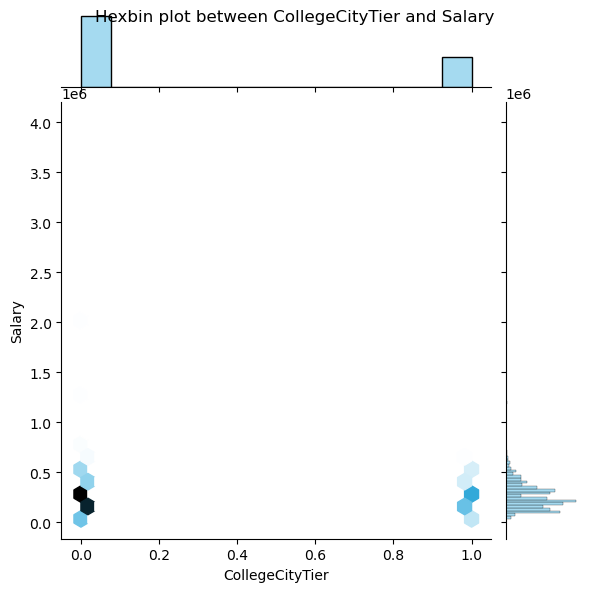

<Figure size 1000x600 with 0 Axes>

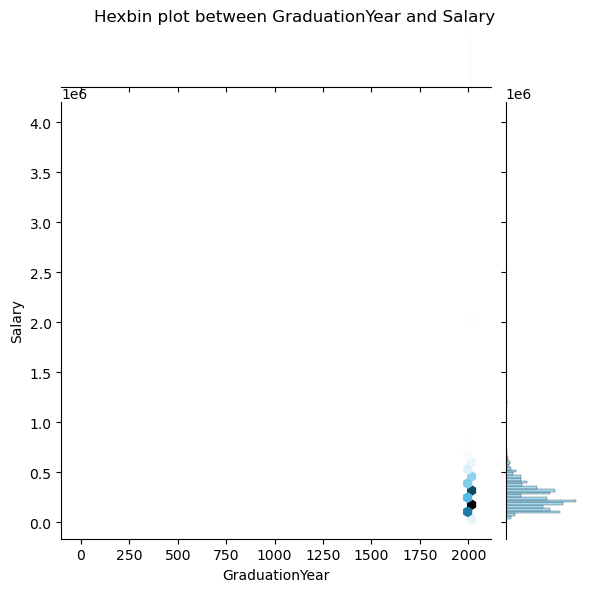

<Figure size 1000x600 with 0 Axes>

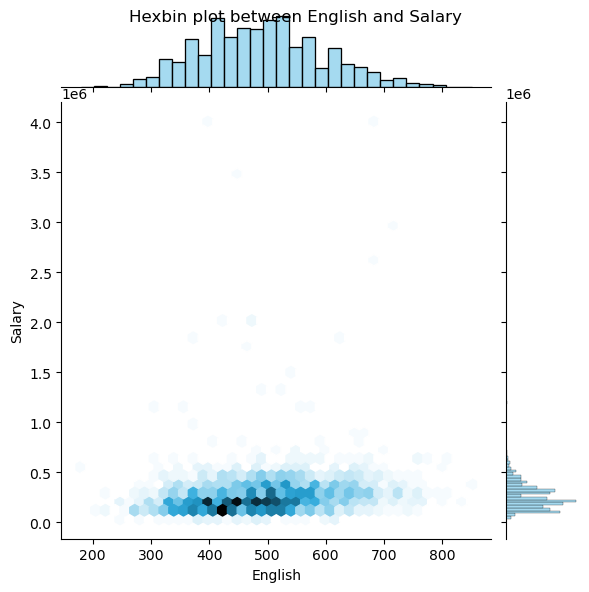

<Figure size 1000x600 with 0 Axes>

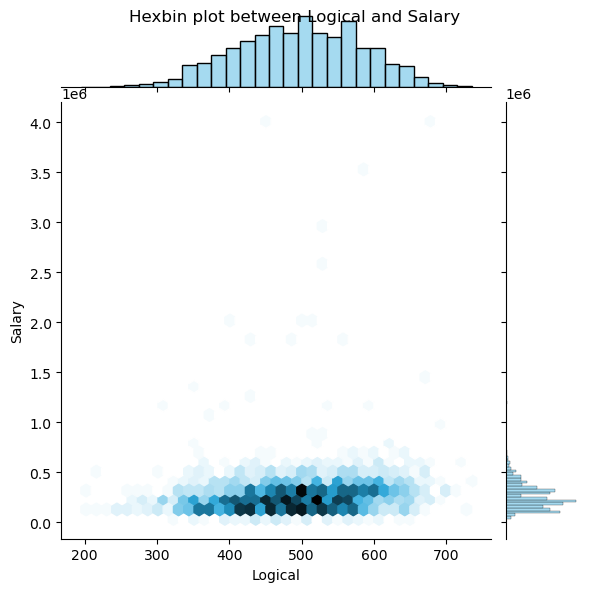

<Figure size 1000x600 with 0 Axes>

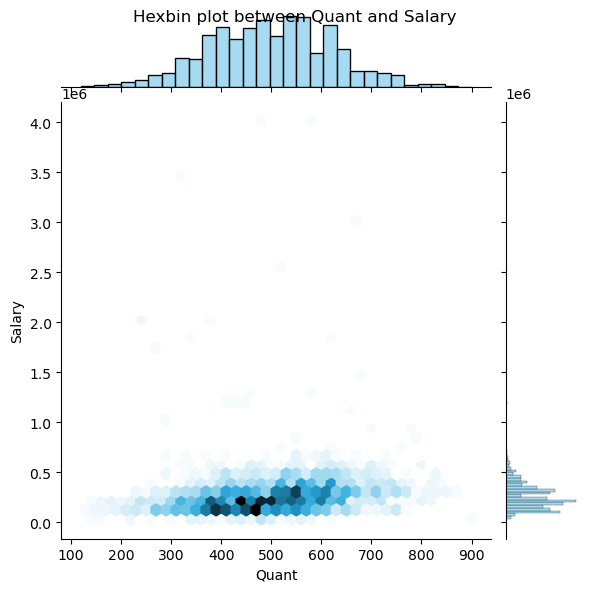

<Figure size 1000x600 with 0 Axes>

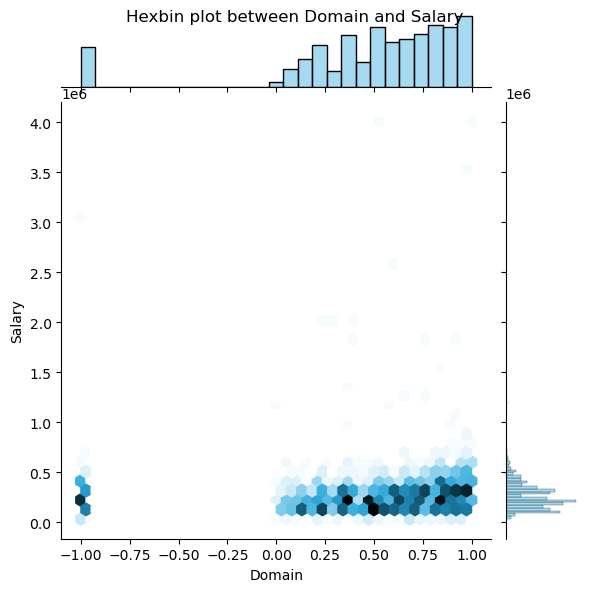

<Figure size 1000x600 with 0 Axes>

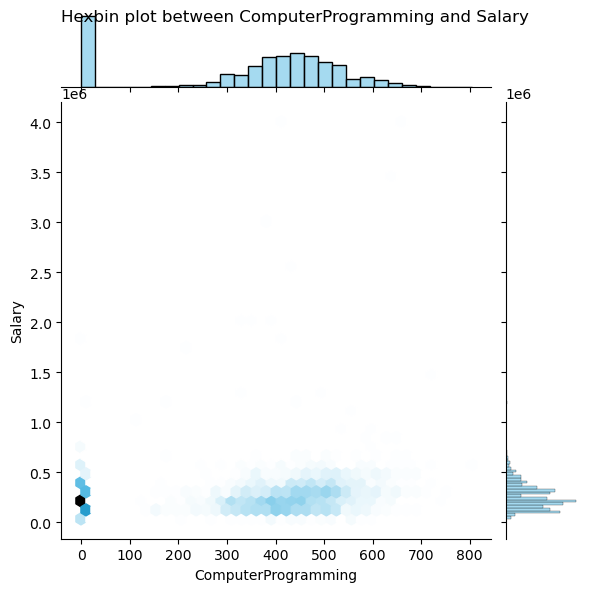

<Figure size 1000x600 with 0 Axes>

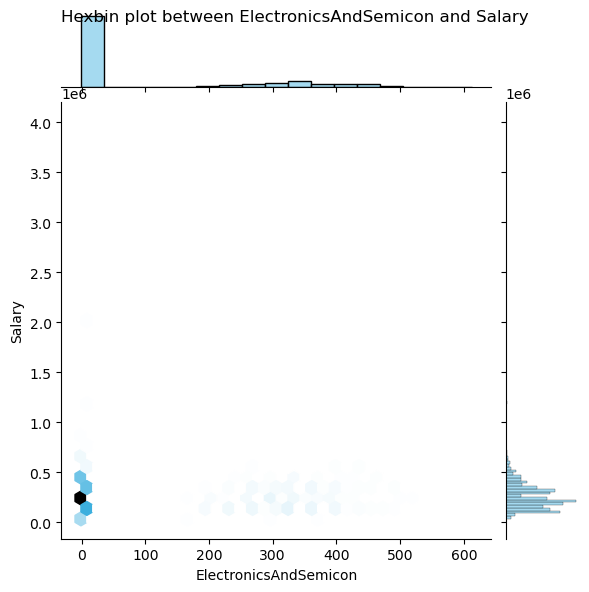

<Figure size 1000x600 with 0 Axes>

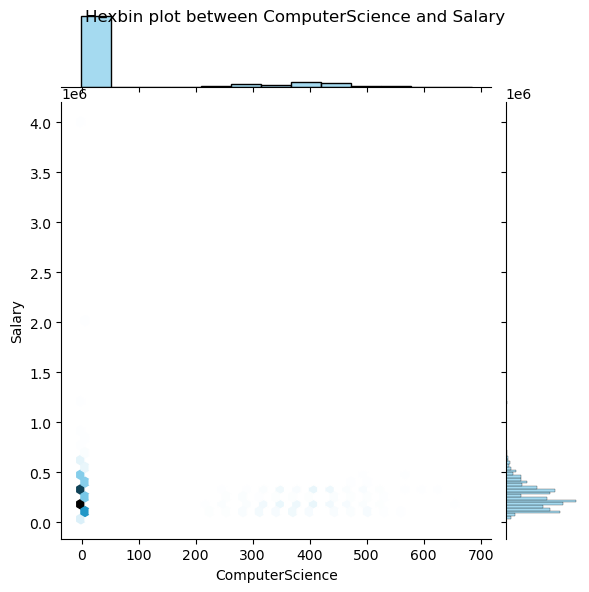

<Figure size 1000x600 with 0 Axes>

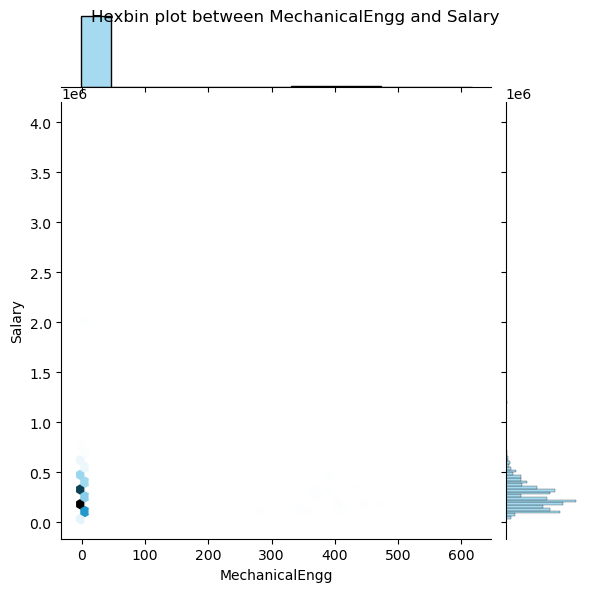

<Figure size 1000x600 with 0 Axes>

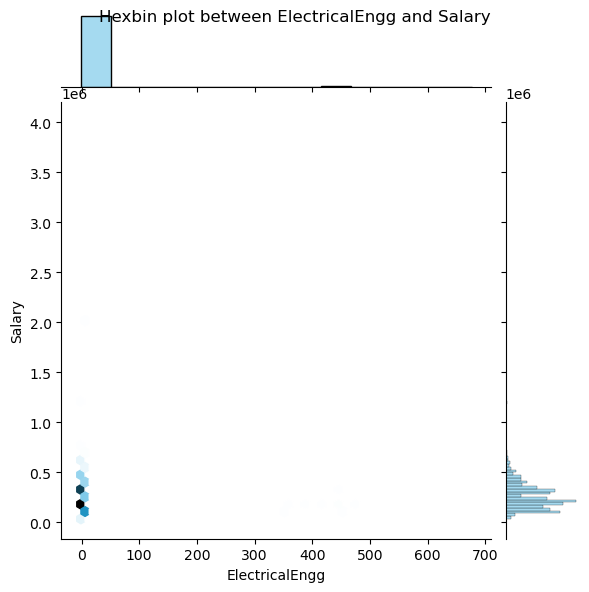

<Figure size 1000x600 with 0 Axes>

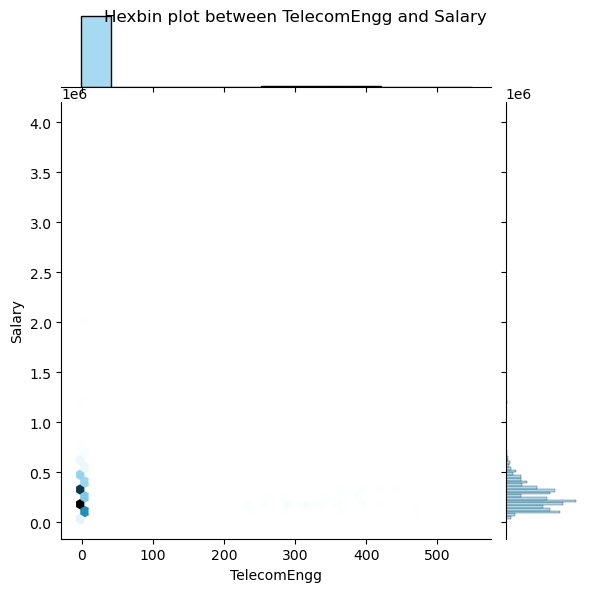

<Figure size 1000x600 with 0 Axes>

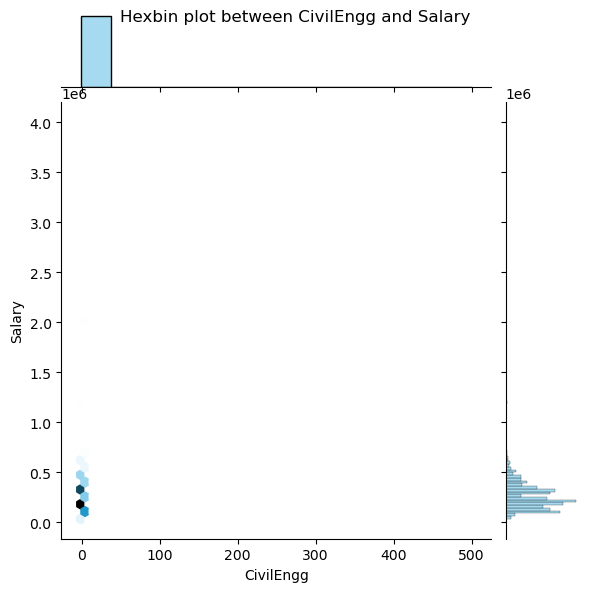

<Figure size 1000x600 with 0 Axes>

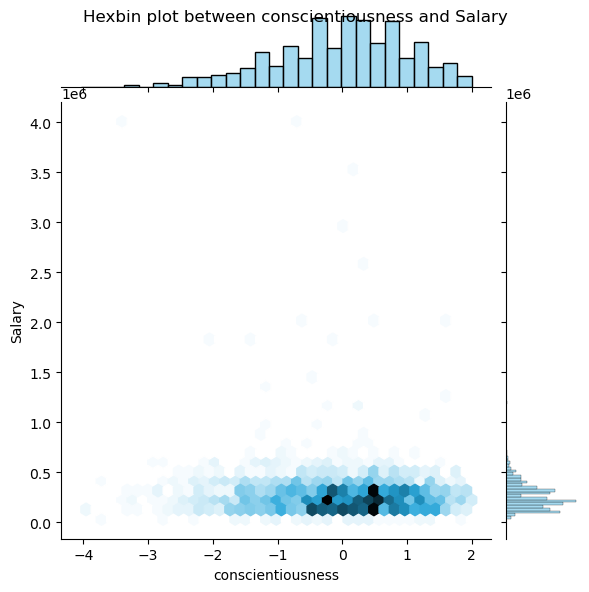

<Figure size 1000x600 with 0 Axes>

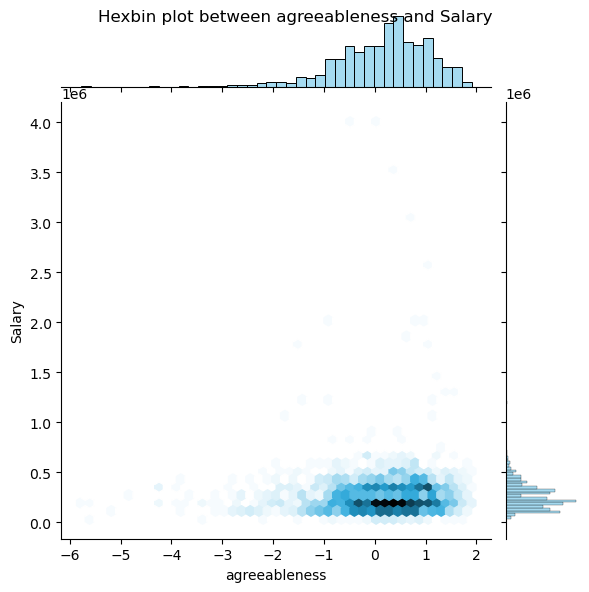

<Figure size 1000x600 with 0 Axes>

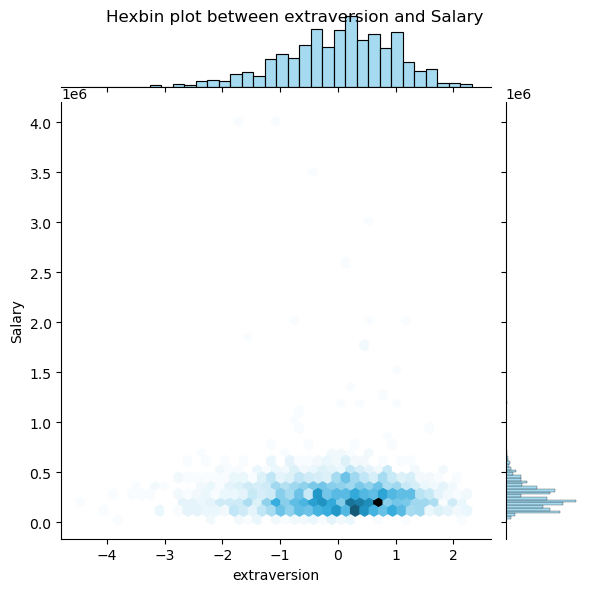

<Figure size 1000x600 with 0 Axes>

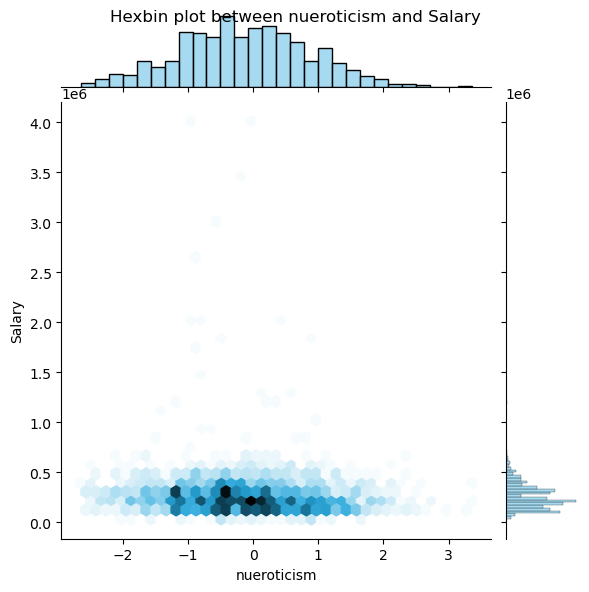

<Figure size 1000x600 with 0 Axes>

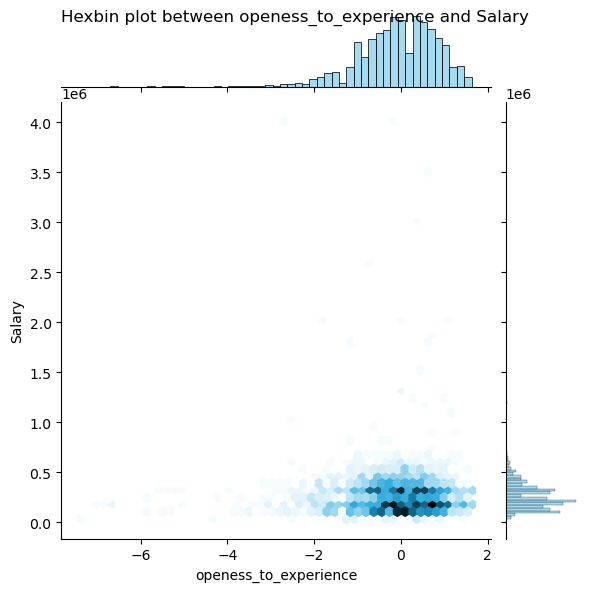

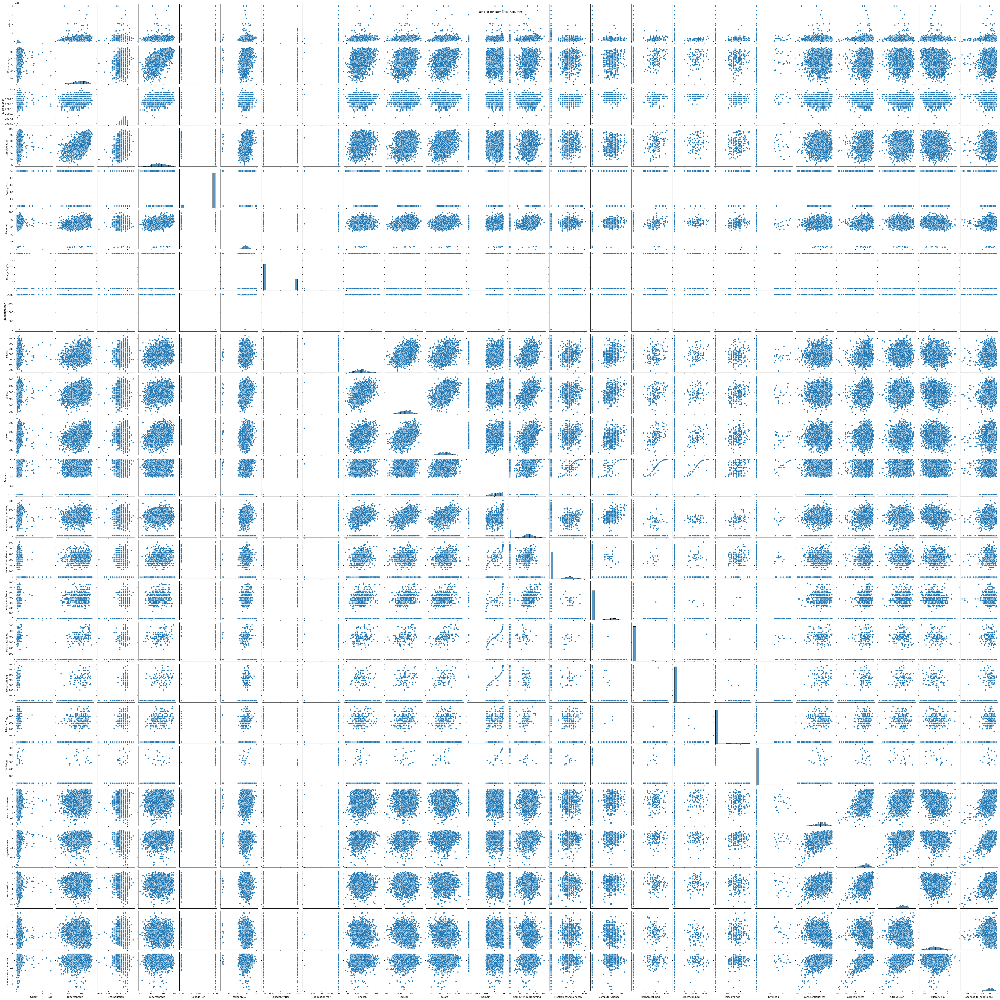

In [6]:
df_cleaned = df.drop(columns=columns_not_for_analysis)

# Bivariate Analysis - Relationships between Numerical Columns
numerical_columns = df_cleaned.select_dtypes(include=['float64', 'int64']).columns

# Scatter plots
for column in numerical_columns:
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x=column, y='Salary', data=df_cleaned, alpha=0.5)
    plt.title(f'Scatter plot between {column} and Salary')
    plt.xlabel(column)
    plt.ylabel('Salary (INR)')
    plt.show()

# Hexbin plots
for column in numerical_columns:
    plt.figure(figsize=(10, 6))
    sns.jointplot(x=column, y='Salary', data=df_cleaned, kind='hex', color='skyblue')
    plt.suptitle(f'Hexbin plot between {column} and Salary')
    plt.show()

# Pair plots for numerical columns
sns.pairplot(df_cleaned[numerical_columns])
plt.suptitle('Pair plot for Numerical Columns')
plt.show()

C:\Users\SIVA KASHYAP\AppData\Local\Temp\ipykernel_24596\513216515.py:6: FutureWarning: Passing `palette` without assigning `hue` is deprecated.
  sns.swarmplot(x=column, y='Salary', data=df_cleaned, palette='viridis')
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 55.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 89.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarni

C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 14.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


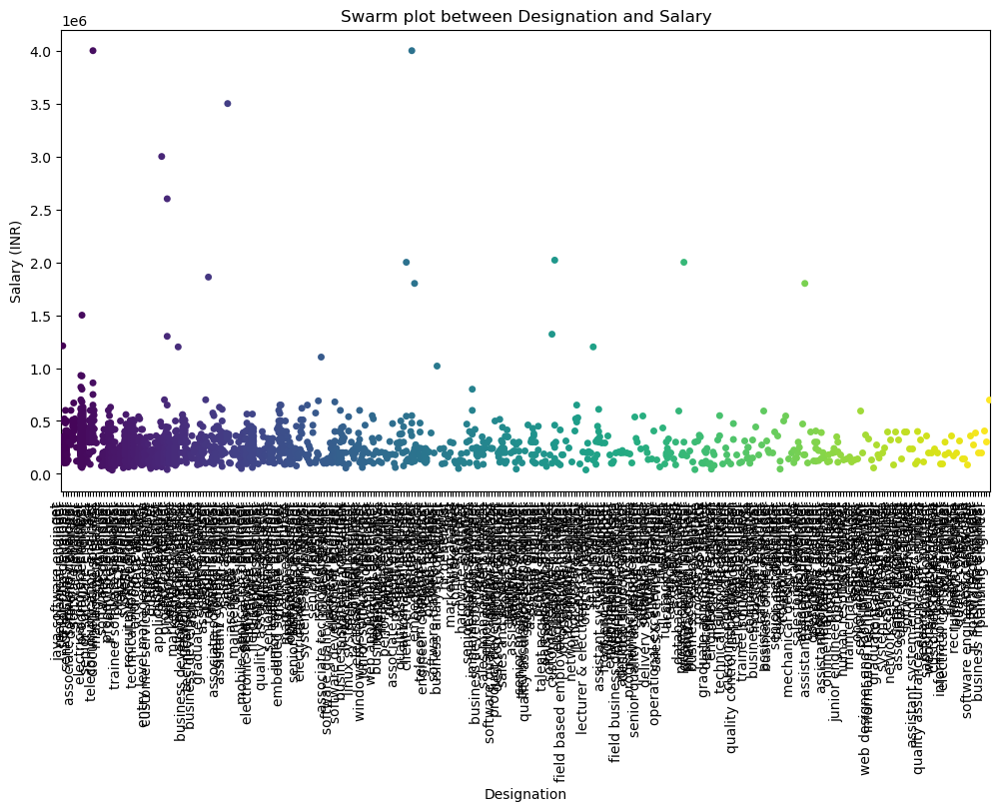

C:\Users\SIVA KASHYAP\AppData\Local\Temp\ipykernel_24596\513216515.py:6: FutureWarning: Passing `palette` without assigning `hue` is deprecated.
  sns.swarmplot(x=column, y='Salary', data=df_cleaned, palette='viridis')
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 33.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 95.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 93.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarni

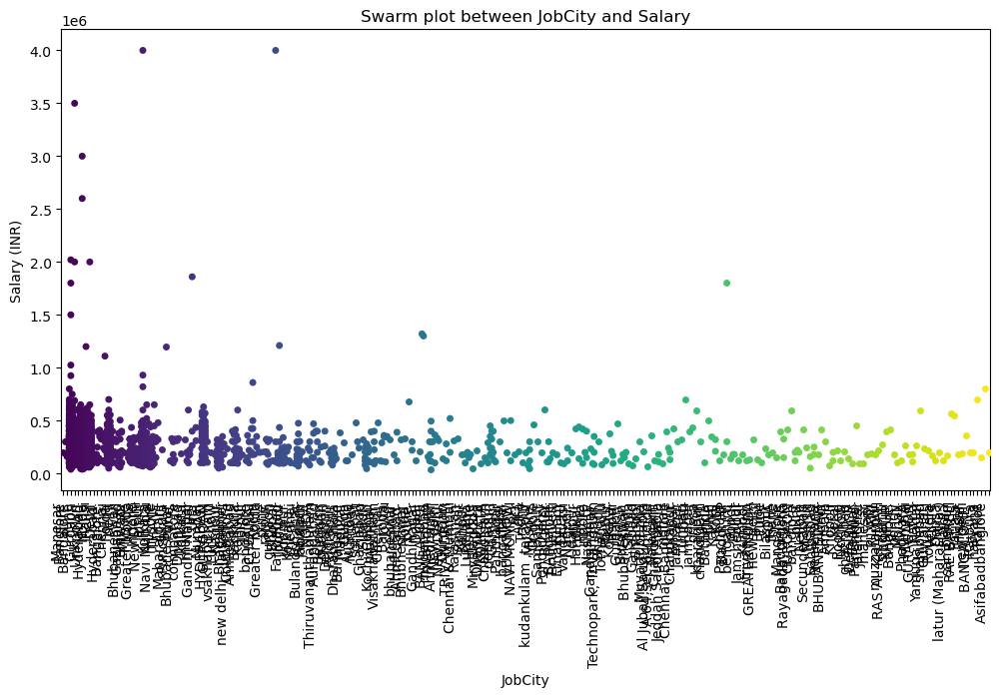

C:\Users\SIVA KASHYAP\AppData\Local\Temp\ipykernel_24596\513216515.py:6: FutureWarning: Passing `palette` without assigning `hue` is deprecated.
  sns.swarmplot(x=column, y='Salary', data=df_cleaned, palette='viridis')
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 53.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 10.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 70.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarni

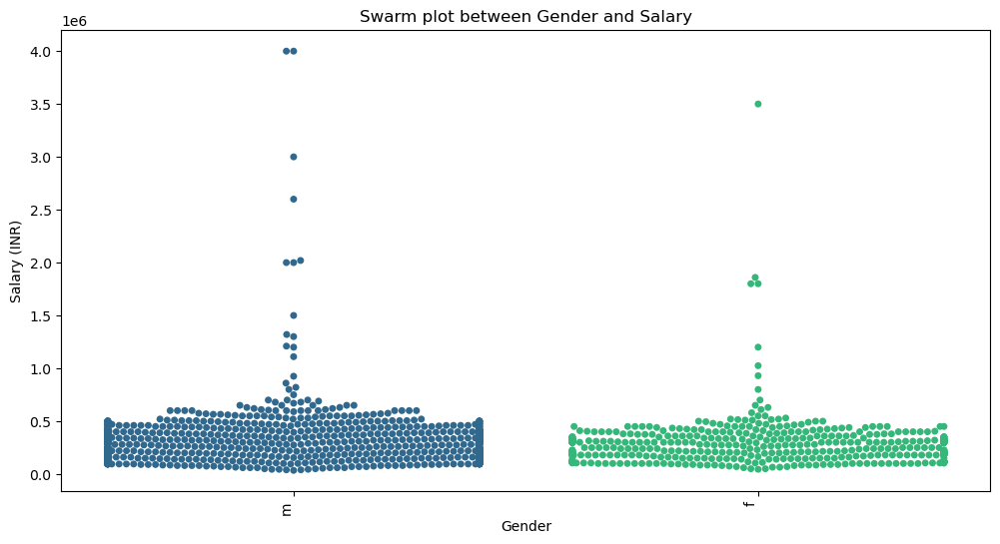

C:\Users\SIVA KASHYAP\AppData\Local\Temp\ipykernel_24596\513216515.py:6: FutureWarning: Passing `palette` without assigning `hue` is deprecated.
  sns.swarmplot(x=column, y='Salary', data=df_cleaned, palette='viridis')
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 98.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 98.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 76.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarni

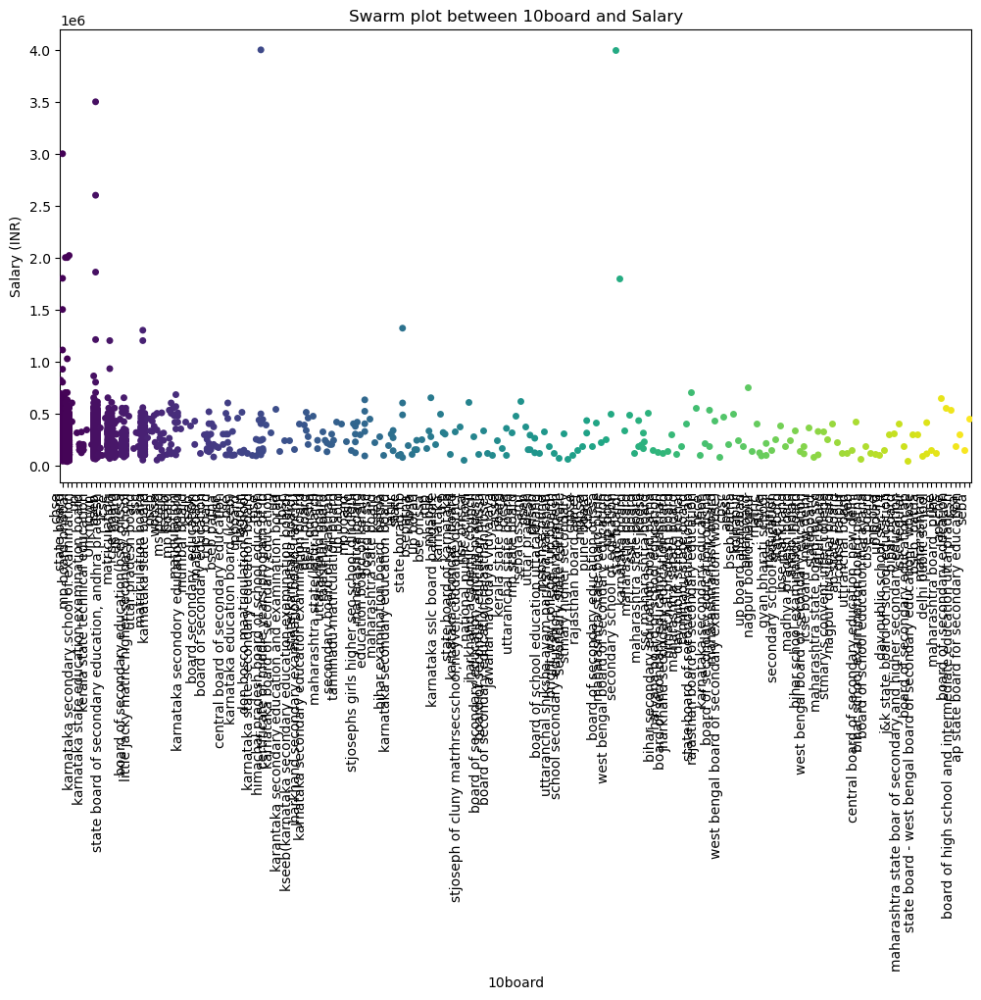

C:\Users\SIVA KASHYAP\AppData\Local\Temp\ipykernel_24596\513216515.py:6: FutureWarning: Passing `palette` without assigning `hue` is deprecated.
  sns.swarmplot(x=column, y='Salary', data=df_cleaned, palette='viridis')
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 98.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 98.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 45.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarni

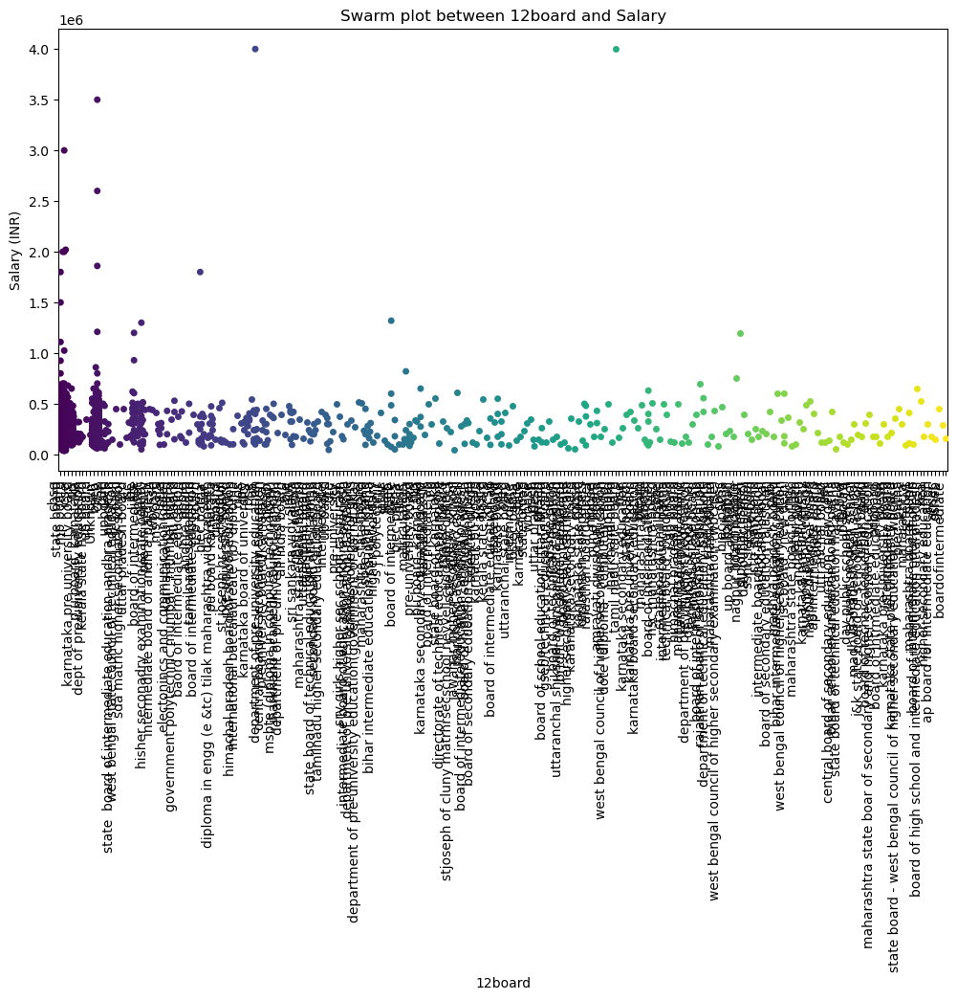

C:\Users\SIVA KASHYAP\AppData\Local\Temp\ipykernel_24596\513216515.py:6: FutureWarning: Passing `palette` without assigning `hue` is deprecated.
  sns.swarmplot(x=column, y='Salary', data=df_cleaned, palette='viridis')
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 82.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 10.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 85.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarni

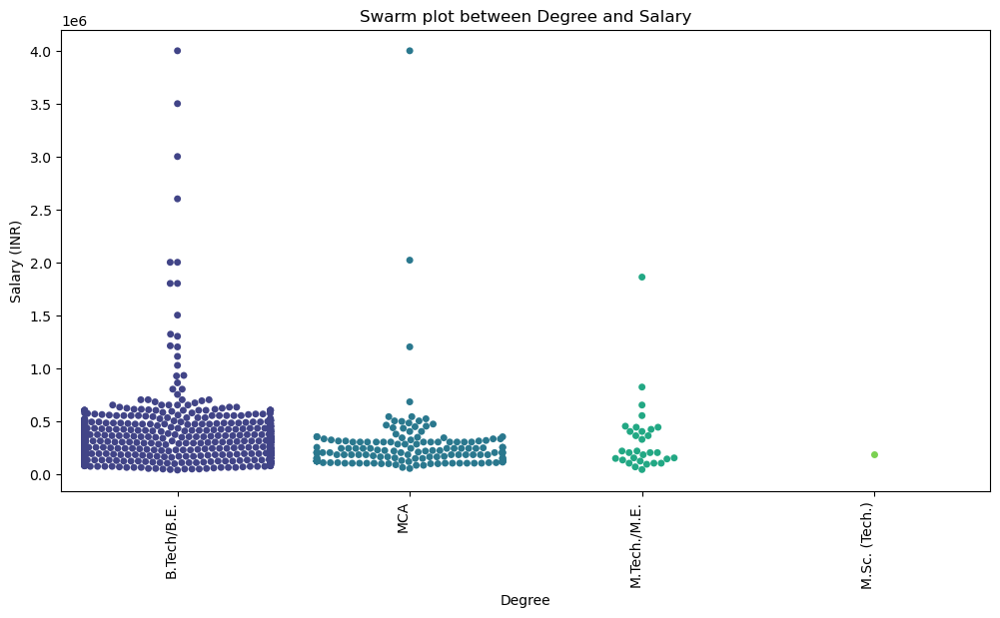

C:\Users\SIVA KASHYAP\AppData\Local\Temp\ipykernel_24596\513216515.py:6: FutureWarning: Passing `palette` without assigning `hue` is deprecated.
  sns.swarmplot(x=column, y='Salary', data=df_cleaned, palette='viridis')
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 93.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 92.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 77.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarni

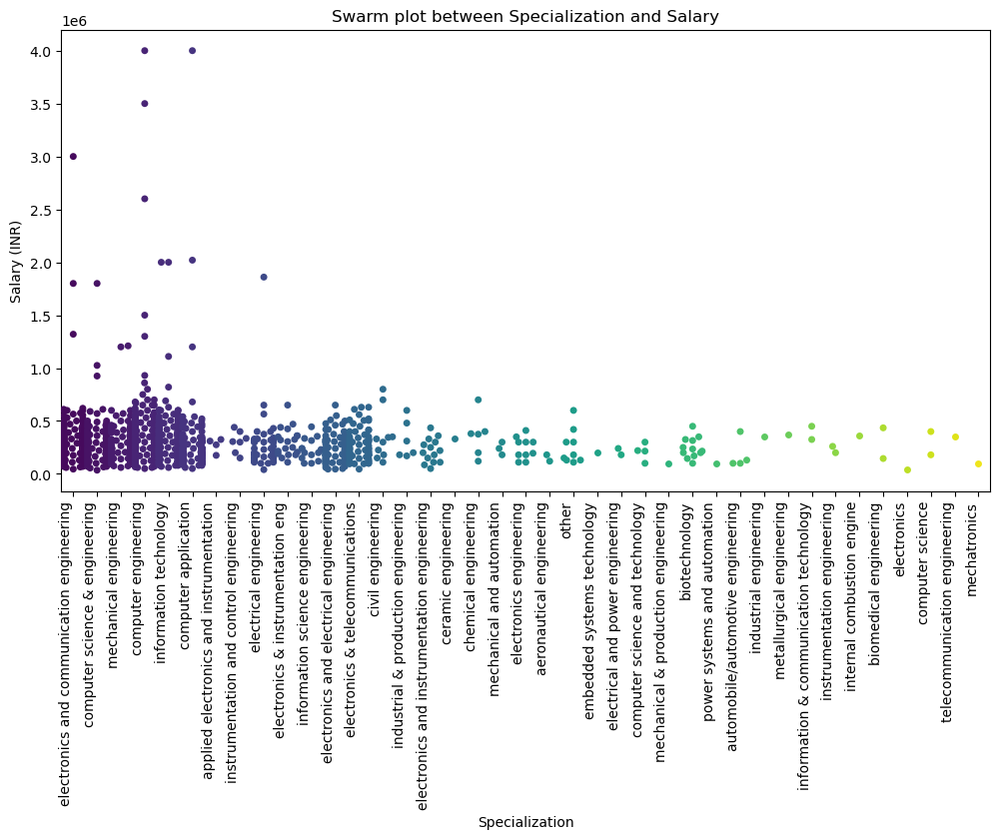

C:\Users\SIVA KASHYAP\AppData\Local\Temp\ipykernel_24596\513216515.py:6: FutureWarning: Passing `palette` without assigning `hue` is deprecated.
  sns.swarmplot(x=column, y='Salary', data=df_cleaned, palette='viridis')
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 91.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 80.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 82.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\SIVA KASHYAP\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarni

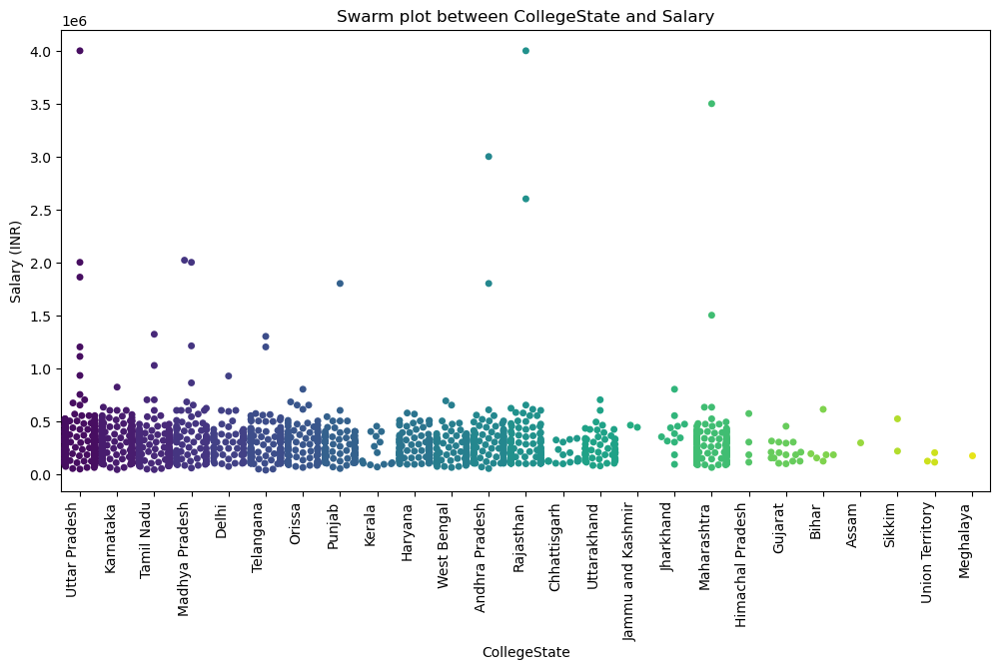

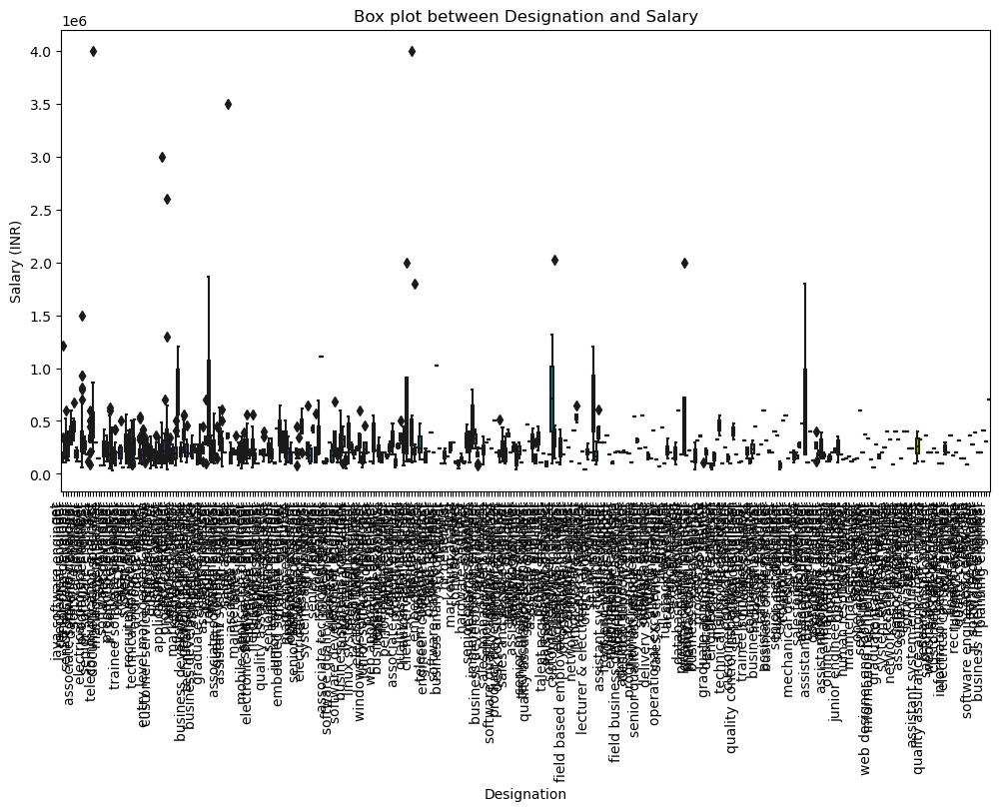

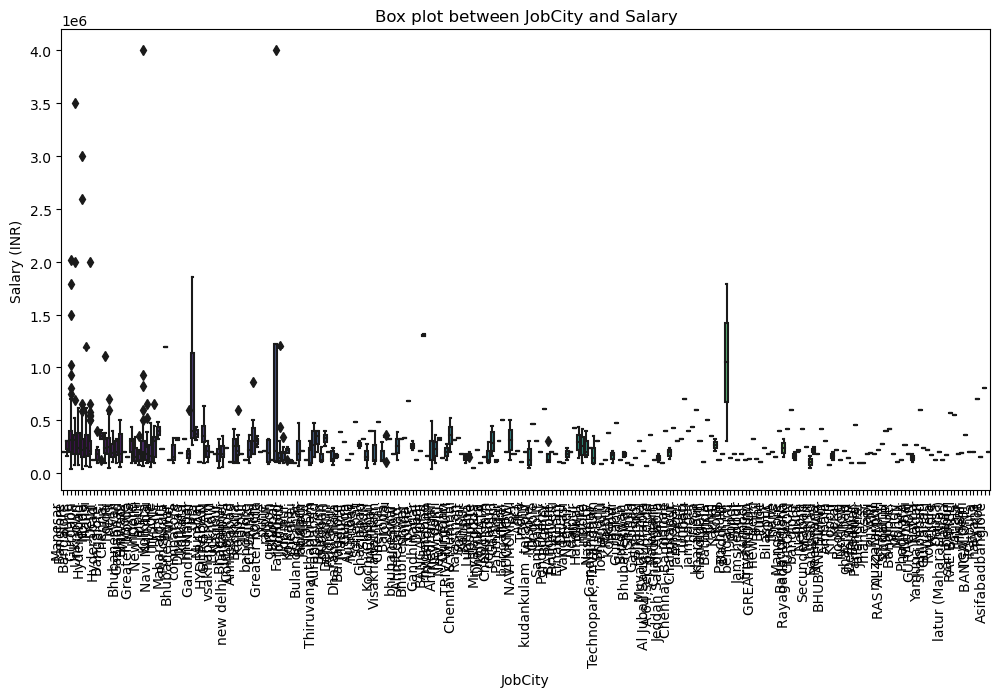

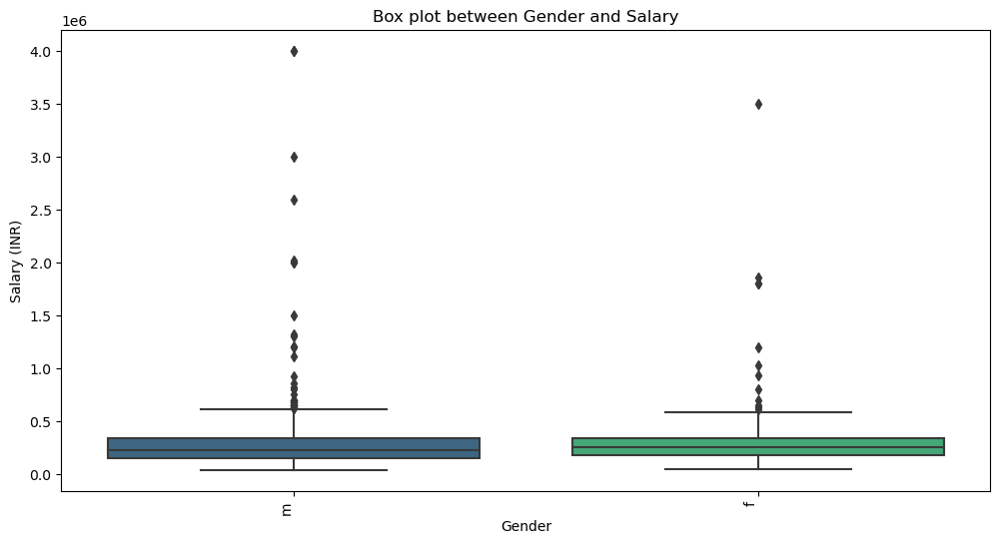

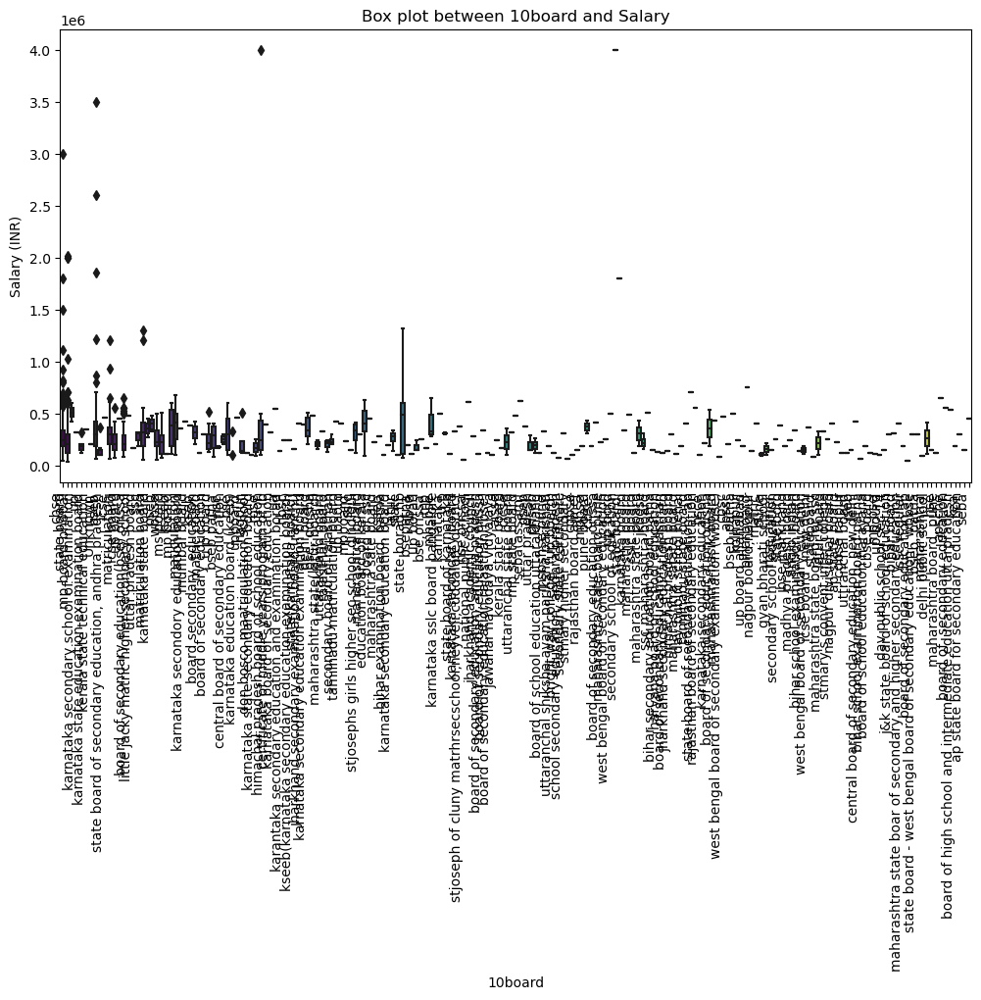

...

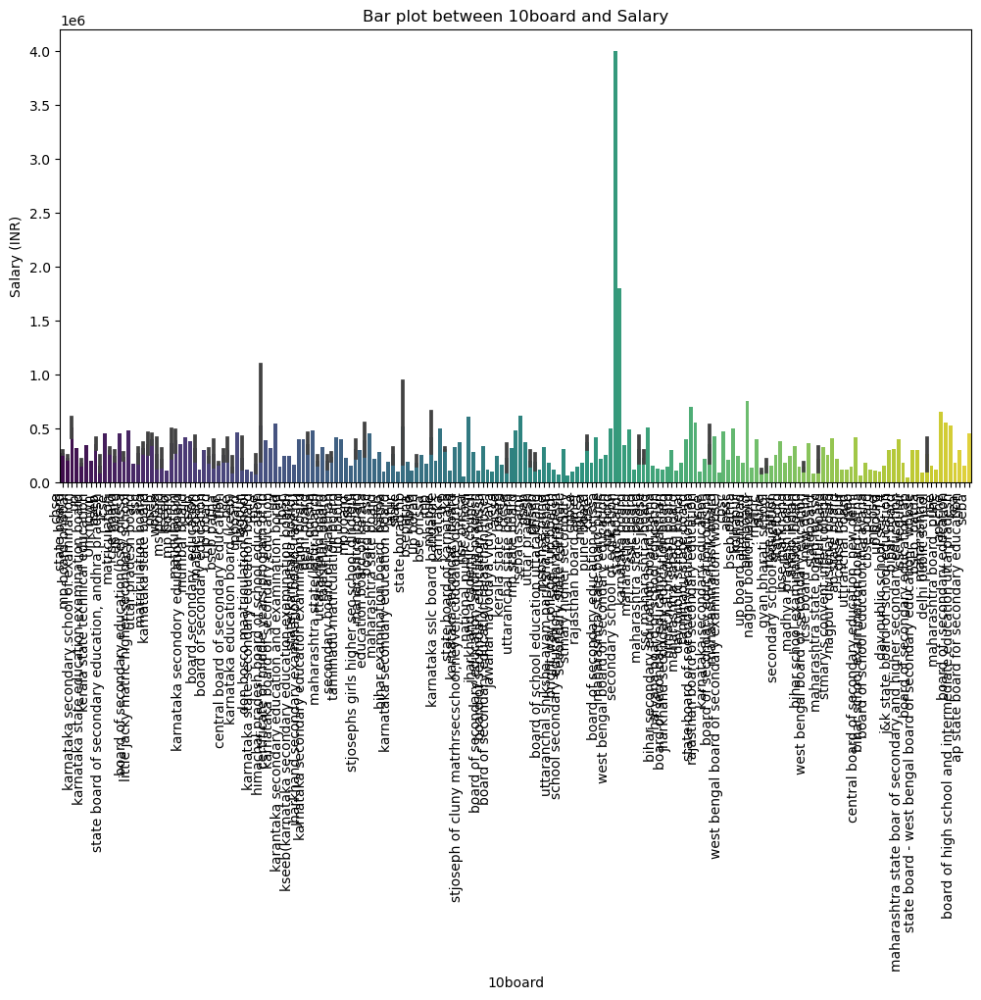

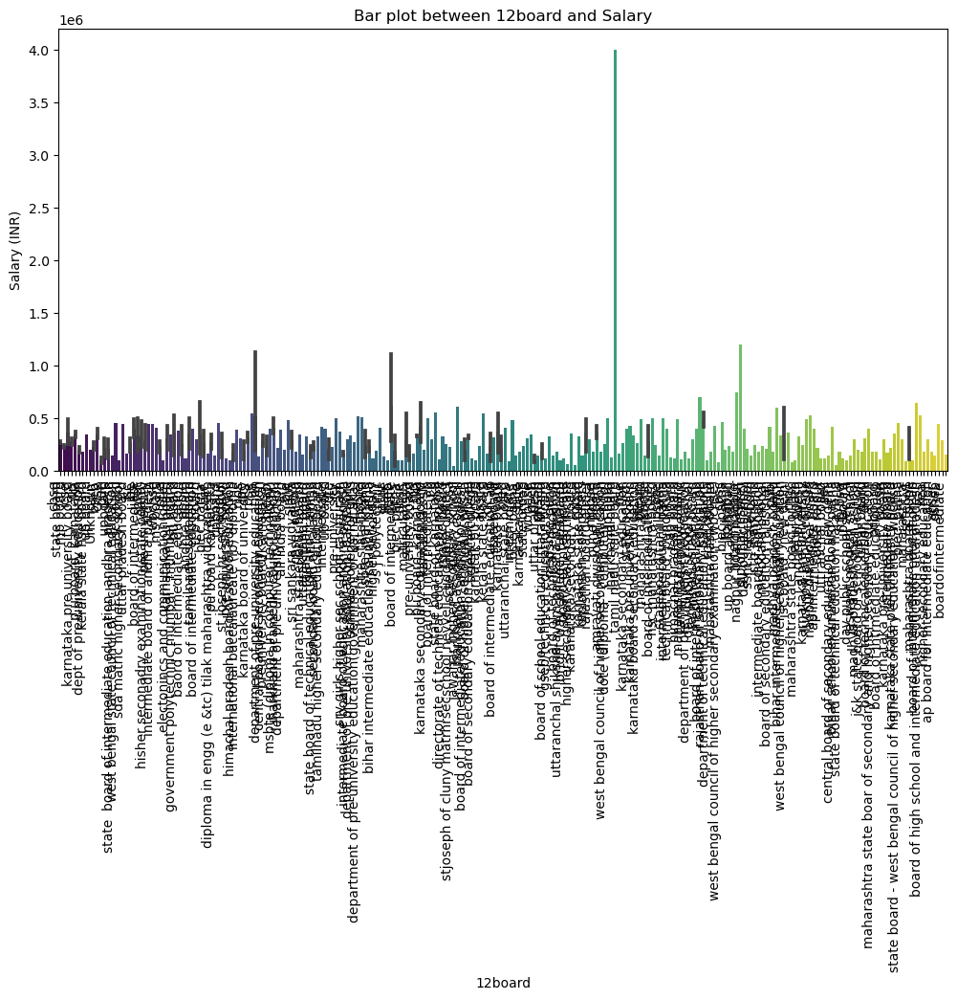

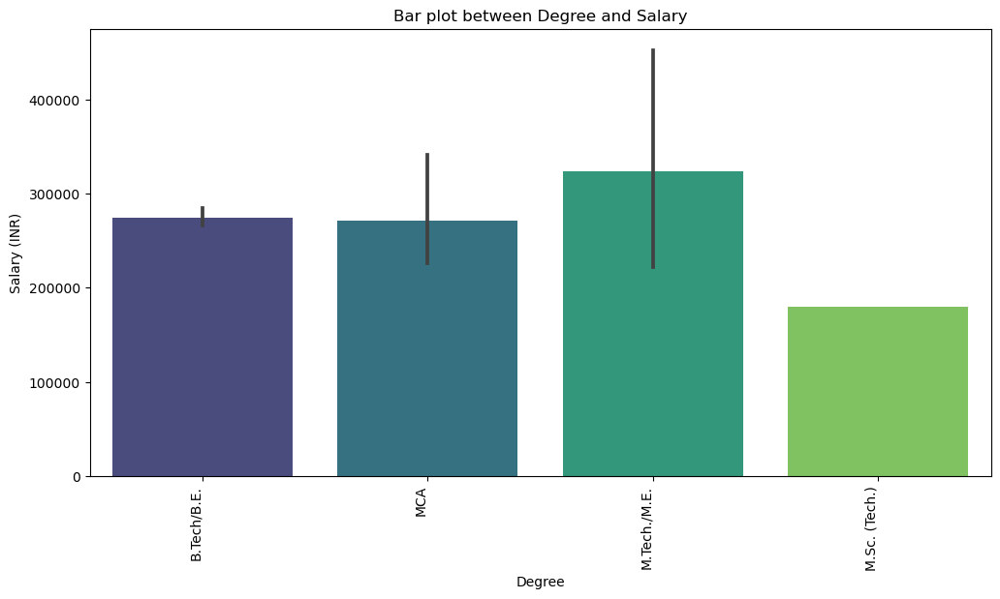

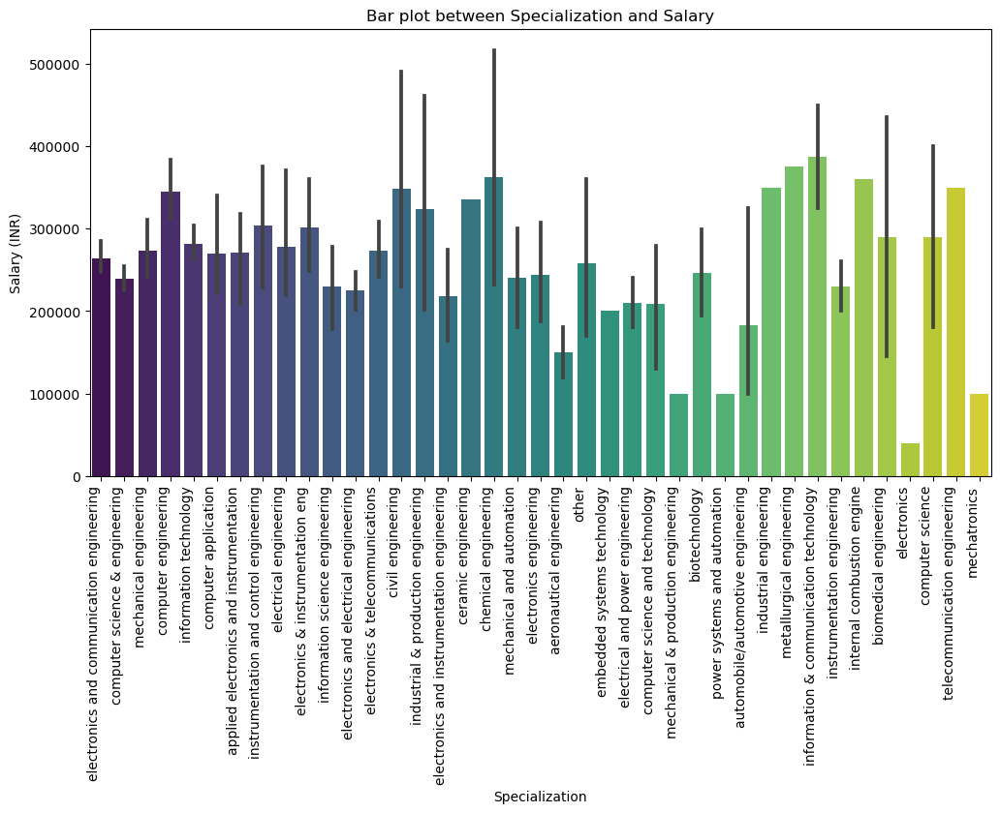

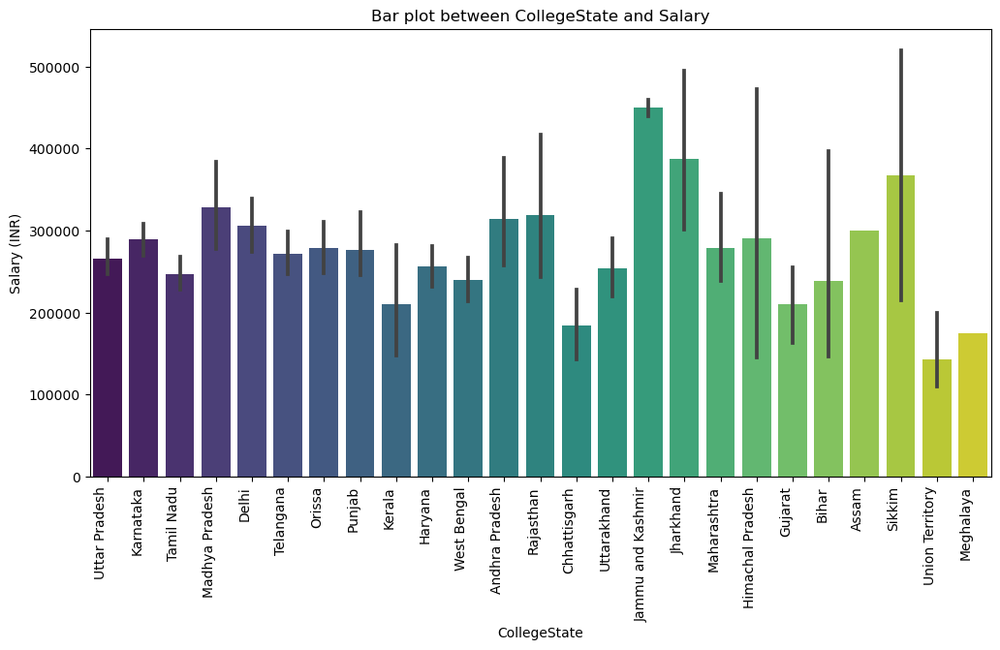

<Figure size 1200x600 with 0 Axes>

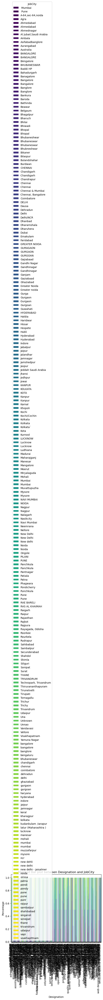

<Figure size 1200x600 with 0 Axes>

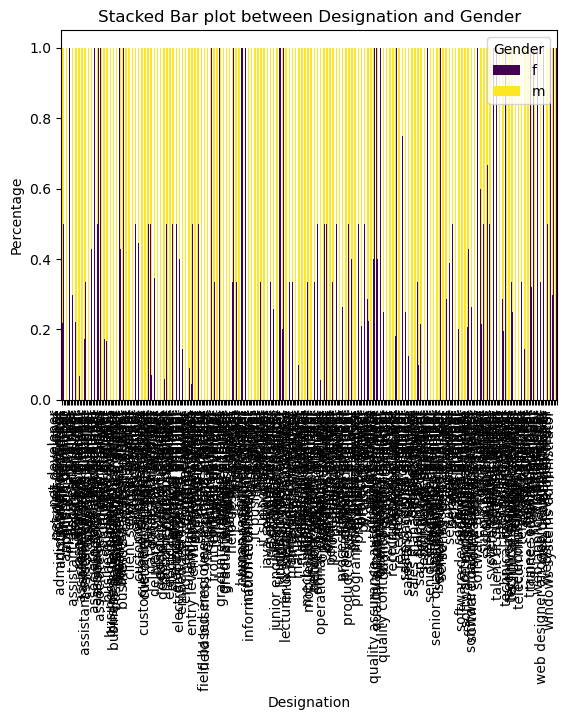

<Figure size 1200x600 with 0 Axes>

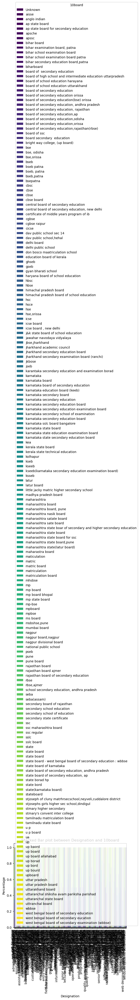

<Figure size 1200x600 with 0 Axes>

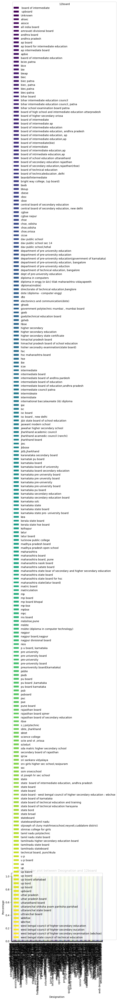

<Figure size 1200x600 with 0 Axes>

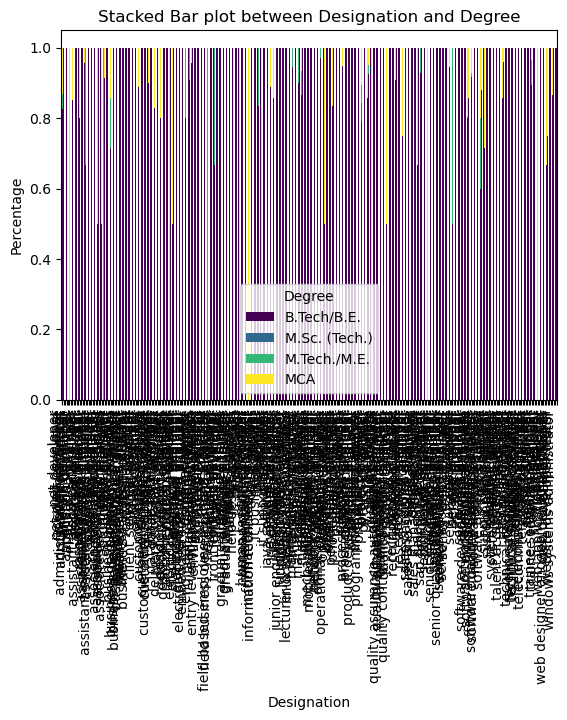

<Figure size 1200x600 with 0 Axes>

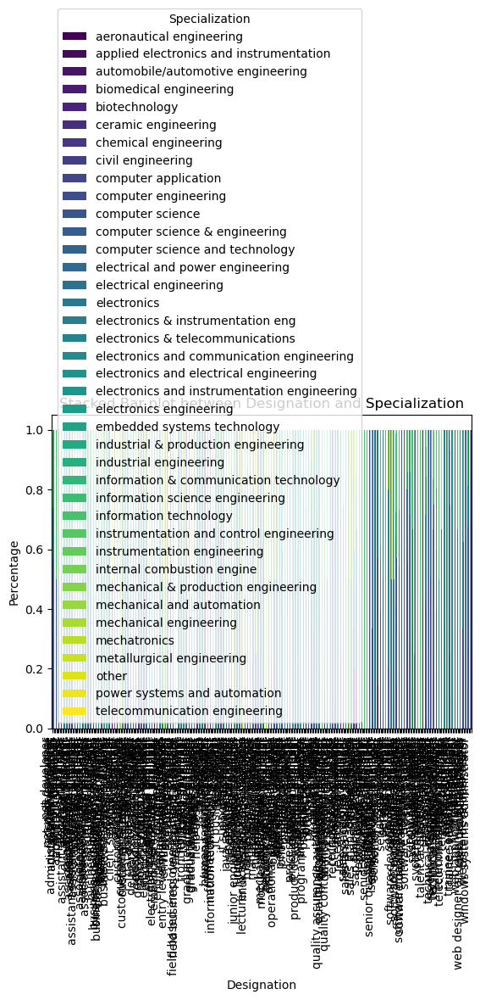

<Figure size 1200x600 with 0 Axes>

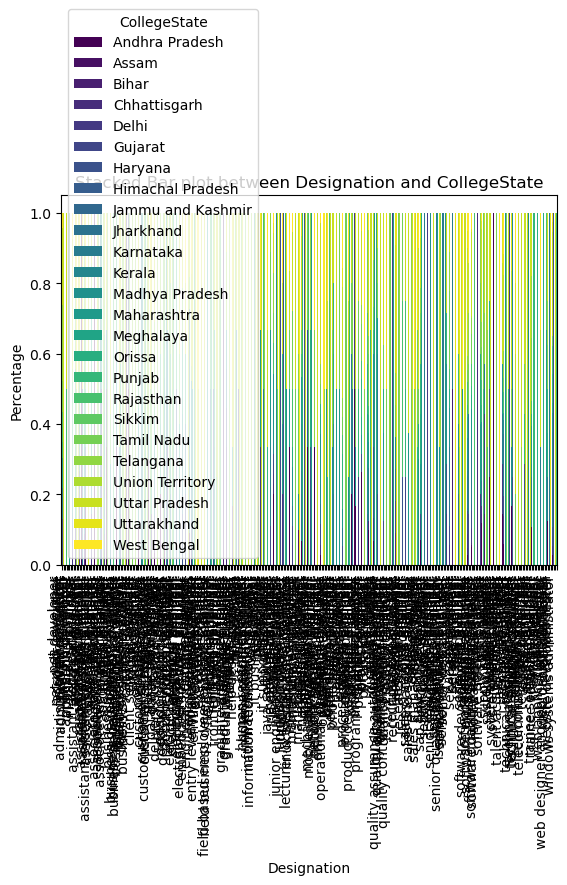

<Figure size 1200x600 with 0 Axes>

KeyboardInterrupt: 

In [8]:
categorical_columns = df_cleaned.select_dtypes(include=['object']).columns

# Swarm plots
for column in categorical_columns:
    plt.figure(figsize=(12, 6))
    sns.swarmplot(x=column, y='Salary', data=df_cleaned, palette='viridis')
    plt.title(f'Swarm plot between {column} and Salary')
    plt.xlabel(column)
    plt.ylabel('Salary (INR)')
    plt.xticks(rotation=90, ha='right')
    plt.show()

# Box plots
for column in categorical_columns:
    plt.figure(figsize=(12, 6))
    sns.boxplot(x=column, y='Salary', data=df_cleaned, palette='viridis')
    plt.title(f'Box plot between {column} and Salary')
    plt.xlabel(column)
    plt.ylabel('Salary (INR)')
    plt.xticks(rotation=90, ha='right')
    plt.show()

# Bar plots
for column in categorical_columns:
    plt.figure(figsize=(12, 6))
    sns.barplot(x=column, y='Salary', data=df_cleaned, palette='viridis')
    plt.title(f'Bar plot between {column} and Salary')
    plt.xlabel(column)
    plt.ylabel('Salary (INR)')
    plt.xticks(rotation=90, ha='right')
    plt.show()

# Bivariate Analysis - Relationships between Categorical Columns
# Stacked bar plots
for col1 in categorical_columns:
    for col2 in categorical_columns:
        if col1 != col2:
            plt.figure(figsize=(12, 6))
            df_cross = pd.crosstab(df_cleaned[col1], df_cleaned[col2])
            df_cross.div(df_cross.sum(1).astype(float), axis=0).plot(kind="bar", stacked=True, colormap='viridis')
            plt.title(f'Stacked Bar plot between {col1} and {col2}')
            plt.xlabel(col1)
            plt.ylabel('Percentage')
            plt.xticks(rotation=90, ha='right')
            plt.show()

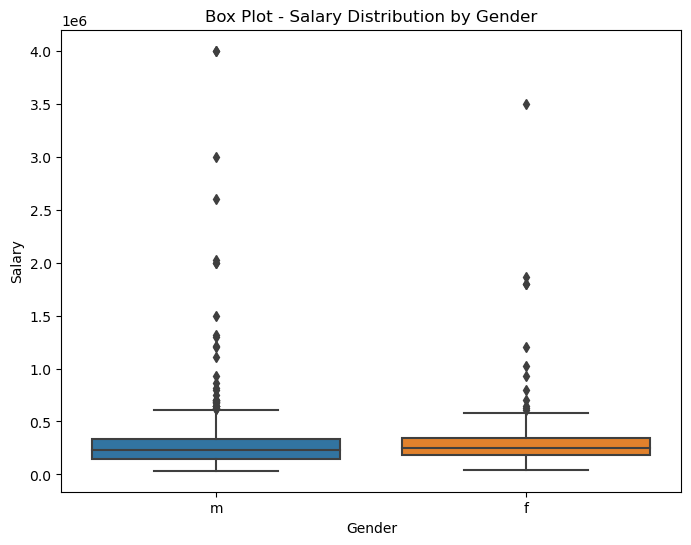

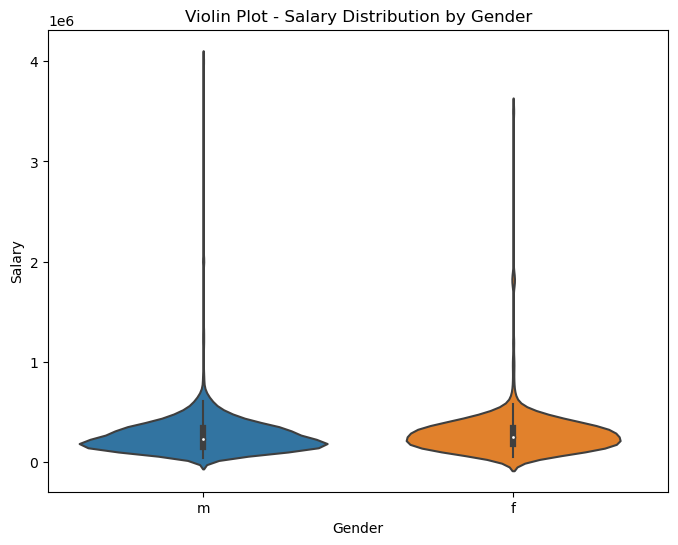

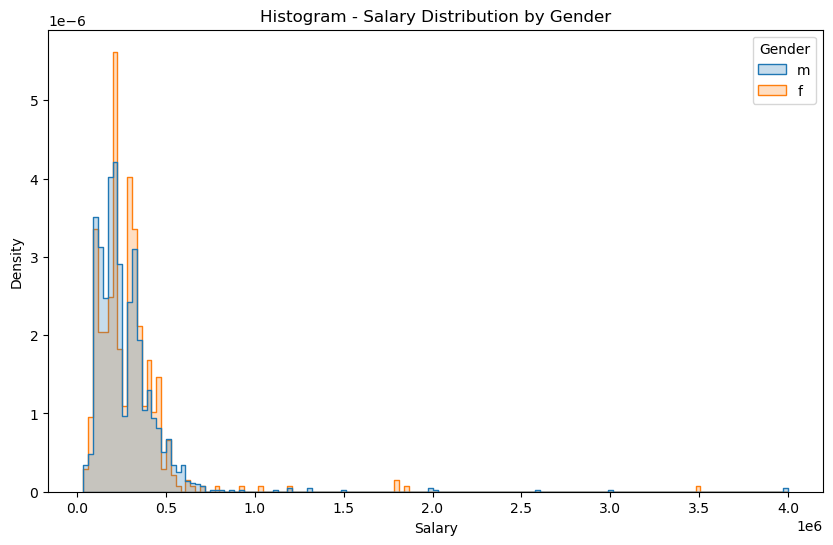

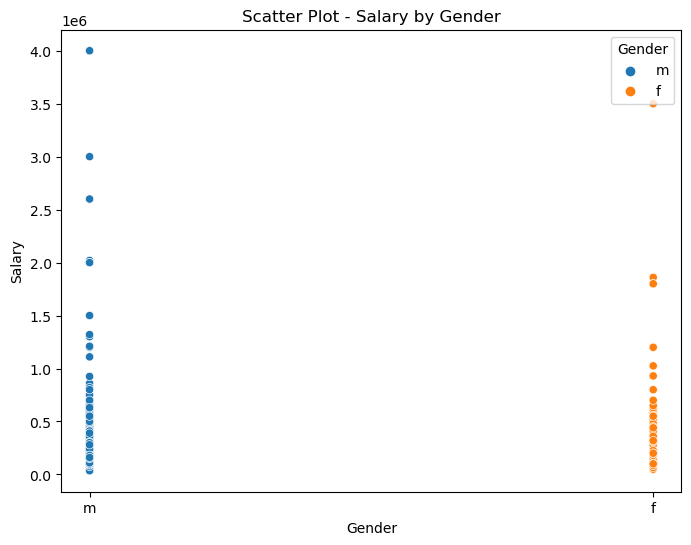

Correlation Coefficient (Point-Biserial): -0.019095363166830442


In [9]:

# Box Plot
plt.figure(figsize=(8, 6))
sns.boxplot(x='Gender', y='Salary', data=df)
plt.title('Box Plot - Salary Distribution by Gender')
plt.show()

# Violin Plot
plt.figure(figsize=(8, 6))
sns.violinplot(x='Gender', y='Salary', data=df)
plt.title('Violin Plot - Salary Distribution by Gender')
plt.show()

# Histograms
plt.figure(figsize=(10, 6))
sns.histplot(data=df, x='Salary', hue='Gender', element='step', stat='density', common_norm=False)
plt.title('Histogram - Salary Distribution by Gender')
plt.show()

# Scatter Plot
plt.figure(figsize=(8, 6))
sns.scatterplot(x='Gender', y='Salary', data=df, hue='Gender')
plt.title('Scatter Plot - Salary by Gender')
plt.show()

# Correlation Coefficient (Point-Biserial)
correlation_coefficient = df['Salary'].corr(df['Gender'].apply(lambda x: 1 if x == 'm' else 0))

print(f'Correlation Coefficient (Point-Biserial): {correlation_coefficient}')

In [15]:
import seaborn as sns
import matplotlib.pyplot as plt

# Roles mentioned in the claim (case-insensitive and spaces removed)
roles_to_check = ['ProgrammingAnalyst', 'SoftwareEngineer', 'HardwareEngineer', 'AssociateEngineer']

# Remove spaces and convert to lowercase in the 'Designation' column for comparison
df['Designation_cleaned'] = df['Designation'].str.replace(' ', '').str.lower()

# Filter data for the specified roles
roles_data = df[df['Designation_cleaned'].isin(roles_to_check)]

# Check if there is data for the specified roles
if not roles_data.empty:
    # Visualize salary distribution for the specified roles
    plt.figure(figsize=(12, 6))
    sns.boxplot(x=roles_data['Designation_cleaned'], y=roles_data['Salary'], palette='viridis')
    plt.title('Salary Distribution for Specified Roles')
    plt.xlabel('Designation')
    plt.ylabel('Salary (INR)')
    plt.show()

# Drop the temporary column used for cleaning
df = df.drop(columns=['Designation_cleaned'])
print(roles_data)

Empty DataFrame
Columns: [ID, Salary, DOJ, DOL, Designation, JobCity, Gender, DOB, 10percentage, 10board, 12graduation, 12percentage, 12board, CollegeID, CollegeTier, Degree, Specialization, collegeGPA, CollegeCityID, CollegeCityTier, CollegeState, GraduationYear, English, Logical, Quant, Domain, ComputerProgramming, ElectronicsAndSemicon, ComputerScience, MechanicalEngg, ElectricalEngg, TelecomEngg, CivilEngg, conscientiousness, agreeableness, extraversion, nueroticism, openess_to_experience, Designation_cleaned]
Index: []

[0 rows x 39 columns]


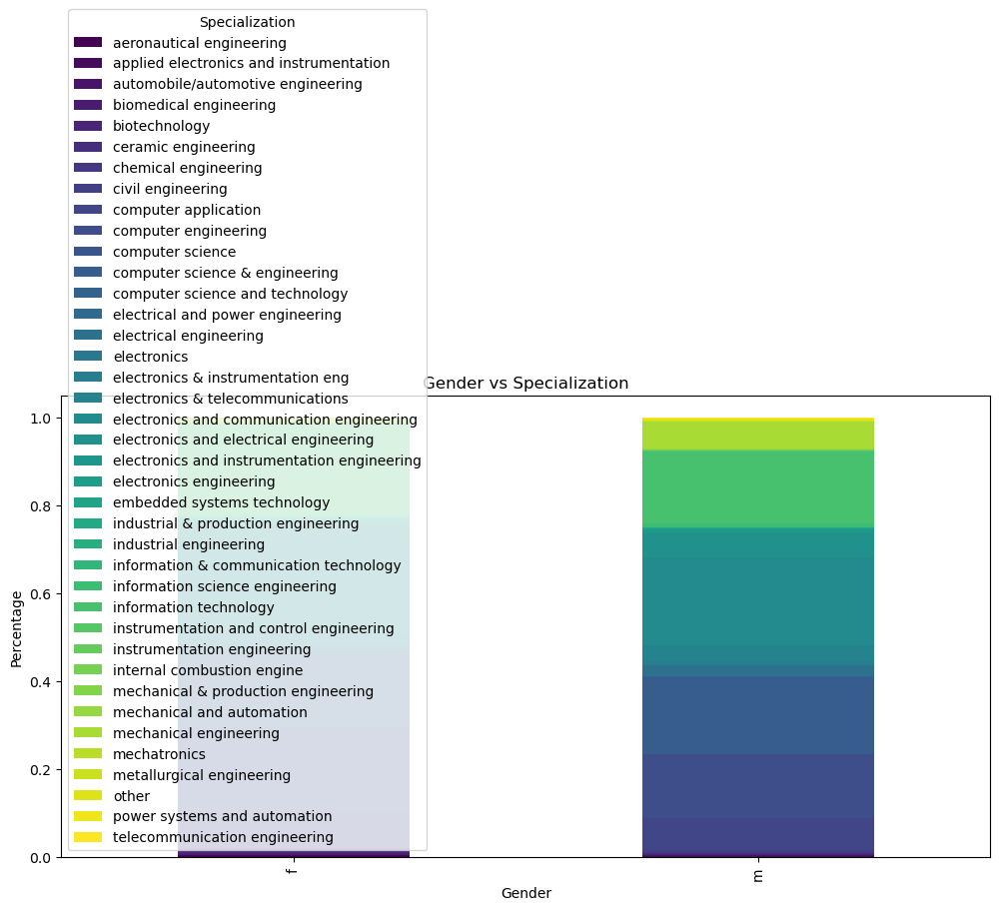

In [30]:
# Stacked bar plot for Gender vs Specialization
gender_specialization = pd.crosstab(df['Gender'], df['Specialization'])
gender_specialization.div(gender_specialization.sum(1).astype(float), axis=0).plot(kind="bar", stacked=True, colormap='viridis', figsize=(12, 6))
plt.title('Gender vs Specialization')
plt.xlabel('Gender')
plt.ylabel('Percentage')
plt.show()


List of Specializations:
1. aeronautical engineering
2. applied electronics and instrumentation
3. automobile/automotive engineering
4. biomedical engineering
5. biotechnology
6. ceramic engineering
7. chemical engineering
8. civil engineering
9. computer application
10. computer engineering
11. computer science
12. computer science & engineering
13. computer science and technology
14. electrical and power engineering
15. electrical engineering
16. electronics
17. electronics & instrumentation eng
18. electronics & telecommunications
19. electronics and communication engineering
20. electronics and electrical engineering
21. electronics and instrumentation engineering
22. electronics engineering
23. embedded systems technology
24. industrial & production engineering
25. industrial engineering
26. information & communication technology
27. information science engineering
28. information technology
29. instrumentation and control engineering
30. instrumentation engineering
31. internal c

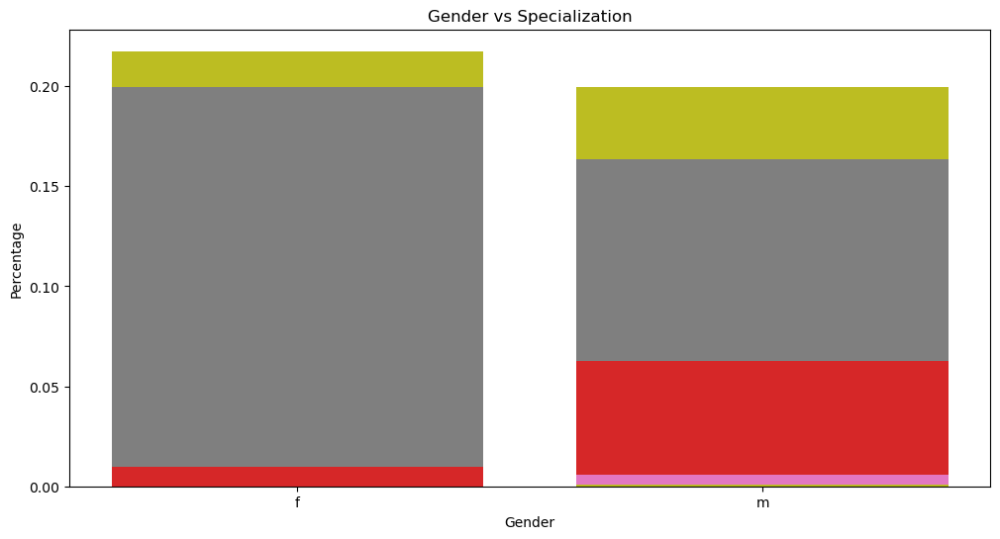

In [28]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming you have already loaded the dataset into 'df'

# Stacked bar plot for Gender vs Specialization
gender_specialization = pd.crosstab(df['Gender'], df['Specialization'])
normalized_gender_specialization = gender_specialization.div(gender_specialization.sum(1).astype(float), axis=0)

# Plotting the stacked bar plot
plt.figure(figsize=(12, 6))

# Printing the list of specializations separately
print("List of Specializations:")
for i, specialization in enumerate(normalized_gender_specialization.columns):
    print(f"{i + 1}. {specialization}")

    # Plotting each specialization
    plt.bar(normalized_gender_specialization.index, normalized_gender_specialization[specialization], label=specialization)

plt.title('Gender vs Specialization')
plt.xlabel('Gender')
plt.ylabel('Percentage')
plt.show()
